In [43]:
import __init__ # set up all the correct referenses
import os
import pandas as pd
import numpy as np
import scipy as sp
from matplotlib import pyplot as plt

import seaborn as sns

from sklearn.neighbors import NearestNeighbors, KDTree, kneighbors_graph
from sklearn.metrics import pairwise_distances
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler,PowerTransformer
import sklearn.preprocessing as preprocessing
from sklearn.manifold import TSNE

from sknetwork.clustering import Louvain, get_modularity

import datetime

import networkx as nx
import matplotlib.pyplot as plt
%matplotlib inline

from phenograph.cluster import cluster as cluster2



import __init__
from utils.propensity import Propensity
from utils.lifelines_preprocess import surv_functions
from utils.sequence_analysis import trajectory_seq_analysis

cmap = plt.get_cmap("tab20")

run_all = True

In [44]:


subproject_name = "trajectories"

wd = "../../../"
project_path = os.path.realpath(wd)
print(project_path)

raw_data_dir = project_path+"/raw_data/"
print(raw_data_dir)


data_dir = project_path+f"/{subproject_name}"+"/data/"
print(data_dir)

results_dir = project_path+f"/{subproject_name}"+"/output/"
print(results_dir)


/exports/reum/nsteinz/Project_trajectories
/exports/reum/nsteinz/Project_trajectories/raw_data/
/exports/reum/nsteinz/Project_trajectories/trajectories/data/
/exports/reum/nsteinz/Project_trajectories/trajectories/output/


In [45]:
features_nl = [#'Basophils',
    'Total Tender', 
            'Total Swollen',
           
            #'CRP Value (mg/L)', 
            #'DAS-28 CRP', 
            #'DAS28',
           'ESR Value',
    'WBC',        
    #'Eosinophils', 
            'hb_corrected', 
            #'Lymphocytes', 
            #'Monocytes',
       #'Neutrophils', 
            'PLT', 
            #'Rheum Factor positive', 
            
            
           
           ]

features = [#'Basophils',
            'TJC_28', 
            'SJC_28',
           
            #'CRP Value (mg/L)', 
            #'DAS-28 CRP', 
            #'DAS28',
           'ESR',
    'leukocytes',        
    #'Eosinophils', 
            'hemoglobin', 
            #'Lymphocytes', 
            #'Monocytes',
       #'Neutrophils', 
            'thrombocytes', 
            #'Rheum Factor positive', 
            
            
           ]

FA = 'Folic Acid'
predni = ['Methylprednisolone','Methylprednisolone Acetate', 'Prednisolone']
dmards = ['Adalimumab', 'Certolizumab', 'Dexamethasone',
       'Etanercept', 'Golimumab', 'Hydroxychloroquine',
       'Leflunomide', 'Methotrexate']+ predni + ['Sulfasalazine',
       'Tocilizumab', 'Triamcinolone (Kenalog)']
dmards = ['Adalimumab', 'Certolizumab', 'Dexamethasone',
       'Etanercept', 'Golimumab', 'Hydroxychloroquine',
       'Leflunomide', 'Methotrexate']+ ['Sulfasalazine',
       'Tocilizumab', 'Triamcinolone (Kenalog)']
dmard_types = {
    "TNF_b_dmards" : ['ETANERCEPT', 'GOLIMUMAB','INFLIXIMAB','CERTOLIZUMAB_PEGOL', 'ADALIMUMAB'],
    "IL6_b_dmards" : ['CERTOLIZUMAB_PEGOL', 'TOCILIZUMAB'],
    "IL1_b_dmards" : ['ANAKINRA'],
    "tcell_b_dmards" : ['ABATACEPT'],
    "cs_dmards" : ["METHOTREXATE",'HYDROXYCHLOROQUINE','LEFLUNOMIDE', 'SULFASALAZINE'],
    "jak_dmard" : ['TOFACITINIB', 'BARICITINIB'],
    "XO_damrd" : ['AZATHIOPRINE'],
    "OP_dmard" : ["CYCLOPHOSPHAMIDE"],
    "TC_dmard" : ["CICLOSPORINE"],
    "gld_dmard": ["SODIUM_AUROTHIOMALATE"]
    #"predni":  ['PREDNISOLONE',"METHYLPREDNISOLONE"],
}
set(dmards)- set([j for x in dmard_types for j in dmard_types[x]])

feature_remap = dict(zip(features_nl,features))

scaler =MinMaxScaler( feature_range=(0, 1))

In [46]:
import umap
reducer = umap.UMAP(n_neighbors=30, metric='cosine')


In [47]:
data_heatmap = pd.read_csv(data_dir+"tacera_cluster_data.csv",)
data_heatmap.columns
data_heatmap = data_heatmap.drop(columns='index', errors="ignore")


In [48]:
data_heatmap.columns

Index(['Subject ID', 'months', 'Study', 'Age', 'Race', 'Sex', 'Weight',
       'Date of Assessment', 'Date of symptom onset', 'Final Score',
       'Unnamed: 10', 'acpa', 'RF', 'ACPA positive SCR',
       'Rheum Factor positive SCR', 'Basophils', 'CRP Value (mg/L)',
       'DAS-28 CRP', 'DAS28', 'ESR', 'Eosinophils', 'GL', 'HB', 'Lymphocytes',
       'Monocytes', 'Neutrophils', 'thrombocytes', 'SJC_28', 'TJC_28',
       'leukocytes', 'Adalimumab', 'Certolizumab', 'Dexamethasone',
       'Etanercept', 'Folic Acid', 'Golimumab', 'Hydroxychloroquine',
       'Leflunomide', 'Methotrexate', 'Methylprednisolone',
       'Methylprednisolone Acetate', 'Prednisolone', 'Sulfasalazine',
       'Tocilizumab', 'Triamcinolone (Kenalog)', 'days', 'seropos',
       'Hemoglobulin', 'hemoglobin', 'das_28_c', 'visit_count', 'predni',
       'm_dmards', 'dmard_usage', 'remision', 'label', 'TJC_28_n', 'SJC_28_n',
       'ESR_n', 'leukocytes_n', 'hemoglobin_n', 'thrombocytes_n', 'das28_n',
       'das28', '

/tmp/ipykernel_757193/2095968557.py:16: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  size = df.groupby(target).apply(lambda x:len(x))


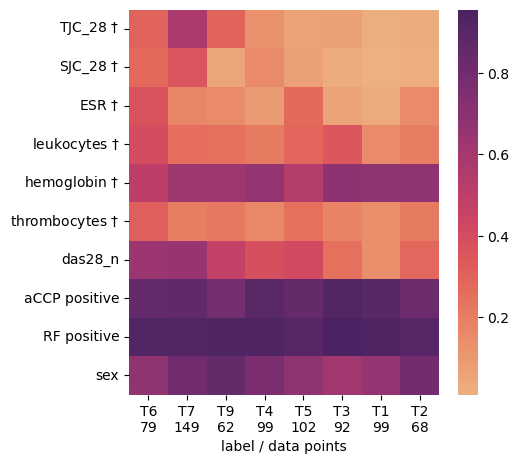

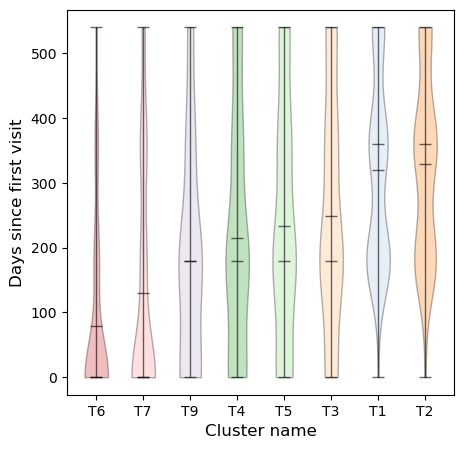

In [49]:
#plt.rcParams.update({'font.size': 10})
volgorde_kluer= [6,7,9,4,5,3,1,2]
cmap = plt.get_cmap("tab20")
def heatmap_plot(df:pd.DataFrame, target="label"):
    cmap = plt.get_cmap("tab20")
    add_features = ["das28_n","aCCP positive","RF positive", "sex", ]
    y_labels = [f"{x} $\dagger$" for x in features if x  ] + add_features
    volgorde_tijd = data_heatmap.groupby(target).days.mean().sort_values().index

    fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(5, 5))
    sns.heatmap(df.groupby(target)[
        [x for x in features_n ]+add_features].mean().transpose()[volgorde_tijd],
                cmap="flare", ax=axs,
                yticklabels = y_labels)
    
    size = df.groupby(target).apply(lambda x:len(x))
    axs.set_xticks(np.array(range(len(size)))+ 0.5)
    axs.set_xticklabels([f"T{i}\n{size.loc[int(i)]}"for i in volgorde_tijd])
    axs.set_xlabel(f"label / data points")
    plt.savefig(results_dir+"heatmap_tacera", dpi=900, transparent=True, bbox_inches='tight')
    fig.show()
    fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(5, 5))
    violin_parts  = axs.violinplot([df[df[target] == label].days for label in volgorde_tijd],
                      showmeans=True, showextrema=True, showmedians=True, )
    for partname in ('cbars','cmins','cmaxes','cmedians', "cmeans"):
            vp = violin_parts[partname]
            vp.set_edgecolor("black")
            vp.set_linewidth(1)
            vp.set_alpha(0.6) 
    for nr, pc in enumerate(violin_parts["bodies"]):
        pc.set_color(cmap(int(volgorde_kluer[nr])))
        pc.set_edgecolor("black")
    axs.set_xticks(range(1,len(volgorde_tijd)+1))
    axs.set_xticklabels([f"T{i}"for i in volgorde_tijd])
    axs.set_ylabel("Days since first visit", fontsize=12)
    axs.set_xlabel("Cluster name", fontsize=12)
    plt.savefig(results_dir+"\violin_tacera", dpi=900, transparent=True, bbox_inches='tight')
    fig.show()
    #plt.subplots_adjust( left=0.25), dpi=900, transparent=True, bbox_inches='tight')
features_n  = [f"{x}_n" for x in features]
heatmap_plot(data_heatmap)
#


In [50]:
trajectory = trajectory_seq_analysis(
        data_heatmap,
        label_col = "label",
        time_col = "days",
        pat_id = "PATNR",)  
seq_list, sim_array = trajectory.get_trajectories(k=100)

/exports/reum/nsteinz/Project_trajectories/trajectories/src/2_clustering/../utils/sequence_analysis.py:30: FutureWarning: The 'axis' keyword in DataFrameGroupBy.shift is deprecated and will be removed in a future version. Call without passing 'axis' instead.
  .shift(-1, axis=0, fill_value=-1)
/exports/reum/nsteinz/Project_trajectories/trajectories/src/2_clustering/../utils/sequence_analysis.py:46: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in 

Finding 100 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.009206533432006836 seconds
Jaccard graph constructed in 0.7255003452301025 seconds
Running Leiden optimization
Leiden completed in 0.06614971160888672 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 1.2791430950164795 seconds


In [51]:
import leidenalg
from phenograph.cluster import run_leiden 
import scipy as sp
df = pd.DataFrame(sim_array)
graph = sp.sparse.coo_matrix(df.abs())
directed: bool = False
partition_type = leidenalg.RBConfigurationVertexPartition
resolution_parameter: float = 1
n_iterations: int = -1
seed = 42
use_weights: bool = True,
kargs = {}
kargs["resolution_parameter"] = resolution_parameter
communities, Q = run_leiden(
            graph,
            directed,
            partition_type,
            resolution_parameter,
            n_iterations,
            seed,
            use_weights,
            kargs,
        )
communities

Running Leiden optimization
Leiden completed in 0.2596557140350342 seconds


array([3, 1, 3, 2, 2, 0, 1, 3, 4, 0, 4, 1, 3, 0, 0, 4, 1, 0, 1, 0, 2, 0,
       2, 0, 4, 0, 0, 4, 0, 2, 0, 2, 0, 0, 2, 4, 3, 3, 3, 4, 0, 4, 0, 2,
       4, 3, 2, 4, 0, 3, 2, 2, 2, 1, 4, 2, 1, 3, 1, 3, 2, 4, 2, 0, 0, 3,
       4, 4, 1, 1, 1, 3, 3, 1, 2, 0, 1, 1, 0, 4, 3, 0, 0, 4, 2, 1, 3, 2,
       0, 0, 2, 3, 2, 2, 4, 1, 3, 3, 0, 4, 4, 2, 3, 1, 0, 1, 1, 2, 3, 0,
       2, 0, 3, 2, 2, 4, 3, 1, 4, 1, 3, 0, 3, 0, 0, 0, 0, 2, 1, 3, 1, 4,
       0, 0, 1, 0, 2, 2, 0, 2, 3, 0, 2, 1, 0, 0, 0, 3, 1, 3, 2, 1, 4, 2,
       2, 1, 1, 1, 2, 3, 3, 1, 0, 1, 1, 1, 0, 4, 3, 2, 2, 4, 1, 1, 0, 1,
       1, 2, 4, 1, 0, 3, 1, 0, 1, 1, 3, 1, 0, 3, 0, 2, 2, 4, 2, 1, 1, 3,
       1, 0, 3, 2, 0, 1, 1, 0, 2, 1, 2, 0, 1, 3, 0, 4, 0, 3, 3, 3, 2, 0,
       3, 0, 2, 3, 4, 2, 2, 4, 2, 1, 3, 3, 2, 4, 1, 3, 1, 1, 0, 1, 4, 2,
       4])

In [52]:
traject_count = {}
for i in range(10,231,5):
    traject_count[i] = trajectory.get_labels(sim_array, k=i)
    print(traject_count[i])

Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.021126747131347656 seconds
Jaccard graph constructed in 0.43315863609313965 seconds
Running Leiden optimization
Leiden completed in 0.009246587753295898 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 0.9041974544525146 seconds
     traject_labels
0                10
1                 4
2                10
3                 7
4                 1
..              ...
238               3
239               5
240              13
241               1
242              12

[243 rows x 1 columns]
Finding 15 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.026131153106689453 seconds
Jaccard graph constructed in 0.46321702003479004 seconds
Running Leiden optimization
Leiden completed in 0.014729499816894531 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 0.938678503036499 seconds
     traject_labels
0        

In [53]:
k_len = {}
for i in traject_count:
    print(i)
    print(traject_count[i]["traject_labels"].unique().__len__())
    k_len[i] = traject_count[i]["traject_labels"].unique().__len__()
    seq_list[f"label_{i}"] = traject_count[i]
seq_list["communi"] = communities
k_len

10
14
15
9
20
8
25
6
30
5
35
5
40
5
45
5
50
5
55
5
60
5
65
5
70
5
75
5
80
5
85
5
90
5
95
5
100
5
105
4
110
4
115
4
120
3
125
3
130
4
135
3
140
4
145
3
150
3
155
3
160
3
165
3
170
3
175
3
180
3
185
3
190
3
195
3
200
2
205
3
210
2
215
3
220
2
225
2
230
2


{10: 14,
 15: 9,
 20: 8,
 25: 6,
 30: 5,
 35: 5,
 40: 5,
 45: 5,
 50: 5,
 55: 5,
 60: 5,
 65: 5,
 70: 5,
 75: 5,
 80: 5,
 85: 5,
 90: 5,
 95: 5,
 100: 5,
 105: 4,
 110: 4,
 115: 4,
 120: 3,
 125: 3,
 130: 4,
 135: 3,
 140: 4,
 145: 3,
 150: 3,
 155: 3,
 160: 3,
 165: 3,
 170: 3,
 175: 3,
 180: 3,
 185: 3,
 190: 3,
 195: 3,
 200: 2,
 205: 3,
 210: 2,
 215: 3,
 220: 2,
 225: 2,
 230: 2}

In [54]:
seq_list

,PATNR,label,traject_label,label_10,label_15,label_20,label_25,label_30,label_35,label_40,...,label_190,label_195,label_200,label_205,label_210,label_215,label_220,label_225,label_230,communi
0,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,"[7, 5]",2,10,5,2,3,4,5,5,...,2,2,2,2,2,2,2,2,2,3
1,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,"[7, 3, 7, 1]",1,4,6,7,2,3,3,3,...,1,1,1,1,1,1,1,1,1,1
2,016BBC0766785143D12B9EEE5B3B9DDA4C0C850D720120...,"[7, 5]",2,10,5,2,3,4,5,5,...,2,2,2,2,2,2,2,2,2,3
3,026A123E54047C669FA3C239D3D89ECC817437B0FE8CA1...,"[5, 4, 2]",5,7,1,1,1,2,2,2,...,2,2,2,2,2,2,2,2,2,2
4,036A2E585D2906AA2EE0114C9F34B066DCF0C9107F4AF0...,"[4, 2]",5,1,1,1,1,2,2,2,...,1,1,1,0,2,0,1,1,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
238,FB45097B8FF32D692D875052C7C54F0F39E7681ED4137E...,"[7, 4, 1, 1]",1,3,2,3,4,5,4,4,...,1,1,1,1,1,1,1,1,1,0
239,FCF14F3AAA87DE5EF1B23F0C26DC69BFEADC5A135BD06D...,"[6, 3]",3,5,3,4,2,3,3,3,...,0,0,1,1,1,1,1,1,1,1
240,FF18BE7F07D2B832CC6434ECF110D30F786D776F0A9E1F...,"[6, 7, 7]",4,13,4,5,6,1,1,1,...,2,2,2,2,2,2,2,2,1,4
241,FF316CBA26DD9BC1E0575F0930ECE7A0F15F9D2B3FED6C...,"[4, 2]",5,1,1,1,1,2,2,2,...,1,1,2,2,2,0,1,1,1,2


In [55]:
arand = pd.DataFrame(index=traject_count,columns=traject_count)

In [56]:
from itertools import combinations
from scipy.stats import fisher_exact, chisquare
from sklearn.metrics import rand_score, adjusted_rand_score
pd.DataFrame(index=traject_count,columns=traject_count)
for i,j in combinations(traject_count,2):
    print(i,j)
    contingency_table = pd.crosstab(seq_list[f"label_{i}"], seq_list[f"label_{j}"])
    #print(contingency_table)
    #print(chisquare(contingency_table).pvalue)
    #print(rand_score(seq_list[f"label_{i}"], seq_list[f"label_{j}"]))
    print(adjusted_rand_score(seq_list[f"label_{j}"], seq_list[f"label_{i}"]))
    arand.loc[i,j]=adjusted_rand_score(seq_list[f"label_{j}"], seq_list[f"label_{i}"])
    


10 15
0.6807200983267565
10 20
0.6220711082775653
10 25
0.5212507523282
10 30
0.4444064682479152
10 35
0.4484123429619075
10 40
0.4436652211539825
10 45
0.44081845497886
10 50
0.42612948076252855
10 55
0.4137620014255973
10 60
0.4135760720279563
10 65
0.40973138167804085
10 70
0.4167567211447058
10 75
0.4086561475026011
10 80
0.4359941394377831
10 85
0.3778547299358342
10 90
0.39328256597777383
10 95
0.38831340197578385
10 100
0.36811524266018797
10 105
0.28707452681390827
10 110
0.2880186147577329
10 115
0.2848834404678611
10 120
0.16819348388802963
10 125
0.1419320665418652
10 130
0.11124293441838713
10 135
0.09349245649317839
10 140
0.10963369554330678
10 145
0.10543556789257183
10 150
0.10543556789257183
10 155
0.10235374101048875
10 160
0.10543556789257183
10 165
0.10737724907767814
10 170
0.10543556789257183
10 175
0.10192486382860223
10 180
0.10400493132185888
10 185
0.09442413223070291
10 190
0.09477313470963848
10 195
0.09385387034923609
10 200
0.08796607946990058
10 205
0.092

In [57]:
np.fill_diagonal(arand.values, 0.5)
arand_test = arand.fillna(0) + arand.T.fillna(0)



/tmp/ipykernel_757193/2652305435.py:2: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  arand_test = arand.fillna(0) + arand.T.fillna(0)
/tmp/ipykernel_757193/2652305435.py:2: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  arand_test = arand.fillna(0) + arand.T.fillna(0)


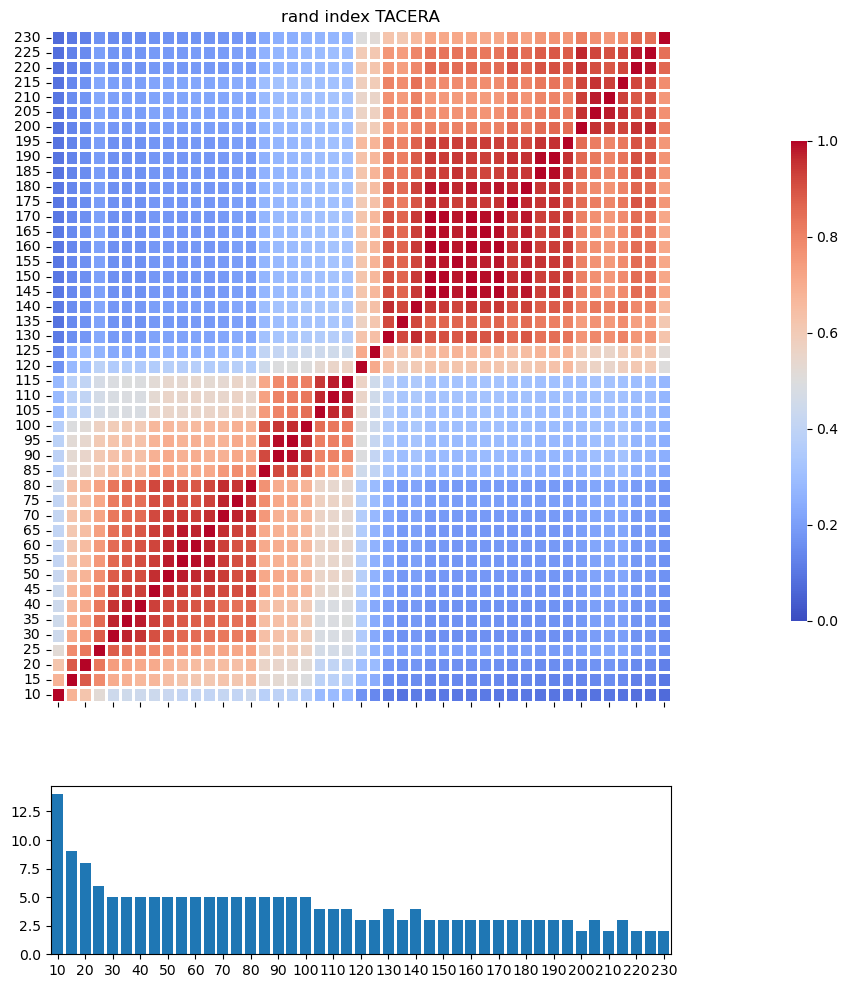

In [58]:
fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(8, 12), sharex='col',
                            gridspec_kw={'height_ratios': [16,4]}
                            )
cbar_ax = fig.add_axes([1.05, .388, .02, .4])
sns.heatmap(arand_test,
                cmap=('coolwarm'),
                vmin=0,
                vmax=1,
                linewidths=1,
                ax=axs[0],
            cbar_ax=cbar_ax,
               
               ).invert_yaxis()

x_ticks = list(k_len.keys())
x_tick_pos = [i + 0.5 for i in range(len(x_ticks))]
axs[1].bar(x_tick_pos, k_len.values(), align='center')
axs[0].set_title(f"rand index TACERA")
plt.show()

In [59]:
seq_list

,PATNR,label,traject_label,label_10,label_15,label_20,label_25,label_30,label_35,label_40,...,label_190,label_195,label_200,label_205,label_210,label_215,label_220,label_225,label_230,communi
0,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,"[7, 5]",2,10,5,2,3,4,5,5,...,2,2,2,2,2,2,2,2,2,3
1,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,"[7, 3, 7, 1]",1,4,6,7,2,3,3,3,...,1,1,1,1,1,1,1,1,1,1
2,016BBC0766785143D12B9EEE5B3B9DDA4C0C850D720120...,"[7, 5]",2,10,5,2,3,4,5,5,...,2,2,2,2,2,2,2,2,2,3
3,026A123E54047C669FA3C239D3D89ECC817437B0FE8CA1...,"[5, 4, 2]",5,7,1,1,1,2,2,2,...,2,2,2,2,2,2,2,2,2,2
4,036A2E585D2906AA2EE0114C9F34B066DCF0C9107F4AF0...,"[4, 2]",5,1,1,1,1,2,2,2,...,1,1,1,0,2,0,1,1,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
238,FB45097B8FF32D692D875052C7C54F0F39E7681ED4137E...,"[7, 4, 1, 1]",1,3,2,3,4,5,4,4,...,1,1,1,1,1,1,1,1,1,0
239,FCF14F3AAA87DE5EF1B23F0C26DC69BFEADC5A135BD06D...,"[6, 3]",3,5,3,4,2,3,3,3,...,0,0,1,1,1,1,1,1,1,1
240,FF18BE7F07D2B832CC6434ECF110D30F786D776F0A9E1F...,"[6, 7, 7]",4,13,4,5,6,1,1,1,...,2,2,2,2,2,2,2,2,1,4
241,FF316CBA26DD9BC1E0575F0930ECE7A0F15F9D2B3FED6C...,"[4, 2]",5,1,1,1,1,2,2,2,...,1,1,2,2,2,0,1,1,1,2


In [60]:
label_used = "label_"+ "90" # orignal 90
data_heatmap = data_heatmap.drop(columns=["communi_x", "communi_y"], errors="ignore")
data_heatmap = data_heatmap.drop(columns=["communi", "global_trajectory"], errors="ignore")

data_heatmap["global_trajectory"] = data_heatmap.merge(seq_list[["PATNR", label_used]], on="PATNR", )[label_used]
data_heatmap = data_heatmap.merge(seq_list[["PATNR", "communi"]], on="PATNR", )
data_heatmap["global_trajectory"] = data_heatmap["global_trajectory"].replace(dict(zip(range(1,25),"ABCDEFGHIJKLMNOPQRSTUVWXYZ")))
print(data_heatmap.global_trajectory.unique())

['B' 'A' 'E' 'D' 'C']


In [61]:
pd.crosstab(data_heatmap["communi"], data_heatmap["global_trajectory"])   

global_trajectory,A,B,C,D,E
communi,,,,,
0,167,0,0,19,0
1,19,0,152,0,0
2,15,30,0,0,118
3,2,127,0,8,0
4,0,0,0,93,0


In [62]:
#data_heatmap["global_trajectory"] = data_heatmap["global_trajectory"].replace({"A":"A_2","B":"B","C":"D","D":"D","E":"C","F":"A_1"})
matching = {"B":"A_1","A":"B","C":"C","D":"D","E":"A_2",}
data_heatmap["global_trajectory"] = data_heatmap["global_trajectory"].replace({"B":"A_1","A":"B","C":"C","D":"D","E":"A_2",})
#data_heatmap["global_trajectory"] = data_heatmap["global_trajectory"].replace({"A_1":"A","A_2":"A"})

In [63]:
data_heatmap.to_csv(data_dir+"Tacera_label_data.csv", index=False)


In [64]:
volgorde = pd.Index(sorted(data_heatmap.label.unique(), reverse=True))
print(volgorde)
volgorde_text = [f"T{x}" for x in volgorde]

Index([9, 7, 6, 5, 4, 3, 2, 1], dtype='int64')


In [65]:

import matplotlib as mpl
def edge_in_digraph(dataset, cutoff =0.15):
    G = nx.DiGraph()
    labels_set = [0 for i in range(len(dataset)**2)]
    #print(labels_set)
    for nr,i in enumerate(dataset.round(2).T.iterrows()):
        labels_set[nr] = f"{i[0]}"
        for j in i[1].items():
            if i[0]==j[0]:
                continue
            
            if j[1] <= 0:
                if -j[1] <= cutoff:
                    continue
            else:
                if j[1] <= cutoff:
                    continue
            #print(j[1])
            G.add_edge((i[0]),(j[0]),weight= j[1])
    return G, labels_set



from sklearn.cluster import KMeans
def define_scaling(scaling):
    kmeans  = KMeans(3).fit(scaling.values.reshape(-1, 1))
    print(kmeans.labels_)
    volgorede_dict = dict(zip(scaling.index,kmeans.labels_))
    print(volgorede_dict)
    lijst, lijst_fixed = {}, {}
    for i in volgorede_dict:
        lijst[volgorede_dict[i]] = lijst.get(volgorede_dict[i], []) + [i]
    for nr,i in enumerate(lijst):
        lijst_fixed[nr] = lijst[i]
        pass
    return lijst_fixed





def plot_traject(probs, scale,title="None", cutoff=1, size=None):
    if type(size) == type(None):
        size =800
    cmap = mpl.colormaps['Set1']
    fig, ax = plt.subplots(nrows=1, ncols=1)
    min_prob = cutoff
    B, labels= edge_in_digraph(probs,min_prob)
    scaling = define_scaling(scale)
    print(scaling)

    scale_nr = [i[x] for i in scaling.values() for x in range(len(i))]
    pos = {}
    for j in scaling:
        pos.update({n: (scale.loc[(n)], i +(1/len(scaling[j]))) for i, n in enumerate(scaling[j])})
    print(pos)
    options_edge = {
        "arrowsize":40,
        "node_size":800,
        "connectionstyle":"arc3, rad=0.15"
    }
    #print(np.array([W["weight"] for u,v,W in B.edges(data=True)]).reshape(-1,1))
    nx.draw_networkx_nodes(B, pos, nodelist=scale.index, node_color=cmap(scale.index), edgecolors="black", node_size=size)
    m_weights = (scaler.fit_transform(np.array([W["weight"] for u,v,W in B.edges(data=True)]).reshape(-1,1))+0.2)*5
    nx.draw_networkx_edges(B, pos, alpha=0.6, width=m_weights,  **options_edge)
    nx.draw_networkx_labels(B, pos, font_size=25)
    y = pd.DataFrame(pos).mean(axis=1)[0]-0.5
    x = pd.DataFrame(pos).mean(axis=1)[0] -0.1
    plt.arrow(x=x, dx=0.2, y=y-0.05, dy=0, width=0.05, color="black",head_length=0.1)
    plt.text(x+0.1, y-0.2, 'time', style ='italic',
            fontsize = 15, color ="Black")
    plt.tight_layout()
    plt.axis("off")
    ax.set_title(title, fontsize  =20)

    fig = mpl.pyplot.gcf()
    fig.set_figheight(5)
    fig.set_figwidth(7)
    plt.savefig(f'{results_dir}{title}.png', dpi=900, transparent=True, bbox_inches='tight')
    plt.show()

#plot_traject(data_heatmap, scaling.days,f"TACERA trajectory: {i} (n={nr_pt_traject})", size = size[volgorde]*50)


A_1
     9     7     6     5    4    3    2    1
9  1.0   1.0   0.0   5.0  0.0  1.0  0.0  0.0
7  0.0   2.0   1.0   1.0  0.0  0.0  0.0  0.0
6  0.0   1.0   1.0   2.0  0.0  1.0  0.0  0.0
5  4.0  13.0  14.0  33.0  1.0  1.0  4.0  0.0
4  0.0   0.0   1.0   2.0  0.0  0.0  0.0  0.0
3  0.0   0.0   0.0   0.0  0.0  0.0  0.0  0.0
2  2.0   1.0   2.0   8.0  0.0  0.0  1.0  0.0
1  0.0   0.0   0.0   0.0  0.0  0.0  0.0  0.0


/exports/reum/nsteinz/Project_trajectories/trajectories/src/2_clustering/../utils/propensity.py:33: FutureWarning: The 'axis' keyword in SeriesGroupBy.shift is deprecated and will be removed in a future version. Call without passing 'axis' instead.
  .shift(-1, axis=0, fill_value=-1)


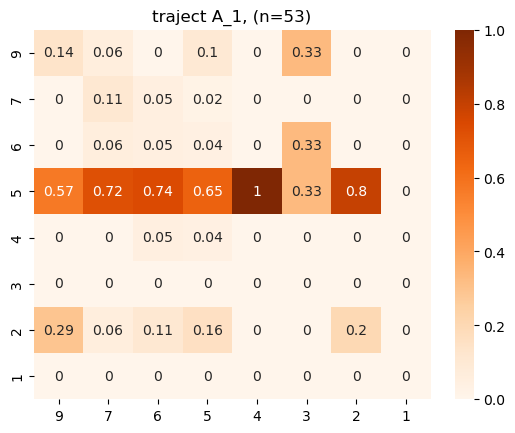

9    0.514286
7    0.142857
6    0.183673
5    0.584416
4    1.000000
3    0.000000
2    0.795918
1    0.000000
Name: days, dtype: float64
9     7.0
7    18.0
6    19.0
5    51.0
4     1.0
3     3.0
2     5.0
1     0.0
dtype: float64
[2 1 1 2 0 1 0 1]
{9: 2, 7: 1, 6: 1, 5: 2, 4: 0, 3: 1, 2: 0, 1: 1}
{0: [9, 5], 1: [7, 6, 3, 1], 2: [4, 2]}
{9: (0.5142857142857142, 0.5), 5: (0.5844155844155845, 1.5), 7: (0.14285714285714285, 0.25), 6: (0.18367346938775508, 1.25), 3: (0.0, 2.25), 1: (0.0, 3.25), 4: (1.0, 0.5), 2: (0.7959183673469388, 1.5)}


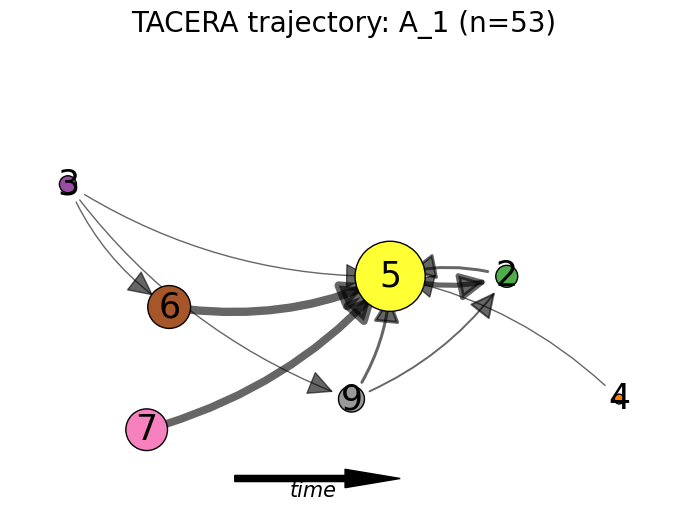

A_2
     9    7    6    5     4    3    2    1
9  1.0  4.0  0.0  0.0   0.0  0.0  5.0  0.0
7  1.0  1.0  0.0  1.0   0.0  0.0  0.0  0.0
6  0.0  1.0  0.0  0.0   0.0  0.0  0.0  0.0
5  0.0  1.0  0.0  0.0   2.0  0.0  0.0  0.0
4  0.0  2.0  2.0  1.0   3.0  0.0  2.0  0.0
3  1.0  0.0  1.0  0.0   0.0  0.0  1.0  0.0
2  6.0  8.0  5.0  3.0  12.0  1.0  9.0  2.0
1  0.0  0.0  0.0  0.0   0.0  1.0  4.0  0.0


/exports/reum/nsteinz/Project_trajectories/trajectories/src/2_clustering/../utils/propensity.py:33: FutureWarning: The 'axis' keyword in SeriesGroupBy.shift is deprecated and will be removed in a future version. Call without passing 'axis' instead.
  .shift(-1, axis=0, fill_value=-1)


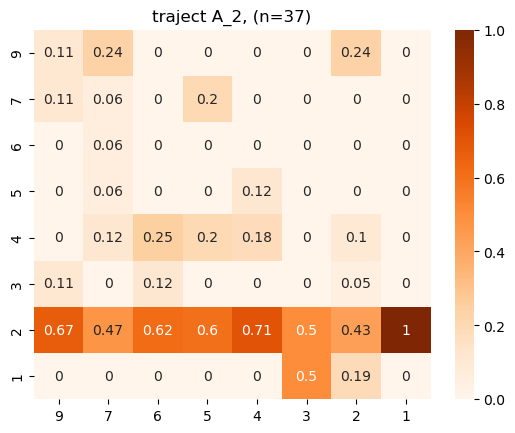

9    0.797933
7    0.100966
6    0.000000
5    0.522388
4    0.389718
3    0.970149
2    0.979676
1    1.000000
Name: days, dtype: float64
9     9.0
7    17.0
6     8.0
5     5.0
4    17.0
3     2.0
2    21.0
1     2.0
dtype: float64
[0 1 1 2 2 0 0 0]
{9: 0, 7: 1, 6: 1, 5: 2, 4: 2, 3: 0, 2: 0, 1: 0}
{0: [9, 3, 2, 1], 1: [7, 6], 2: [5, 4]}
{9: (0.7979334098737084, 0.25), 3: (0.9701492537313433, 1.25), 2: (0.979676087646872, 2.25), 1: (1.0, 3.25), 7: (0.10096575943810358, 0.5), 6: (0.0, 1.5), 5: (0.5223880597014925, 0.5), 4: (0.38971807628524047, 1.5)}


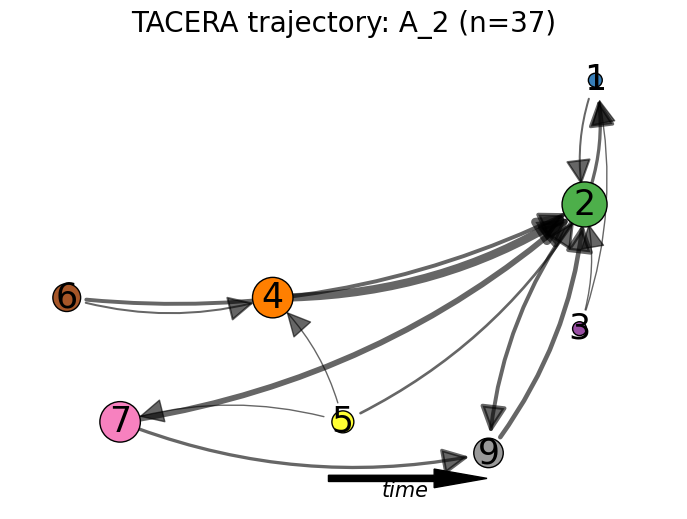

B
     9     7    6    5     4    3    2     1
9  0.0   2.0  0.0  0.0   0.0  1.0  0.0   0.0
7  1.0   4.0  0.0  0.0   5.0  1.0  0.0   1.0
6  0.0   0.0  0.0  0.0   0.0  0.0  0.0   0.0
5  0.0   0.0  0.0  0.0   0.0  0.0  0.0   0.0
4  3.0  16.0  0.0  0.0  12.0  0.0  0.0   8.0
3  0.0   2.0  0.0  0.0   0.0  0.0  0.0   2.0
2  0.0   1.0  0.0  0.0   2.0  0.0  0.0   3.0
1  7.0  12.0  5.0  1.0  20.0  2.0  3.0  27.0


/exports/reum/nsteinz/Project_trajectories/trajectories/src/2_clustering/../utils/propensity.py:33: FutureWarning: The 'axis' keyword in SeriesGroupBy.shift is deprecated and will be removed in a future version. Call without passing 'axis' instead.
  .shift(-1, axis=0, fill_value=-1)


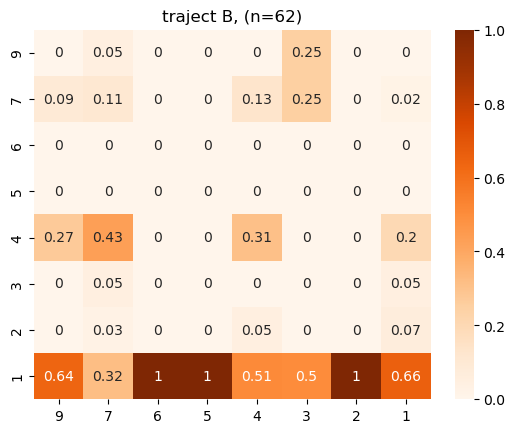

9    0.125874
7    0.252747
6    0.000000
5    0.000000
4    0.520280
3    0.646154
2    1.000000
1    0.852071
Name: days, dtype: float64
9    11.0
7    37.0
6     5.0
5     1.0
4    39.0
3     4.0
2     3.0
1    41.0
dtype: float64
[1 1 1 1 2 2 0 0]
{9: 1, 7: 1, 6: 1, 5: 1, 4: 2, 3: 2, 2: 0, 1: 0}
{0: [9, 7, 6, 5], 1: [4, 3], 2: [2, 1]}
{9: (0.1258741258741259, 0.25), 7: (0.25274725274725274, 1.25), 6: (0.0, 2.25), 5: (0.0, 3.25), 4: (0.5202797202797202, 0.5), 3: (0.6461538461538462, 1.5), 2: (1.0, 0.5), 1: (0.8520710059171598, 1.5)}


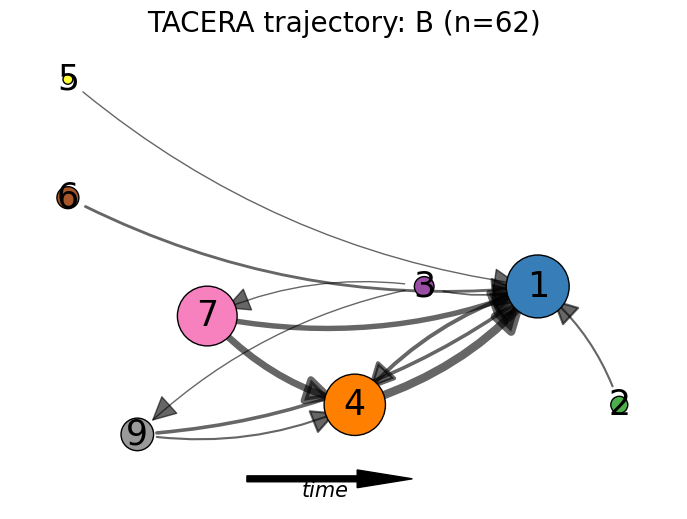

C
     9     7    6    5    4     3    2    1
9  2.0   0.0  0.0  0.0  0.0   0.0  0.0  1.0
7  1.0   2.0  1.0  0.0  0.0   3.0  0.0  0.0
6  0.0   0.0  0.0  0.0  0.0   0.0  0.0  0.0
5  0.0   1.0  0.0  0.0  0.0   0.0  0.0  0.0
4  0.0   2.0  1.0  0.0  3.0   4.0  0.0  0.0
3  3.0  10.0  8.0  4.0  7.0  26.0  1.0  7.0
2  0.0   0.0  0.0  0.0  0.0   1.0  0.0  0.0
1  1.0   1.0  1.0  1.0  0.0   9.0  0.0  1.0


/exports/reum/nsteinz/Project_trajectories/trajectories/src/2_clustering/../utils/propensity.py:33: FutureWarning: The 'axis' keyword in SeriesGroupBy.shift is deprecated and will be removed in a future version. Call without passing 'axis' instead.
  .shift(-1, axis=0, fill_value=-1)


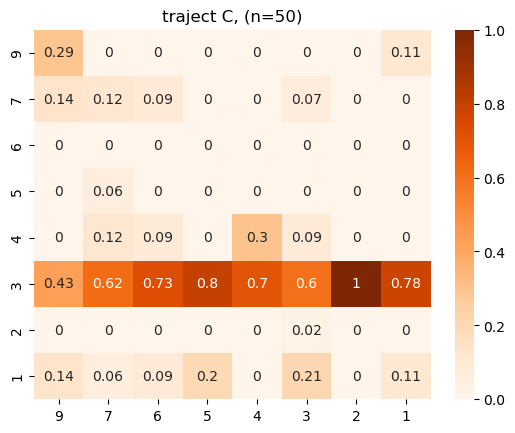

9    0.375000
7    0.388889
6    0.000000
5    0.100000
4    0.666667
3    0.706250
2    1.000000
1    0.714286
Name: days, dtype: float64
9     7.0
7    16.0
6    11.0
5     5.0
4    10.0
3    43.0
2     1.0
1     9.0
dtype: float64
[0 0 2 2 1 1 1 1]
{9: 0, 7: 0, 6: 2, 5: 2, 4: 1, 3: 1, 2: 1, 1: 1}
{0: [9, 7], 1: [6, 5], 2: [4, 3, 2, 1]}
{9: (0.375, 0.5), 7: (0.3888888888888889, 1.5), 6: (0.0, 0.5), 5: (0.1, 1.5), 4: (0.6666666666666666, 0.25), 3: (0.70625, 1.25), 2: (1.0, 2.25), 1: (0.7142857142857143, 3.25)}


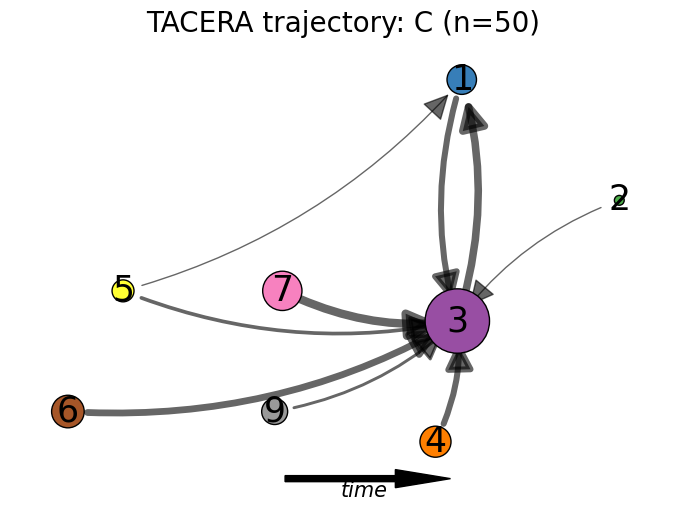

D
     9     7     6    5    4    3    2    1
9  3.0   7.0   5.0  1.0  0.0  0.0  0.0  0.0
7  3.0  26.0   4.0  0.0  1.0  0.0  0.0  0.0
6  2.0   3.0  12.0  0.0  0.0  0.0  0.0  0.0
5  0.0   0.0   0.0  0.0  0.0  0.0  0.0  2.0
4  2.0   1.0   3.0  0.0  2.0  0.0  0.0  0.0
3  0.0   0.0   0.0  0.0  0.0  0.0  0.0  0.0
2  0.0   0.0   0.0  0.0  0.0  0.0  0.0  0.0
1  2.0   0.0   0.0  0.0  0.0  0.0  0.0  0.0


/exports/reum/nsteinz/Project_trajectories/trajectories/src/2_clustering/../utils/propensity.py:33: FutureWarning: The 'axis' keyword in SeriesGroupBy.shift is deprecated and will be removed in a future version. Call without passing 'axis' instead.
  .shift(-1, axis=0, fill_value=-1)


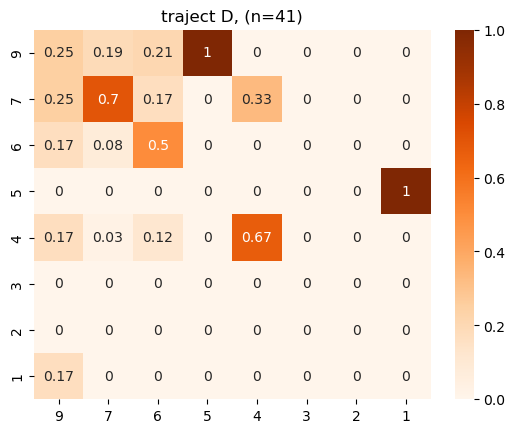

9    0.440000
7    0.437037
6    0.294118
5    1.000000
4    0.750000
3    0.000000
2    0.000000
1    0.600000
Name: days, dtype: float64
9    12.0
7    37.0
6    24.0
5     1.0
4     3.0
3     0.0
2     0.0
1     2.0
dtype: float64
[0 0 0 2 2 1 1 2]
{9: 0, 7: 0, 6: 0, 5: 2, 4: 2, 3: 1, 2: 1, 1: 2}
{0: [9, 7, 6], 1: [5, 4, 1], 2: [3, 2]}
{9: (0.44, 0.3333333333333333), 7: (0.437037037037037, 1.3333333333333333), 6: (0.2941176470588235, 2.3333333333333335), 5: (1.0, 0.3333333333333333), 4: (0.75, 1.3333333333333333), 1: (0.6, 2.3333333333333335), 3: (0.0, 0.5), 2: (0.0, 1.5)}


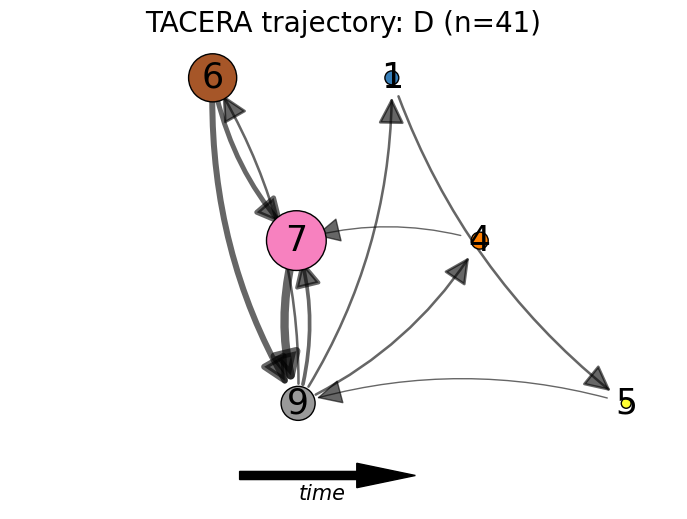

In [66]:
scaling_frame = pd.DataFrame(np.zeros(len(volgorde)), index = volgorde, columns=["days"] )
test_frame = pd.DataFrame(np.zeros((len(volgorde),len(volgorde))), columns=volgorde, index = volgorde )
for i in sorted(data_heatmap.global_trajectory.unique(), reverse=False):
    print(i)
    general_dataset = Propensity(data_heatmap.query(f"global_trajectory == '{i}'"),                    
                    time_column= "days",
                    label_column = "label",
                    patient_indetifier= "PATNR",
                    med_array=dmards,)
    general_dataset.calc_transition_matrix()
    #traject_counts = general_dataset.count_dict
    traject_counts = (general_dataset.count_dict + test_frame).fillna(0).loc[volgorde,volgorde]
    print(traject_counts)
    patients = len(data_heatmap.query(f"global_trajectory == '{i}'").PATNR.unique())
    traject_prob = (traject_counts/traject_counts.sum(axis=0)).round(2).fillna(0)
    ax = sns.heatmap(traject_prob.fillna(0), cmap='Oranges', annot=True)
    ax.set_title(f"traject {i}, (n={patients})")
    plt.show()
    traject_test = (traject_prob>0.15) * traject_counts*7.5
    nr_pt_traject = len(data_heatmap.query(f"global_trajectory == '{i}'").PATNR.unique())
    #print(traject_data.query("traject_label_y== @i"))
    scaling = (data_heatmap.query(f"global_trajectory == '{i}'").groupby("label").days.mean().to_frame() + scaling_frame).fillna(0).loc[volgorde]
    scaling = (scaling-scaling.min())/(scaling.max()-scaling.min())
    print(scaling.days)
    size = (traject_counts.sum(axis=0))
    print(size[volgorde])
    plot_traject(traject_test, scaling.days, f"TACERA trajectory: {i} (n={nr_pt_traject})", size = size[volgorde]*50)

0
     9     7    6    5     4    3    2     1
9  1.0   2.0  1.0  0.0   0.0  0.0  0.0   0.0
7  1.0   5.0  1.0  0.0   6.0  0.0  0.0   1.0
6  0.0   0.0  0.0  0.0   0.0  0.0  0.0   0.0
5  0.0   0.0  0.0  0.0   0.0  0.0  0.0   0.0
4  4.0  16.0  3.0  0.0  13.0  0.0  0.0   8.0
3  0.0   0.0  0.0  0.0   0.0  0.0  0.0   0.0
2  0.0   1.0  0.0  0.0   0.0  0.0  0.0   1.0
1  4.0  11.0  5.0  0.0  18.0  0.0  1.0  25.0


/exports/reum/nsteinz/Project_trajectories/trajectories/src/2_clustering/../utils/propensity.py:33: FutureWarning: The 'axis' keyword in SeriesGroupBy.shift is deprecated and will be removed in a future version. Call without passing 'axis' instead.
  .shift(-1, axis=0, fill_value=-1)


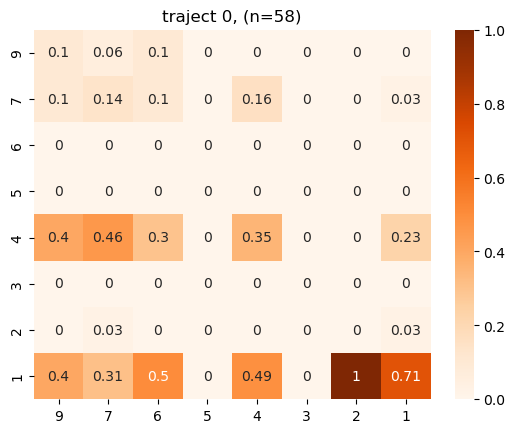

9    0.200000
7    0.329268
6    0.000000
5    0.000000
4    0.637931
3    0.000000
2    1.000000
1    0.900000
Name: days, dtype: float64
9    10.0
7    35.0
6    10.0
5     0.0
4    37.0
3     0.0
2     1.0
1    35.0
dtype: float64
[2 2 1 1 0 1 0 0]
{9: 2, 7: 2, 6: 1, 5: 1, 4: 0, 3: 1, 2: 0, 1: 0}
{0: [9, 7], 1: [6, 5, 3], 2: [4, 2, 1]}
{9: (0.2, 0.5), 7: (0.3292682926829268, 1.5), 6: (0.0, 0.3333333333333333), 5: (0.0, 1.3333333333333333), 3: (0.0, 2.3333333333333335), 4: (0.6379310344827587, 0.3333333333333333), 2: (1.0, 1.3333333333333333), 1: (0.9, 2.3333333333333335)}


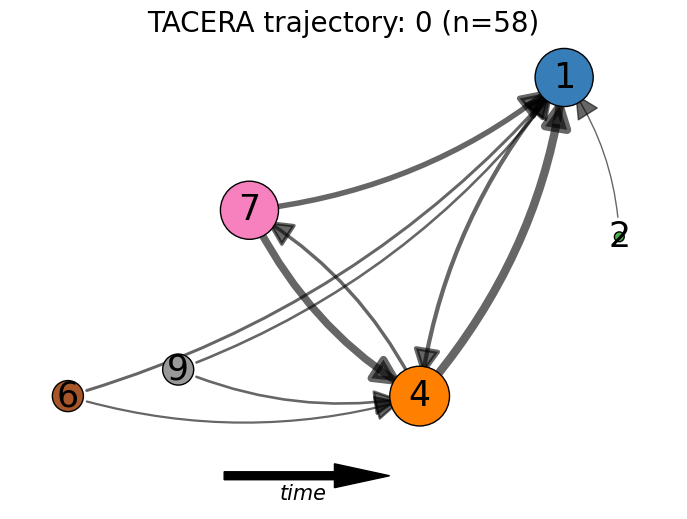

1
     9     7    6    5    4     3    2    1
9  2.0   0.0  0.0  0.0  0.0   1.0  0.0  1.0
7  1.0   2.0  1.0  0.0  0.0   4.0  0.0  0.0
6  0.0   0.0  0.0  0.0  0.0   0.0  0.0  0.0
5  0.0   1.0  0.0  0.0  0.0   0.0  0.0  0.0
4  0.0   2.0  1.0  0.0  3.0   4.0  0.0  0.0
3  3.0  12.0  8.0  4.0  7.0  26.0  1.0  9.0
2  0.0   0.0  0.0  0.0  0.0   1.0  0.0  0.0
1  4.0   2.0  1.0  1.0  0.0  11.0  0.0  3.0


/exports/reum/nsteinz/Project_trajectories/trajectories/src/2_clustering/../utils/propensity.py:33: FutureWarning: The 'axis' keyword in SeriesGroupBy.shift is deprecated and will be removed in a future version. Call without passing 'axis' instead.
  .shift(-1, axis=0, fill_value=-1)


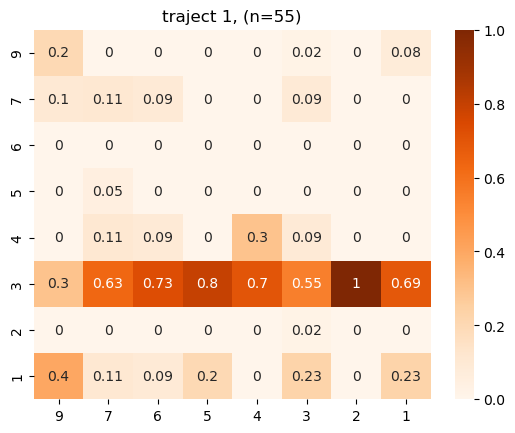

9    0.318182
7    0.380952
6    0.000000
5    0.100000
4    0.666667
3    0.705882
2    1.000000
1    0.840909
Name: days, dtype: float64
9    10.0
7    19.0
6    11.0
5     5.0
4    10.0
3    47.0
2     1.0
1    13.0
dtype: float64
[2 2 0 0 1 1 1 1]
{9: 2, 7: 2, 6: 0, 5: 0, 4: 1, 3: 1, 2: 1, 1: 1}
{0: [9, 7], 1: [6, 5], 2: [4, 3, 2, 1]}
{9: (0.3181818181818182, 0.5), 7: (0.38095238095238093, 1.5), 6: (0.0, 0.5), 5: (0.1, 1.5), 4: (0.6666666666666666, 0.25), 3: (0.7058823529411765, 1.25), 2: (1.0, 2.25), 1: (0.8409090909090909, 3.25)}


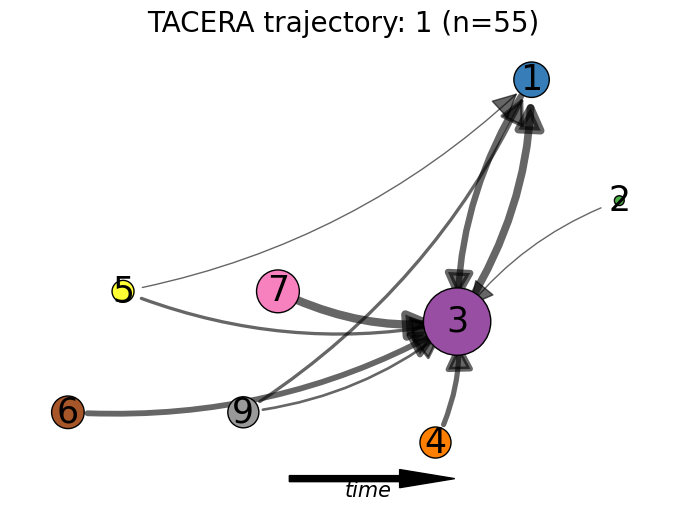

2
     9    7    6    5     4    3     2    1
9  1.0  4.0  0.0  2.0   0.0  0.0   5.0  0.0
7  1.0  1.0  0.0  1.0   0.0  0.0   0.0  0.0
6  0.0  1.0  0.0  0.0   0.0  0.0   0.0  0.0
5  1.0  2.0  2.0  1.0   2.0  0.0   2.0  0.0
4  1.0  3.0  2.0  1.0   4.0  0.0   2.0  0.0
3  1.0  0.0  1.0  0.0   0.0  0.0   1.0  0.0
2  8.0  9.0  6.0  9.0  14.0  1.0  10.0  4.0
1  0.0  0.0  0.0  0.0   2.0  1.0   6.0  0.0


/exports/reum/nsteinz/Project_trajectories/trajectories/src/2_clustering/../utils/propensity.py:33: FutureWarning: The 'axis' keyword in SeriesGroupBy.shift is deprecated and will be removed in a future version. Call without passing 'axis' instead.
  .shift(-1, axis=0, fill_value=-1)


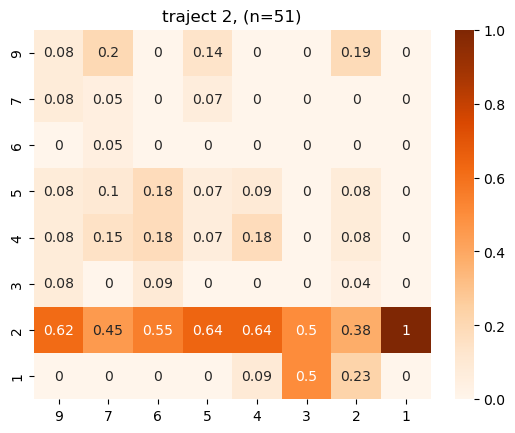

9    0.661064
7    0.083333
6    0.000000
5    0.507003
4    0.339545
3    0.869048
2    0.898618
1    1.000000
Name: days, dtype: float64
9    13.0
7    20.0
6    11.0
5    14.0
4    22.0
3     2.0
2    26.0
1     4.0
dtype: float64
[2 1 1 2 2 0 0 0]
{9: 2, 7: 1, 6: 1, 5: 2, 4: 2, 3: 0, 2: 0, 1: 0}
{0: [9, 5, 4], 1: [7, 6], 2: [3, 2, 1]}
{9: (0.6610644257703081, 0.3333333333333333), 5: (0.5070028011204482, 1.3333333333333333), 4: (0.33954451345755693, 2.3333333333333335), 7: (0.08333333333333334, 0.5), 6: (0.0, 1.5), 3: (0.8690476190476191, 0.3333333333333333), 2: (0.8986175115207374, 1.3333333333333333), 1: (1.0, 2.3333333333333335)}


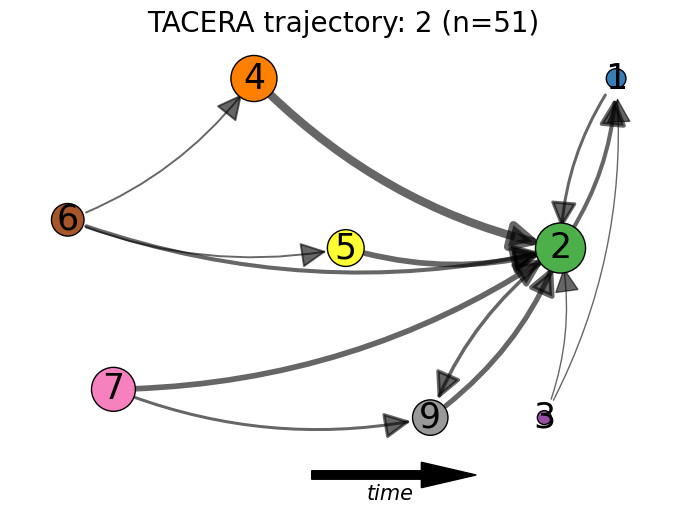

3
     9     7     6     5    4    3    2    1
9  2.0   1.0   0.0   4.0  0.0  1.0  0.0  0.0
7  0.0   2.0   1.0   1.0  0.0  0.0  0.0  0.0
6  0.0   1.0   1.0   2.0  0.0  1.0  0.0  0.0
5  3.0  12.0  12.0  32.0  1.0  1.0  2.0  2.0
4  0.0   0.0   1.0   2.0  0.0  0.0  0.0  0.0
3  0.0   0.0   0.0   0.0  0.0  0.0  0.0  0.0
2  0.0   0.0   1.0   2.0  0.0  0.0  0.0  0.0
1  2.0   0.0   0.0   1.0  0.0  0.0  0.0  0.0


/exports/reum/nsteinz/Project_trajectories/trajectories/src/2_clustering/../utils/propensity.py:33: FutureWarning: The 'axis' keyword in SeriesGroupBy.shift is deprecated and will be removed in a future version. Call without passing 'axis' instead.
  .shift(-1, axis=0, fill_value=-1)


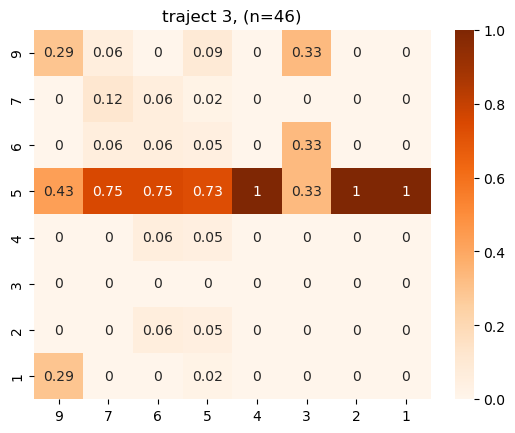

9    0.467532
7    0.160714
6    0.214286
5    0.605357
4    1.000000
3    0.000000
2    0.857143
1    0.571429
Name: days, dtype: float64
9     7.0
7    16.0
6    16.0
5    44.0
4     1.0
3     3.0
2     2.0
1     2.0
dtype: float64
[2 1 1 2 0 1 0 2]
{9: 2, 7: 1, 6: 1, 5: 2, 4: 0, 3: 1, 2: 0, 1: 2}
{0: [9, 5, 1], 1: [7, 6, 3], 2: [4, 2]}
{9: (0.4675324675324676, 0.3333333333333333), 5: (0.6053571428571428, 1.3333333333333333), 1: (0.5714285714285714, 2.3333333333333335), 7: (0.16071428571428573, 0.3333333333333333), 6: (0.21428571428571427, 1.3333333333333333), 3: (0.0, 2.3333333333333335), 4: (1.0, 0.5), 2: (0.8571428571428571, 1.5)}


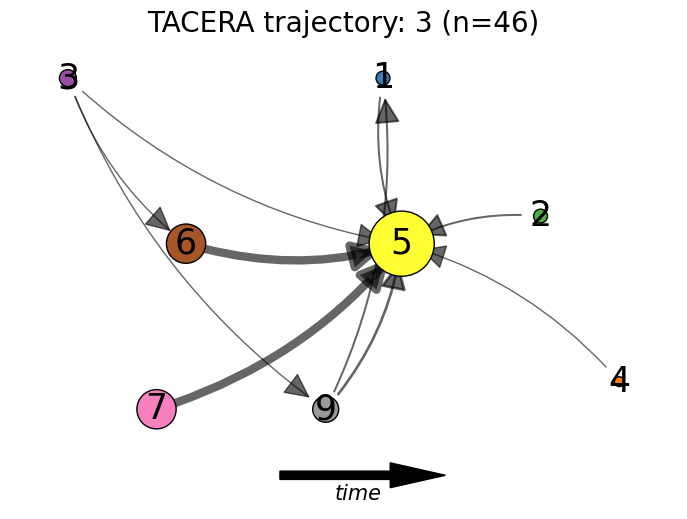

4
     9     7     6    5    4    3    2    1
9  1.0   7.0   4.0  0.0  0.0  0.0  0.0  0.0
7  3.0  25.0   3.0  0.0  0.0  0.0  0.0  0.0
6  2.0   3.0  12.0  0.0  0.0  0.0  0.0  0.0
5  0.0   0.0   0.0  0.0  0.0  0.0  0.0  0.0
4  0.0   0.0   0.0  0.0  0.0  0.0  0.0  0.0
3  0.0   0.0   0.0  0.0  0.0  0.0  0.0  0.0
2  0.0   0.0   0.0  0.0  0.0  0.0  0.0  0.0
1  0.0   0.0   0.0  0.0  0.0  0.0  0.0  0.0


/exports/reum/nsteinz/Project_trajectories/trajectories/src/2_clustering/../utils/propensity.py:33: FutureWarning: The 'axis' keyword in SeriesGroupBy.shift is deprecated and will be removed in a future version. Call without passing 'axis' instead.
  .shift(-1, axis=0, fill_value=-1)


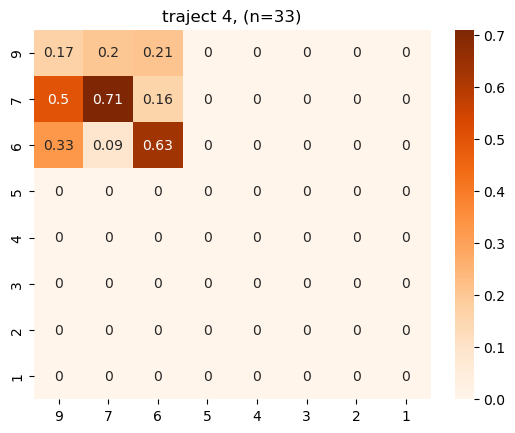

9    1.000000
7    0.844363
6    0.700431
5    0.000000
4    0.000000
3    0.000000
2    0.000000
1    0.000000
Name: days, dtype: float64
9     6.0
7    35.0
6    19.0
5     0.0
4     0.0
3     0.0
2     0.0
1     0.0
dtype: float64
[2 1 1 0 0 0 0 0]
{9: 2, 7: 1, 6: 1, 5: 0, 4: 0, 3: 0, 2: 0, 1: 0}
{0: [9], 1: [7, 6], 2: [5, 4, 3, 2, 1]}
{9: (1.0, 1.0), 7: (0.8443627450980392, 0.5), 6: (0.7004310344827587, 1.5), 5: (0.0, 0.2), 4: (0.0, 1.2), 3: (0.0, 2.2), 2: (0.0, 3.2), 1: (0.0, 4.2)}


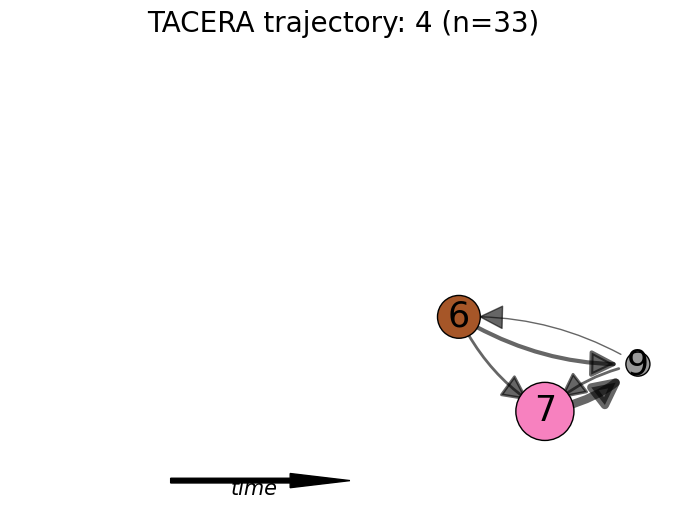

In [67]:
scaling_frame = pd.DataFrame(np.zeros(len(volgorde)), index = volgorde, columns=["days"] )
test_frame = pd.DataFrame(np.zeros((len(volgorde),len(volgorde))), columns=volgorde, index = volgorde )
for i in sorted(data_heatmap.communi.unique()):
    print(i)
    query = f"communi == {i}"
    general_dataset = Propensity(data_heatmap.query(query),                    
                    time_column= "days",
                    label_column = "label",
                    patient_indetifier= "PATNR",
                    med_array=dmards,)
    general_dataset.calc_transition_matrix()
    #traject_counts = general_dataset.count_dict
    traject_counts = (general_dataset.count_dict + test_frame).fillna(0).loc[volgorde,volgorde]
    print(traject_counts)
    patients = len(data_heatmap.query(query).PATNR.unique())
    traject_prob = (traject_counts/traject_counts.sum(axis=0)).round(2).fillna(0)
    ax = sns.heatmap(traject_prob.fillna(0), cmap='Oranges', annot=True)
    ax.set_title(f"traject {i}, (n={patients})")
    plt.show()
    traject_test = (traject_prob>0.15) * traject_counts*7.5
    nr_pt_traject = len(data_heatmap.query(query).PATNR.unique())
    #print(traject_data.query("traject_label_y== @i"))
    scaling = (data_heatmap.query(query).groupby("label").days.mean().to_frame() + scaling_frame).fillna(0).loc[volgorde]
    scaling = (scaling-scaling.min())/(scaling.max()-scaling.min())
    print(scaling.days)
    size = (traject_counts.sum(axis=0))
    print(size[volgorde])
    plot_traject(traject_test, scaling.days, f"TACERA trajectory: {i} (n={nr_pt_traject})", size = size[volgorde]*50)

In [68]:
data_heatmap.to_csv(data_dir+"tacera_trajectory_data.csv", index=False)

In [69]:
(data_heatmap.query(f"global_trajectory == '{i}'").groupby("label").days.mean().to_frame() + scaling_frame).fillna(0)

,days
1,0.0
2,0.0
3,0.0
4,0.0
5,0.0
6,0.0
7,0.0
9,0.0


In [70]:
features_o = [f"{x}_o" for x in features]
data_heatmap.columns

Index(['Subject ID', 'months', 'Study', 'Age', 'Race', 'Sex', 'Weight',
       'Date of Assessment', 'Date of symptom onset', 'Final Score',
       'Unnamed: 10', 'acpa', 'RF', 'ACPA positive SCR',
       'Rheum Factor positive SCR', 'Basophils', 'CRP Value (mg/L)',
       'DAS-28 CRP', 'DAS28', 'ESR', 'Eosinophils', 'GL', 'HB', 'Lymphocytes',
       'Monocytes', 'Neutrophils', 'thrombocytes', 'SJC_28', 'TJC_28',
       'leukocytes', 'Adalimumab', 'Certolizumab', 'Dexamethasone',
       'Etanercept', 'Folic Acid', 'Golimumab', 'Hydroxychloroquine',
       'Leflunomide', 'Methotrexate', 'Methylprednisolone',
       'Methylprednisolone Acetate', 'Prednisolone', 'Sulfasalazine',
       'Tocilizumab', 'Triamcinolone (Kenalog)', 'days', 'seropos',
       'Hemoglobulin', 'hemoglobin', 'das_28_c', 'visit_count', 'predni',
       'm_dmards', 'dmard_usage', 'remision', 'label', 'TJC_28_n', 'SJC_28_n',
       'ESR_n', 'leukocytes_n', 'hemoglobin_n', 'thrombocytes_n', 'das28_n',
       'das28', '

In [71]:
data_heatmap["das28_o"] =(0.56*np.sqrt(data_heatmap.TJC_28) + 0.28* np.sqrt( data_heatmap.SJC_28) + 0.70*np.log(data_heatmap.ESR))*1.08 + 0.16
data_heatmap["das28_o"]
data_heatmap["Remission"] = data_heatmap.das28_o <2.6
data_heatmap["seropos"] = False
data_heatmap.loc[data_heatmap.query("`aCCP positive`==True or `RF positive`==True").index, "seropos"] = True
data_heatmap.das28 

0      7.42
1      2.01
2      5.33
3      2.63
4      4.64
       ... 
745    1.99
746    5.36
747    5.96
748    7.01
749    5.27
Name: das28, Length: 750, dtype: float64

In [72]:

def print_latex_table_EHR(dataset, 
                          groupby="Subject ID",
                          query = "label==@j" , 
                          type_ = "trajectory", 
                          volgorde= None,
                         features_median = [],
                          features_mean= [],
                          features_add = ["dmard_usage","RF", "acpa", "Sex"]
                         ):
    if query == None:
        query = 'ilevel_0 in ilevel_0'
    print("Features", end ="")
    for i in volgorde:
        print(" & ", end="")
        print(type_, end="")
    print("\\\\\\hline")

    for j in volgorde:

        z = (dataset.query(query)
                        .groupby(groupby)
                        )
        print(f"n= &{z.head(1).count().iloc[1]}&")
        visits = z.count().iloc[:,1]
        print(f"nr of visits (IQR)& {visits.median()} ({float(round(visits.quantile(q=0.25),1))} - {float(round(visits.quantile(q=0.75),1))})&", end="")
    print("\\\\")
    for i in features_median:
        print(i,"$\space$ (IQR) $\space\dagger$ ", end= "")
        for j in volgorde:
            print(" & ", end="")
            z = (dataset.query(query)
                        .groupby(groupby)
                        .head(1)[i])
            print(f"{float(round(z.median(),1))} ({float(round(z.quantile(q=0.25),1))} - {float(round(z.quantile(q=0.75),1))})", end="")
        print("\\\\")
    for i in features_mean:
        print(i,"$\space$ (±IQR) $\space\dagger$ ", end= "")
        for j in volgorde:
            print(" & ", end="")
            z = (dataset.query(query)
                        .groupby(groupby)
                        .head(1)[i])
            print(f"{float(round(z.mean(),2))} ({float(round(z.std(),2))})", end="")
        print("\\\\")
    for i in features_add:
        print(i,"(\\%)", end= "")
        for j in volgorde:
            print(" & ", end="")
            z = (dataset.query(query)
                        .groupby(groupby)
                        .head(1)[i])
            print(f"{int(round(z.sum(),0))} ({round(z.mean()*100, 1)})", end="")

        print("\\\\")



In [73]:
matching.values()

dict_values(['A_1', 'B', 'C', 'D', 'A_2'])

In [74]:
for i in  matching.values():
    print("nr of visits: {} {:.0f} ({:.0f} - {:.0f})".format(i,*data_heatmap.query(f"global_trajectory ==  @i").groupby("PATNR").count().TJC_28.describe()[["50%","25%", "75%"]]) )
    data = data_heatmap.query(f"global_trajectory ==  @i").sort_values("days").groupby("PATNR").head(1)
    print_latex_table_EHR(data, groupby="PATNR", query=None, type_="", volgorde =[5], features_median= features, features_mean= ["das28", "das28_o","Age"], features_add = ["RF positive", "aCCP positive", "seropos","sex", "Remission"])
#data = data_heatmap.query(f"global_trajectory ==  @i").sort_values("days").groupby("PATNR").head(1)
#print("nr of visits: {:.0f} ({:.0f} - {:.0f})".format(*data_heatmap.query(f"global_trajectory ==  @i").groupby("PATNR").count().TJC_28.describe()[["50%","25%", "75%"]]) )
#print_latex_table_EHR(data, groupby="PATNR", query=None, type_="", volgorde =[5], features_median= features, features_mean= ["das28", "das28_o","Age"], features_add = ["RF positive", "aCCP positive", "seropos","sex", "Remission"])

nr of visits: A_1 3 (2 - 4)
Features & \\\hline
n= &53&
nr of visits (IQR)& 1.0 (1.0 - 1.0)&\\
TJC_28 $\space$ (IQR) $\space\dagger$  & 7.0 (3.0 - 13.0)\\
SJC_28 $\space$ (IQR) $\space\dagger$  & 6.0 (3.0 - 10.0)\\
ESR $\space$ (IQR) $\space\dagger$  & 40.0 (27.0 - 52.0)\\
leukocytes $\space$ (IQR) $\space\dagger$  & 8.4 (6.9 - 9.8)\\
hemoglobin $\space$ (IQR) $\space\dagger$  & 8.0 (7.4 - 8.6)\\
thrombocytes $\space$ (IQR) $\space\dagger$  & 357.0 (279.0 - 421.0)\\
das28 $\space$ (±IQR) $\space\dagger$  & 5.39 (1.24)\\
das28_o $\space$ (±IQR) $\space\dagger$  & 5.2 (1.12)\\
Age $\space$ (±IQR) $\space\dagger$  & 60.23 (12.4)\\
RF positive (\%) & 47 (88.7)\\
aCCP positive (\%) & 43 (81.1)\\
seropos (\%) & 53 (100.0)\\
sex (\%) & 36 (67.9)\\
Remission (\%) & 0 (0.0)\\
nr of visits: B 4 (3 - 4)
Features & \\\hline
n= &62&
nr of visits (IQR)& 1.0 (1.0 - 1.0)&\\
TJC_28 $\space$ (IQR) $\space\dagger$  & 9.0 (5.2 - 14.0)\\
SJC_28 $\space$ (IQR) $\space\dagger$  & 6.0 (4.0 - 9.8)\\
ESR $\spac

In [75]:
data = data_heatmap.sort_values("days").groupby("PATNR").tail(1)
print_latex_table_EHR(data, groupby="PATNR", query=None, type_="", volgorde =[5], features_median= features, features_mean= ["das28", "das28_o","Age"], features_add = ["RF positive", "aCCP positive", "seropos","sex", "Remission"])


for i in  matching.values():
    print("nr of visits: {} {:.0f} ({:.0f} - {:.0f})".format(i,*data_heatmap.query(f"global_trajectory ==  @i").groupby("PATNR").count().TJC_28.describe()[["50%","25%", "75%"]]) )
    data = data_heatmap.query(f"global_trajectory ==  @i").sort_values("days").groupby("PATNR").tail(1)
    print_latex_table_EHR(data, groupby="PATNR", query=None, type_="", volgorde =[5], features_median= features, features_mean= ["das28", "das28_o","Age"], features_add = ["RF positive", "aCCP positive", "seropos","sex", "Remission"])


Features & \\\hline
n= &243&
nr of visits (IQR)& 1.0 (1.0 - 1.0)&\\
TJC_28 $\space$ (IQR) $\space\dagger$  & 2.0 (0.0 - 5.0)\\
SJC_28 $\space$ (IQR) $\space\dagger$  & 1.0 (0.0 - 3.0)\\
ESR $\space$ (IQR) $\space\dagger$  & 12.0 (6.0 - 24.0)\\
leukocytes $\space$ (IQR) $\space\dagger$  & 6.3 (5.1 - 7.8)\\
hemoglobin $\space$ (IQR) $\space\dagger$  & 8.5 (8.0 - 8.9)\\
thrombocytes $\space$ (IQR) $\space\dagger$  & 266.5 (225.5 - 312.0)\\
das28 $\space$ (±IQR) $\space\dagger$  & 3.06 (1.48)\\
das28_o $\space$ (±IQR) $\space\dagger$  & 3.05 (1.35)\\
Age $\space$ (±IQR) $\space\dagger$  & 52.95 (14.92)\\
RF positive (\%) & 223 (91.8)\\
aCCP positive (\%) & 208 (85.6)\\
seropos (\%) & 243 (100.0)\\
sex (\%) & 177 (72.8)\\
Remission (\%) & 93 (38.3)\\
nr of visits: A_1 3 (2 - 4)
Features & \\\hline
n= &53&
nr of visits (IQR)& 1.0 (1.0 - 1.0)&\\
TJC_28 $\space$ (IQR) $\space\dagger$  & 1.0 (0.0 - 3.0)\\
SJC_28 $\space$ (IQR) $\space\dagger$  & 1.0 (0.0 - 2.0)\\
ESR $\space$ (IQR) $\space\dagg

In [76]:
 data_heatmap.query(f"global_trajectory == @i").query("label == 1").sort_values("days").groupby("PATNR").head(1).days.describe()

count      5.000000
mean     324.000000
std      150.598805
min      180.000000
25%      180.000000
50%      360.000000
75%      360.000000
max      540.000000
Name: days, dtype: float64

In [77]:
 data_heatmap.query(f"global_trajectory == @i").sort_values("days").groupby("PATNR").tail(1).days.describe()

count     37.000000
mean     398.918919
std      153.763595
min      180.000000
25%      180.000000
50%      360.000000
75%      540.000000
max      540.000000
Name: days, dtype: float64

In [78]:
 data_heatmap.query(f"global_trajectory == @i").sort_values("days").groupby("PATNR").head(1).Age.describe()

count    37.000000
mean     53.405405
std      13.770862
min      26.000000
25%      44.000000
50%      55.000000
75%      63.000000
max      81.000000
Name: Age, dtype: float64

In [79]:
 data_heatmap.query(f"global_trajectory == @i").sort_values("days").groupby("PATNR").tail(1).das28_o .describe()

count    37.000000
mean      2.926492
std       0.986631
min       0.684019
25%       2.562609
50%       2.865009
75%       3.540218
max       5.065690
Name: das28_o, dtype: float64

In [80]:
 "das28 ESR (3) {:.2f} ({:.2f})".format(*data_heatmap.query(f"global_trajectory == @i").sort_values("days").groupby("PATNR").tail(1).das28_o.describe().loc[["mean","std"]])

'das28 ESR (3) 2.93 (0.99)'

In [81]:
 "ESR: {:.2f} ({:.2f} - {:.2f})".format(*data_heatmap.query(f"global_trajectory == @i").sort_values("days").groupby("PATNR").tail(1).ESR.describe().loc[["50%","25%", "75%"]])

'ESR: 21.00 (10.00 - 24.00)'

In [82]:
for i in  matching.values():
    print(i, "predni",data_heatmap.query(f"global_trajectory == @i").groupby("PATNR").max()["predni"].mean()*100 )
print("all predni",data_heatmap.groupby("PATNR").max()["predni"].mean()*100 )    

A_1 predni 39.62264150943396
B predni 32.25806451612903
C predni 26.0
D predni 46.34146341463415
A_2 predni 35.13513513513514
all predni 35.390946502057616


In [83]:
for i in  matching.values():
    #print(i, "MTX",data_heatmap.query(f"global_trajectory == @i").groupby("PATNR").max()["Methotrexate"].mean()*100 )
    print(i)
    print(data_heatmap.query(f"global_trajectory ==  @i").sort_values("days").groupby("PATNR").max()[["predni"]+dmards].describe().loc[["mean"]]*100)
    

A_1
         predni  Adalimumab  Certolizumab  Dexamethasone  Etanercept  \
mean  39.622642         0.0           0.0       1.886792    3.773585   

      Golimumab  Hydroxychloroquine  Leflunomide  Methotrexate  Sulfasalazine  \
mean        0.0           67.924528     1.886792     94.339623      16.981132   

      Tocilizumab  Triamcinolone (Kenalog)  
mean          0.0                11.320755  
B
         predni  Adalimumab  Certolizumab  Dexamethasone  Etanercept  \
mean  32.258065         0.0      1.612903       1.612903    3.225806   

      Golimumab  Hydroxychloroquine  Leflunomide  Methotrexate  Sulfasalazine  \
mean   1.612903           74.193548     3.225806     96.774194      19.354839   

      Tocilizumab  Triamcinolone (Kenalog)  
mean          0.0                 8.064516  
C
      predni  Adalimumab  Certolizumab  Dexamethasone  Etanercept  Golimumab  \
mean    26.0         0.0           0.0            0.0         2.0        2.0   

      Hydroxychloroquine  Leflunomi

for i in  matching.values():
    #print(i, "MTX",data_heatmap.query(f"global_trajectory == @i").groupby("PATNR").max()["Methotrexate"].mean()*100 )
    print(i)
    print(data_heatmap.query(f"global_trajectory ==  @i").sort_values("days").groupby("PATNR").mean()[features].describe().loc[["mean"]])
    

In [85]:
data_heatmap.query(f"global_trajectory == @i").groupby("PATNR").max()["Remission"].mean()*100

28.30188679245283

In [87]:
data_heatmap.query(f"global_trajectory ==  @i").sort_values("days").groupby("PATNR").head(1)[["days", "predni"]+dmards].describe().loc[["mean"]]*100

,days,predni,Adalimumab,Certolizumab,Dexamethasone,Etanercept,Golimumab,Hydroxychloroquine,Leflunomide,Methotrexate,Sulfasalazine,Tocilizumab,Triamcinolone (Kenalog)
mean,0.0,5.660377,0.0,0.0,0.0,0.0,0.0,50.943396,0.0,75.471698,1.886792,0.0,0.0


In [88]:
for i in  matching.values():
    print(i, "predni",data_heatmap.query(f"global_trajectory ==  @i").sort_values("days").groupby("PATNR").head(1)[["days", "predni"]+dmards].describe().loc[["mean"]]*100)
    

A_1 predni       days    predni  Adalimumab  Certolizumab  Dexamethasone  Etanercept  \
mean   0.0  5.660377         0.0           0.0            0.0         0.0   

      Golimumab  Hydroxychloroquine  Leflunomide  Methotrexate  Sulfasalazine  \
mean        0.0           50.943396          0.0     75.471698       1.886792   

      Tocilizumab  Triamcinolone (Kenalog)  
mean          0.0                      0.0  
B predni       days    predni  Adalimumab  Certolizumab  Dexamethasone  Etanercept  \
mean   0.0  6.451613         0.0           0.0            0.0         0.0   

      Golimumab  Hydroxychloroquine  Leflunomide  Methotrexate  Sulfasalazine  \
mean        0.0           61.290323          0.0     83.870968      11.290323   

      Tocilizumab  Triamcinolone (Kenalog)  
mean          0.0                      0.0  
C predni       days  predni  Adalimumab  Certolizumab  Dexamethasone  Etanercept  \
mean   0.0     0.0         0.0           0.0            0.0         0.0   

    

In [89]:
data_heatmap.query(f"global_trajectory ==  @i").sort_values("days").groupby("PATNR").head(1)[dmards].max(axis=1).mean()*100

86.48648648648648

In [90]:
data_heatmap.query(f"global_trajectory ==  @i").sort_values("days").groupby("PATNR").tail(1)[["days", "predni"]+dmards].describe().loc[["mean"]]*100

,days,predni,Adalimumab,Certolizumab,Dexamethasone,Etanercept,Golimumab,Hydroxychloroquine,Leflunomide,Methotrexate,Sulfasalazine,Tocilizumab,Triamcinolone (Kenalog)
mean,39891.891892,13.513514,0.0,0.0,0.0,0.0,0.0,56.756757,5.405405,86.486486,8.108108,0.0,0.0


In [91]:

data = data_heatmap.sort_values("days").groupby("Subject ID").head(1).reset_index()
print_latex_table_EHR(data, groupby="PATNR", query=None, type_="", volgorde =[5], features_median= features, features_mean= ["das28", "das28_o","Age"], features_add = ["RF positive", "aCCP positive", "seropos","sex", "Remission"])

Features & \\\hline
n= &243&
nr of visits (IQR)& 1.0 (1.0 - 1.0)&\\
TJC_28 $\space$ (IQR) $\space\dagger$  & 9.0 (4.0 - 14.0)\\
SJC_28 $\space$ (IQR) $\space\dagger$  & 6.0 (3.0 - 9.5)\\
ESR $\space$ (IQR) $\space\dagger$  & 27.0 (12.0 - 42.5)\\
leukocytes $\space$ (IQR) $\space\dagger$  & 7.8 (6.6 - 9.2)\\
hemoglobin $\space$ (IQR) $\space\dagger$  & 8.5 (7.9 - 8.9)\\
thrombocytes $\space$ (IQR) $\space\dagger$  & 293.0 (255.0 - 365.0)\\
das28 $\space$ (±IQR) $\space\dagger$  & 5.18 (1.37)\\
das28_o $\space$ (±IQR) $\space\dagger$  & 4.95 (1.29)\\
Age $\space$ (±IQR) $\space\dagger$  & 52.95 (14.92)\\
RF positive (\%) & 223 (91.8)\\
aCCP positive (\%) & 208 (85.6)\\
seropos (\%) & 243 (100.0)\\
sex (\%) & 177 (72.8)\\
Remission (\%) & 10 (4.1)\\


In [92]:

data = data_heatmap.sort_values("days").groupby("Subject ID").tail(1).reset_index()
print_latex_table_EHR(data, groupby="PATNR", query=None, type_="", volgorde =[5], features_median= features, features_mean= ["das28", "das28_o","Age"], features_add = ["RF positive", "aCCP positive", "seropos","sex", "Remission"])

Features & \\\hline
n= &243&
nr of visits (IQR)& 1.0 (1.0 - 1.0)&\\
TJC_28 $\space$ (IQR) $\space\dagger$  & 2.0 (0.0 - 5.0)\\
SJC_28 $\space$ (IQR) $\space\dagger$  & 1.0 (0.0 - 3.0)\\
ESR $\space$ (IQR) $\space\dagger$  & 12.0 (6.0 - 24.0)\\
leukocytes $\space$ (IQR) $\space\dagger$  & 6.3 (5.1 - 7.8)\\
hemoglobin $\space$ (IQR) $\space\dagger$  & 8.5 (8.0 - 8.9)\\
thrombocytes $\space$ (IQR) $\space\dagger$  & 266.5 (225.5 - 312.0)\\
das28 $\space$ (±IQR) $\space\dagger$  & 3.06 (1.48)\\
das28_o $\space$ (±IQR) $\space\dagger$  & 3.05 (1.35)\\
Age $\space$ (±IQR) $\space\dagger$  & 52.95 (14.92)\\
RF positive (\%) & 223 (91.8)\\
aCCP positive (\%) & 208 (85.6)\\
seropos (\%) & 243 (100.0)\\
sex (\%) & 177 (72.8)\\
Remission (\%) & 93 (38.3)\\


In [93]:
data_heatmap.sort_values("days").groupby("PATNR").head(1)[["days"]+dmards].describe()

,days,Adalimumab,Certolizumab,Dexamethasone,Etanercept,Golimumab,Hydroxychloroquine,Leflunomide,Methotrexate,Sulfasalazine,Tocilizumab,Triamcinolone (Kenalog)
count,243.0,243.0,243.0,243.0,243.0,243.0,243.000000,243.0,243.000000,243.000000,243.0,243.0
mean,0.0,0.0,0.0,0.0,0.0,0.0,0.547325,0.0,0.757202,0.069959,0.0,0.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.498783,0.0,0.429659,0.255604,0.0,0.0
min,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0
25%,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,1.000000,0.000000,0.0,0.0
50%,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,1.000000,0.000000,0.0,0.0
75%,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,1.000000,0.000000,0.0,0.0
max,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,1.000000,1.000000,0.0,0.0


In [94]:

for med in dmards:
    try:
        general_dataset.calc_propencetie(med)
        general_dataset.calc_significants(med)
        general_dataset.visualize_prop(med)
    except SyntaxError:
        continue
    except ValueError: 
        continue
    except IndexError:
        continue

index 8 is out of bounds for axis 0 with size 3
9 9
   9  7  6
9  0  0  0
7  0  1  0
6  0  0  0
index 8 is out of bounds for axis 0 with size 3
9 9
   9  7  6
9  0  0  0
7  0  0  0
6  0  0  0
index 8 is out of bounds for axis 0 with size 3
9 9
   9  7  6
9  0  0  0
7  0  0  0
6  0  0  0
index 8 is out of bounds for axis 0 with size 3
9 9
   9  7  6
9  0  0  0
7  0  0  0
6  0  0  0
index 8 is out of bounds for axis 0 with size 3
9 9
   9  7  6
9  0  0  0
7  0  0  0
6  0  0  0
index 8 is out of bounds for axis 0 with size 3
9 9
   9   7  6
9  0   6  2
7  3  12  1
6  2   1  7
index 8 is out of bounds for axis 0 with size 3
9 9
   9  7  6
9  0  0  0
7  0  0  0
6  0  0  0
index 8 is out of bounds for axis 0 with size 3
9 9
   9   7  6
9  1   5  4
7  2  18  2
6  1   2  9
index 8 is out of bounds for axis 0 with size 3
9 9
   9  7  6
9  1  0  0
7  0  4  0
6  0  2  1
index 8 is out of bounds for axis 0 with size 3
9 9
   9  7  6
9  0  0  0
7  0  0  0
6  0  0  0
index 8 is out of bounds for axi

In [95]:
import matplotlib as mpl

(0.0, 550.0)

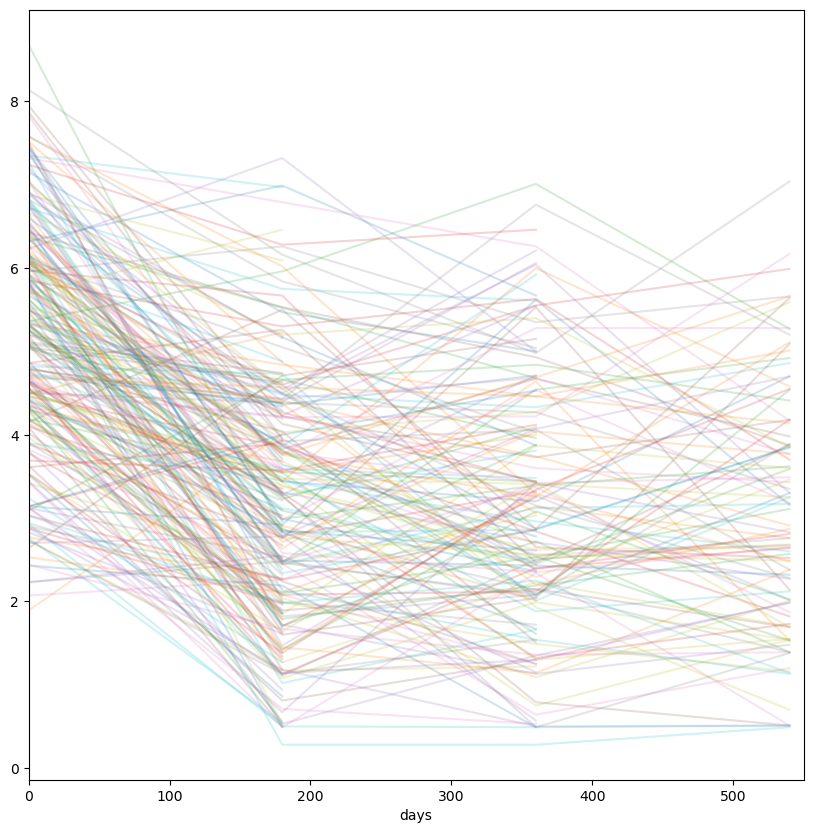

In [96]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 10))
data_heatmap.sort_values(["PATNR","days"]).groupby(["PATNR"]).plot(x="days", y="das28", ax=ax, alpha=0.2, legend=False)
plt.xlim((0,550))

In [97]:
x = data_heatmap.sort_values("DATUM").groupby("PATNR").head(1)[["PATNR", 'label']].rename(columns={"label":"start_label"})
y = data_heatmap.sort_values("DATUM").groupby("PATNR").tail(1)[["PATNR", 'label']].rename(columns={"label":"eind_label"})
data_cluster_plot = data_heatmap.merge(x, on="PATNR", how="left")
data_cluster_plot = data_cluster_plot.merge(y, on="PATNR", how="left")
data_cluster_plot.start_label = data_cluster_plot.start_label
data_cluster_plot.eind_label = data_cluster_plot.eind_label

In [98]:
from matplotlib.lines import Line2D

colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow",8:"teal",9:"pink",10:"lightgreen"}
def plot_clusters(dataset_clusters,
                  var, 
                  querys, 
                  range_ = None, 
                  target="label", 
                  axes = None, 
                  verbose= False, 
                  time_var = "days", 
                  reg_plot=True, 
                  *args, 
                  **kwargs):
    alpha = kwargs.get("alpha", 0.04)
    cmap = mpl.colormaps['tab20']
    if kwargs.get("cmap",False):
        cmap = kwargs["cmap"]
    if kwargs.get("mapper",False):
        traject_unmapper = kwargs["mapper"]
    
    if range_ is None:
        range_ = sorted(dataset_clusters[target].unique())
    if axes:
        ax=axes
        fig = None
    else:
        fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 10))
    handles, labels = ax.get_legend_handles_labels()
    patient_count = {}
    for i in range_:        
        dataset = dataset_clusters.query(querys).sort_values(['PATNR',time_var])
        patient_count[i] = len(dataset.PATNR.unique())
        if verbose:
            print(i, len(dataset.PATNR.unique()), len(dataset.PATNR.unique())/len(dataset_clusters.PATNR.unique()))
        for ids,data in dataset.groupby("PATNR"):
            data.plot(
            x=time_var,
            y=var,
            color=cmap(traject_unmapper.get(i, i)),
            alpha=alpha,
            ax=ax,
            label = i,
            legend=False,
                linewidth=2,)
        if reg_plot:
            plt_it=sns.regplot(
                ax=ax,
                data = dataset,
                x=time_var,
                y=var,
                ci=80,
                label = f"{i} (n={len(dataset.PATNR.unique())})",
                color=cmap(traject_unmapper.get(i, i)),
                lowess=True,
                scatter=False,
                line_kws={'linewidth':5})
    def make_proxy(zvalue, cmapping, **kwargs):
        color = cmapping(traject_unmapper.get(zvalue, zvalue))
        return Line2D([0, 1], [0, 1], color=color, alpha=1, **kwargs)
    proxies = [make_proxy(item, cmap, linewidth=5, label="test") for item in range_]
    legend_label = [ f"{item} (n={patient_count[item]})" for item in range_]
    print(legend_label)
    ax.legend(proxies, legend_label, fontsize=20)
    #print(proxies)
    return fig, ax, handles
#dataset_clusters.query(querys)

In [99]:
data_cluster_plot.label
data_cluster_plot["eind_label"] = data_cluster_plot.eind_label.astype(str)
data_cluster_plot["start_label"] = data_cluster_plot.start_label.astype(str)

['A_1 (n=53)', 'A_2 (n=37)', 'B (n=62)', 'C (n=50)', 'D (n=41)']


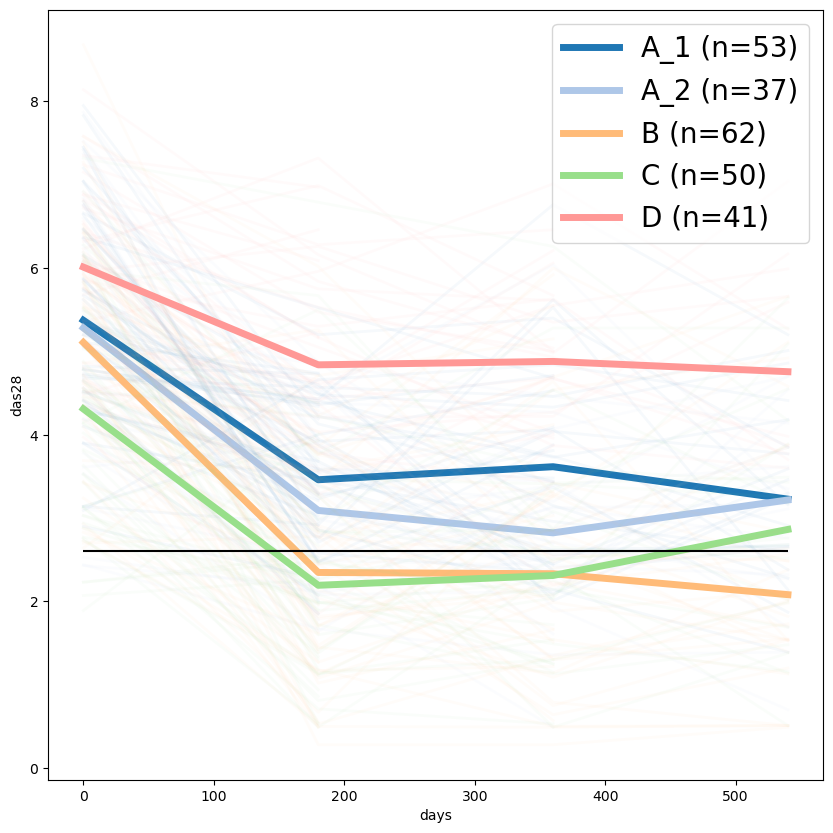

In [100]:
#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
traject_unmapper = {#"A":0,
                    "A_2":1,"A_1":0,
                    "B":3,"C":5,"D":7,6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']

plot_clusters(data_heatmap, "das28", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
#plt.title("eind_label used") 

#plt.xlim((0,550))
plt.hlines(2.6, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

In [101]:
#traject_unmapper[data_cluster_plot.global_trajectory.unique()]
data_cluster_plot.global_trajectory.unique()

array(['A_1', 'B', 'A_2', 'D', 'C'], dtype=object)

In [102]:
data_cluster_plot.das28

0      7.42
1      2.01
2      5.33
3      2.63
4      4.64
       ... 
745    1.99
746    5.36
747    5.96
748    7.01
749    5.27
Name: das28, Length: 750, dtype: float64

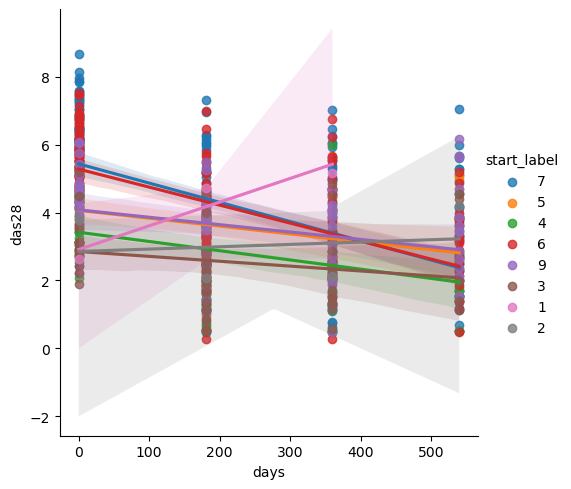

In [103]:

ax = sns.lmplot(data=data_cluster_plot, x="days", y="das28", hue="start_label",ci=99)
plt.show()

In [104]:
import random
def edge_in_digraph(dataset, cutoff =0.15):
    G = nx.DiGraph()
    labels_Set = {}
    for i in dataset.round(2).T.iterrows():
        #print(int((i[0][1]).strip("T")))
        labels_Set[i[0]] = f"{i[0]}"
        for j in i[1].items():
            if i[0]==j[0]:
                continue
            
            if j[1] <= 0:
                if -j[1] <= cutoff:
                    continue
            else:
                if j[1] <= cutoff:
                    continue
            #print(j[1])
            G.add_edge(int(i[0]),int(j[0]),weight= j[1])
    return G

scale = data_heatmap.groupby("label").days.median().loc[volgorde]
scale = (scale-scale.min())/(scale.max()-scale.min())
B = edge_in_digraph(general_dataset.traject_props, 0.0)

In [105]:
scale.index = scale.index

In [106]:
data_use = pd.read_csv(data_dir +f"TACERA_data_2024-03-18.csv")
#data_use = pd.read_csv(data_dir +f"TACERA_data_.csv")
#PATNRS = pd.read_csv(data_dir +"TACERA_data_old.csv").query("Study == 'TACERA'")
print(data_use.query("HB<20").HB)

data_use = data_use.reset_index(drop=True)
#data_use = PATNRS
data_use.columns
data_use['Subject ID'].unique().__len__()
data_use
data_use.columns

63      12.5
65      11.6
126     12.1
128     11.2
130      9.9
        ... 
1561    13.4
1577    14.0
1589    10.9
1591     9.4
1624    14.6
Name: HB, Length: 87, dtype: float64


Index(['Subject ID', 'months', 'Study', 'Age', 'Race', 'Sex', 'Weight',
       'Date of Assessment', 'Date of symptom onset', 'Final Score', 'RF',
       'acpa', 'acpa_value', 'rf_value', 'ACPA Value', 'Basophils',
       'CRP Value (mg/L)', 'DAS-28 CRP', 'DAS28', 'DAS28 relative',
       'ESR Value', 'Eosinophils', 'Evaluator global', 'Fatique', 'GL', 'Gdl',
       'HB', 'Lymphocytes', 'Metrologist's score', 'Monocytes', 'Neutrophils',
       'Outside 2 week window', 'PLT', 'Pain score', 'Patient global',
       'RF Unit', 'RF Value', 'SDAI <= 3.3', 'SDAI score',
       'Total 66/68 Swollen Joints', 'Total 66/68 Tender Joints',
       'Total Swollen', 'Total Tender', 'Use of sign '<'', 'WBC', 'Adalimumab',
       'Certolizumab', 'Dexamethasone', 'Etanercept', 'Folic Acid',
       'Golimumab', 'Hydroxychloroquine', 'Leflunomide', 'Methotrexate',
       'Methylprednisolone', 'Methylprednisolone Acetate', 'Prednisolone',
       'Sulfasalazine', 'Tocilizumab', 'Triamcinolone (Kenalog)', '

In [107]:
data_clin = pd.read_excel(raw_data_dir +f"TACERA_raw/RA_MAP_Clinical_Figshare_17_5_21.xlsx")
data_clin.columns

Index(['Patient_ID', 'Digest', 'Region', 'Hub', 'REGION_HUB', 'Study',
       'IM.STEROIDS.3MONTHS', 'ACPA.POSITIVE', 'RHUEMATOID.FACTOR', 'DAS28.0M',
       'DAS28.3M', 'DAS28.6M', 'DAS28.9M', 'DAS28.12M', 'DAS28.18M',
       'Remission month', 'Remission(<2.6DAS)', 'HighDisease(>4DAS)',
       'Symp_Duration', 'HAQ.0M', 'HAQ.6M', 'SDAI.0M', 'SDAI.6M', 'SDAI.12M',
       'BASOPHILS.0M', 'EOSINOPHILS.0M', 'HB.0M', 'LYMPHOCYTES.0M',
       'MONOCYTES.0M', 'NEUTROPHILS.0M', 'PLT.0M', 'WBC.0M', 'CRP.0M',
       'ESR.0M', 'FATIQUE.0M', 'PAIN.0M', 'TOTAL.SWOLLEN.0M',
       'TOTAL.TENDER.0M', 'BASOPHILS.6M', 'EOSINOPHILS.6M', 'HB.6M',
       'LYMPHOCYTES.6M', 'MONOCYTES.6M', 'NEUTROPHILS.6M', 'PLT.6M', 'WBC.6M',
       'CRP.6M', 'FATIQUE.6M', 'PAIN.6M', 'TOTAL.SWOLLEN.6M',
       'TOTAL.TENDER.6M', 'CRP.9M', 'TOTAL.SWOLLEN.9M', 'TOTAL.TENDER.9M',
       'ORAL.STEROIDS.3M', 'AGE', 'RACE', 'GENDER', 'HEIGHT', 'WEIGHT',
       'ALCOHOL_Y_N', 'CURENT SMOKER', 'InitialxRAYScore', 'FinalxRAYScore

In [108]:
data_clin["Symp_Duration"]= pd.to_numeric(data_clin["Symp_Duration"], errors='coerce' )
data_heatmap= data_heatmap.merge(data_clin[["Digest","Symp_Duration"]].dropna(axis=0), left_on="PATNR", right_on="Digest")

In [109]:
data_heatmap.groupby("PATNR").head(1).groupby("global_trajectory").Symp_Duration.describe()

,count,mean,std,min,25%,50%,75%,max
global_trajectory,,,,,,,,
A_1,53.0,134.075472,74.416667,21.0,84.00,119.0,159.00,363.0
A_2,37.0,143.027027,64.724410,35.0,93.00,138.0,182.00,286.0
B,62.0,155.693548,86.834228,7.0,91.75,145.5,199.00,358.0
C,50.0,160.500000,77.028023,45.0,93.25,152.5,218.25,354.0
D,41.0,173.341463,96.938282,29.0,83.00,173.0,259.00,348.0


In [110]:
data_heatmap.groupby("PATNR").head(1).Symp_Duration.describe()

count    243.000000
mean     153.016461
std       81.520517
min        7.000000
25%       87.500000
50%      137.000000
75%      198.000000
max      363.000000
Name: Symp_Duration, dtype: float64

In [111]:
#data_heatmap.merge(data_heatmap.groupby("PATNR").count(), on = ).groupby("PATNR").head(1)#.groupby("global_trajectory").Symp_Duration.describe()

In [112]:
data_trajectories = data.groupby("Subject ID").head()[["Subject ID","global_trajectory"]]
data.columns

Index(['index', 'Subject ID', 'months', 'Study', 'Age', 'Race', 'Sex',
       'Weight', 'Date of Assessment', 'Date of symptom onset', 'Final Score',
       'Unnamed: 10', 'acpa', 'RF', 'ACPA positive SCR',
       'Rheum Factor positive SCR', 'Basophils', 'CRP Value (mg/L)',
       'DAS-28 CRP', 'DAS28', 'ESR', 'Eosinophils', 'GL', 'HB', 'Lymphocytes',
       'Monocytes', 'Neutrophils', 'thrombocytes', 'SJC_28', 'TJC_28',
       'leukocytes', 'Adalimumab', 'Certolizumab', 'Dexamethasone',
       'Etanercept', 'Folic Acid', 'Golimumab', 'Hydroxychloroquine',
       'Leflunomide', 'Methotrexate', 'Methylprednisolone',
       'Methylprednisolone Acetate', 'Prednisolone', 'Sulfasalazine',
       'Tocilizumab', 'Triamcinolone (Kenalog)', 'days', 'seropos',
       'Hemoglobulin', 'hemoglobin', 'das_28_c', 'visit_count', 'predni',
       'm_dmards', 'dmard_usage', 'remision', 'label', 'TJC_28_n', 'SJC_28_n',
       'ESR_n', 'leukocytes_n', 'hemoglobin_n', 'thrombocytes_n', 'das28_n',
       '

In [113]:
data_use = data_use.merge(data_trajectories, on= "Subject ID")


In [114]:
data_use = data_use.rename(columns={"Subject ID":"PATNR"})

data_use['Date of Assessment']= pd.to_datetime(data_use['Date of Assessment'])
data_use['Date of symptom onset']= pd.to_datetime(data_use['Date of symptom onset'])
#data_use['Date of Assessment'] - data_use['Date of symptom onset']

In [115]:
data_use.columns

Index(['PATNR', 'months', 'Study', 'Age', 'Race', 'Sex', 'Weight',
       'Date of Assessment', 'Date of symptom onset', 'Final Score', 'RF',
       'acpa', 'acpa_value', 'rf_value', 'ACPA Value', 'Basophils',
       'CRP Value (mg/L)', 'DAS-28 CRP', 'DAS28', 'DAS28 relative',
       'ESR Value', 'Eosinophils', 'Evaluator global', 'Fatique', 'GL', 'Gdl',
       'HB', 'Lymphocytes', 'Metrologist's score', 'Monocytes', 'Neutrophils',
       'Outside 2 week window', 'PLT', 'Pain score', 'Patient global',
       'RF Unit', 'RF Value', 'SDAI <= 3.3', 'SDAI score',
       'Total 66/68 Swollen Joints', 'Total 66/68 Tender Joints',
       'Total Swollen', 'Total Tender', 'Use of sign '<'', 'WBC', 'Adalimumab',
       'Certolizumab', 'Dexamethasone', 'Etanercept', 'Folic Acid',
       'Golimumab', 'Hydroxychloroquine', 'Leflunomide', 'Methotrexate',
       'Methylprednisolone', 'Methylprednisolone Acetate', 'Prednisolone',
       'Sulfasalazine', 'Tocilizumab', 'Triamcinolone (Kenalog)', 'days'

In [116]:
for i in data_use.columns:
    print(i)
    print(data_use.groupby("global_trajectory")[i].describe())

PATNR
                  count unique  \
global_trajectory                
A_1                 350     50   
A_2                 210     30   
B                   385     55   
C                   322     46   
D                   245     35   

                                                                 top freq  
global_trajectory                                                          
A_1                0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...    7  
A_2                026A123E54047C669FA3C239D3D89ECC817437B0FE8CA1...    7  
B                  0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...    7  
C                  04002E88B1B9A9C5F75EF1CA91E660A3B586B8728E0986...    7  
D                  038B1596C82BBB7DA336C71FBAE7B9DE285D27B258430C...    7  
months
                   count  mean       std  min  25%  50%   75%   max
global_trajectory                                                  
A_1                350.0   9.0  6.008590  0.0  3.0  9.0  15.0  18.0
A_2         

In [117]:
data_use["Date of symptom onset"]

0       2/1/2015
1       2/1/2015
2       2/1/2015
3       2/1/2015
4       2/1/2015
          ...   
1507    7/8/2013
1508    7/8/2013
1509    7/8/2013
1510    7/8/2013
1511    7/8/2013
Name: Date of symptom onset, Length: 1512, dtype: object

In [118]:
 pd.to_datetime(data_use["Date of symptom onset"], errors="coerce").isna().sum()

98

In [119]:
data_use["symptom_date"]= pd.to_datetime(data_use["Date of symptom onset"], errors="coerce")
data_use.loc[data_use.symptom_date.isna(), "symptom_date"] = pd.to_datetime(data_use.loc[data_use.symptom_date.isna()]["Date of symptom onset"], format="%Y-%d-%m")

In [120]:
pd.to_datetime(data_use["Date of Assessment"], errors="coerce")
data_use["test_date"]= pd.to_datetime(data_use["Date of Assessment"], errors="coerce")
data_use.loc[data_use.test_date.isna(), "test_date"] = pd.to_datetime(data_use.loc[data_use.test_date.isna()]["Date of Assessment"], format="%Y-%d-%m")

In [121]:
data_use.test_date
data_use["time till assessment"] = (data_use.symptom_date - data_use.test_date).dt.days


global_trajectory
A_1    Axes(0.125,0.11;0.775x0.77)
A_2    Axes(0.125,0.11;0.775x0.77)
B      Axes(0.125,0.11;0.775x0.77)
C      Axes(0.125,0.11;0.775x0.77)
D      Axes(0.125,0.11;0.775x0.77)
Name: test_date, dtype: object

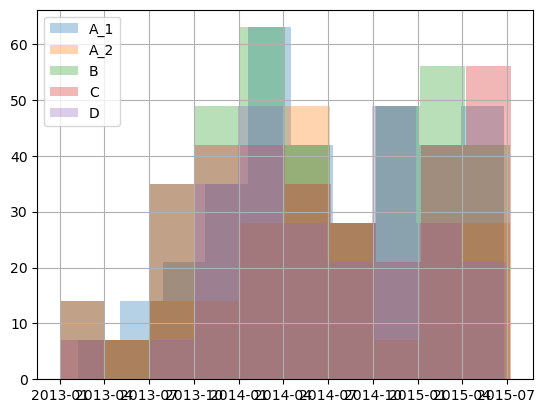

In [122]:
data_use.groupby("global_trajectory").test_date.hist(alpha=0.333, legend=True)

In [123]:
data_use.to_csv(data_dir+"Tacera_haq_data.csv", index=False)

In [124]:
patient_values= [ 'Evaluator global','Fatique', "Metrologist's score", 'Pain score', 'Patient global']
patient_values_baseline = [ 'Evaluator_b','Fatique_b', "HAQ_b", 'Pain_b', 'Patient_b']
patient_values_delta = [ 'Evaluator_delta','Fatique_delta', "HAQ_delta", 'Pain_delta', 'Patient_delta']
data_use_baseline = data_use.merge(data_use.query("months == 0 ")[["PATNR"]+patient_values].rename(columns=dict(zip(patient_values,patient_values_baseline))), on="PATNR")

In [125]:
data_use_baseline[patient_values_delta] = (data_use_baseline[patient_values].values -data_use_baseline[patient_values_baseline].values)


In [126]:
from scipy import stats
print(stats.shapiro(data_use.query("`Metrologist's score` >= 0").sort_values("months").groupby("PATNR").head(1)["Metrologist's score"]))
stats.shapiro(data_use.query("`Metrologist's score` >= 0").sort_values("months").groupby("PATNR").tail(1)["Metrologist's score"])

ShapiroResult(statistic=0.9727553530947588, pvalue=0.0003443442257511909)


ShapiroResult(statistic=0.8654327019633989, pvalue=7.040935266966893e-13)

In [127]:
(~data_use["Metrologist's score"].isna()).mean()

0.7255291005291006

In [128]:
#data_heatmap.merge()
data_use
test_data = data_heatmap[["PATNR", "months", "label"]].merge(data_use[["PATNR", "months", "Metrologist's score"]])
test_data.groupby("label")["Metrologist's score"].describe()
test_data.groupby("label")["Metrologist's score"].sem()


label
1    0.057912
2    0.067163
3    0.069888
4    0.062007
5    0.061212
6    0.080647
7    0.068908
9    0.081509
Name: Metrologist's score, dtype: float64

In [129]:
import numpy as np
from scipy.stats import f_oneway, normaltest, kruskal, alexandergovern

anova_data = {}
for i in sorted(test_data.label.unique()):
    print(i)
    anova_data[i] = test_data.query("label == @i")["Metrologist's score"].dropna().values
    #data_use.query("`Metrologist's score` >= 0 & months == 12")
    print(normaltest(anova_data[i]))
    print(len(anova_data[i]),anova_data[i].mean(), anova_data[i].std())
anova_data
print("anova:", f_oneway(*anova_data.values()))
print("kruskal:", kruskal(*anova_data.values()))
print("alexandergovern:", alexandergovern(*anova_data.values()))

1
NormaltestResult(statistic=34.154717004864125, pvalue=3.831752389569798e-08)
83 0.3313253012048193 0.524416534262643
2
NormaltestResult(statistic=19.089539113700965, pvalue=7.157465287136876e-05)
58 0.46120689655172414 0.5070658584247452
3
NormaltestResult(statistic=13.702993622264733, pvalue=0.0010578710740656318)
82 0.5228658536585366 0.6289897196064597
4
NormaltestResult(statistic=12.036278537798854, pvalue=0.002434194765561321)
92 0.7622282608695652 0.5915103017086094
5
NormaltestResult(statistic=7.257054302153188, pvalue=0.026555267517245497)
95 0.6947368421052632 0.5934721065679822
6
NormaltestResult(statistic=7.964738551407472, pvalue=0.018641420310659518)
71 1.4630281690140845 0.6747438109935594
7
NormaltestResult(statistic=31.276949842982205, pvalue=1.6154615890116923e-07)
126 1.3839285714285714 0.7704195432851746
9
NormaltestResult(statistic=1.5961764592844971, pvalue=0.45018879955376834)
55 0.9818181818181818 0.5989660512737867
anova: F_onewayResult(statistic=37.8506183317

In [130]:
import scipy
scipy.__version__
from scipy.stats import tukey_hsd

In [131]:
print("kruskal:", kruskal(*[anova_data[key] for key in [1,2,3]]))

kruskal: KruskalResult(statistic=6.8242928384731245, pvalue=0.03297035616568776)


In [132]:
print(tukey_hsd(*[anova_data[key] for key in [1,2,3]]))

Tukey's HSD Pairwise Group Comparisons (95.0% Confidence Interval)
Comparison  Statistic  p-value  Lower CI  Upper CI
 (0 - 1)     -0.130     0.373    -0.358     0.098
 (0 - 2)     -0.192     0.077    -0.399     0.016
 (1 - 0)      0.130     0.373    -0.098     0.358
 (1 - 2)     -0.062     0.800    -0.290     0.167
 (2 - 0)      0.192     0.077    -0.016     0.399
 (2 - 1)      0.062     0.800    -0.167     0.290



In [133]:

res = (tukey_hsd(*anova_data.values()))
print(res)

Tukey's HSD Pairwise Group Comparisons (95.0% Confidence Interval)
Comparison  Statistic  p-value  Lower CI  Upper CI
 (0 - 1)     -0.130     0.933    -0.460     0.200
 (0 - 2)     -0.192     0.523    -0.492     0.109
 (0 - 3)     -0.431     0.000    -0.723    -0.139
 (0 - 4)     -0.363     0.004    -0.653    -0.074
 (0 - 5)     -1.132     0.000    -1.443    -0.820
 (0 - 6)     -1.053     0.000    -1.325    -0.780
 (0 - 7)     -0.650     0.000    -0.986    -0.315
 (1 - 0)      0.130     0.933    -0.200     0.460
 (1 - 2)     -0.062     0.999    -0.392     0.269
 (1 - 3)     -0.301     0.089    -0.624     0.022
 (1 - 4)     -0.234     0.346    -0.555     0.088
 (1 - 5)     -1.002     0.000    -1.343    -0.661
 (1 - 6)     -0.923     0.000    -1.229    -0.617
 (1 - 7)     -0.521     0.000    -0.883    -0.158
 (2 - 0)      0.192     0.523    -0.109     0.492
 (2 - 1)      0.062     0.999    -0.269     0.392
 (2 - 3)     -0.239     0.203    -0.532     0.053
 (2 - 4)     -0.172     0.621   

In [134]:
data_use.query("`Metrologist's score` >= 0").sort_values("months").groupby("PATNR").head(1).groupby("global_trajectory")["Metrologist's score"].describe()

,count,mean,std,min,25%,50%,75%,max
global_trajectory,,,,,,,,
A_1,50.0,1.157500,0.804091,0.000,0.37500,1.125,1.75000,2.875
A_2,30.0,1.162500,0.644230,0.000,0.78125,1.125,1.59375,2.250
B,55.0,1.177273,0.689157,0.000,0.75000,1.250,1.62500,2.750
C,46.0,0.970109,0.733705,0.000,0.50000,0.750,1.43750,2.750
D,35.0,1.457143,0.627892,0.125,1.12500,1.375,1.81250,2.875


In [135]:
haq_test = data_use.query("months == 0")[["PATNR", "Metrologist's score"]].rename(columns={"Metrologist's score":"base_haq"}).merge(data_use.query("months == 18")[["PATNR", "global_trajectory","Metrologist's score"]]).dropna()
haq_test["delta_haq"] = haq_test["Metrologist's score"] - haq_test.base_haq


In [136]:
haq_test.groupby("global_trajectory")["delta_haq"].describe()

,count,mean,std,min,25%,50%,75%,max
global_trajectory,,,,,,,,
A_1,21.0,-0.541667,1.017298,-2.875,-1.12500,-0.3750,-0.12500,1.500
A_2,16.0,-0.640625,0.643679,-2.125,-0.93750,-0.6250,-0.21875,0.250
B,27.0,-0.592593,0.510223,-1.625,-1.00000,-0.5000,-0.25000,0.250
C,18.0,-0.395833,0.527288,-1.250,-0.75000,-0.3125,-0.15625,1.000
D,10.0,0.012500,0.593512,-0.875,-0.40625,0.0000,0.34375,1.125


In [137]:
import numpy as np
from scipy.stats import f_oneway, normaltest, kruskal, alexandergovern

anova_data = {}
for i in sorted(haq_test.global_trajectory.unique()):
    print(i)
    anova_data[i] = haq_test.query("global_trajectory == @i")["delta_haq"].values
    #data_use.query("`Metrologist's score` >= 0 & months == 12")
    print(normaltest(anova_data[i]))
    print(len(anova_data[i]),anova_data[i].mean(), anova_data[i].std())
anova_data
print("anova:", f_oneway(anova_data["B"], anova_data["C"], anova_data["D"]))
print("kruskal:", kruskal(anova_data["A_1"], anova_data["A_2"], anova_data["B"], anova_data["C"], anova_data["D"]))
print("alexandergovern:", alexandergovern(anova_data["A_1"], anova_data["A_2"], anova_data["B"], anova_data["C"], anova_data["D"]))

A_1
NormaltestResult(statistic=1.3746602570280948, pvalue=0.5029170019736204)
21 -0.5416666666666666 0.9927814862118852
A_2
NormaltestResult(statistic=3.600767232378833, pvalue=0.16523548905322338)
16 -0.640625 0.6232397085993479
B
NormaltestResult(statistic=1.952466969249934, pvalue=0.3767273794225626)
27 -0.5925925925925926 0.500685401281325
C
NormaltestResult(statistic=4.3605929840014035, pvalue=0.11300801969897642)
18 -0.3958333333333333 0.5124322448437019
D
NormaltestResult(statistic=0.24751362331197238, pvalue=0.883594694687302)
10 0.0125 0.5630552814777604
anova: F_onewayResult(statistic=4.760495595132441, pvalue=0.01263224417677765)
kruskal: KruskalResult(statistic=7.371700229317643, pvalue=0.1175016666950651)
alexandergovern: AlexanderGovernResult(statistic=7.5694816726870915, pvalue=0.10868418641628376)


/exports/reum/nsteinz/trajectories/lib/python3.11/site-packages/scipy/stats/_axis_nan_policy.py:430: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=16 observations were given.
  return hypotest_fun_in(*args, **kwds)
/exports/reum/nsteinz/trajectories/lib/python3.11/site-packages/scipy/stats/_axis_nan_policy.py:430: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=18 observations were given.
  return hypotest_fun_in(*args, **kwds)
/exports/reum/nsteinz/trajectories/lib/python3.11/site-packages/scipy/stats/_axis_nan_policy.py:430: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=10 observations were given.
  return hypotest_fun_in(*args, **kwds)


In [138]:
import numpy as np
from scipy.stats import f_oneway, normaltest, kruskal, alexandergovern

anova_data = {}
for i in sorted(haq_test.global_trajectory.unique()):
    print(i)
    anova_data[i] = haq_test.query("global_trajectory == @i")["base_haq"].values
    #data_use.query("`Metrologist's score` >= 0 & months == 12")
    print(normaltest(anova_data[i]))
    print(len(anova_data[i]),anova_data[i].mean(), anova_data[i].std())
anova_data
print("anova:", f_oneway(anova_data["A_1"], anova_data["A_2"],anova_data["B"], anova_data["C"], anova_data["D"]))
print("kruskal:", kruskal(anova_data["A_1"], anova_data["A_2"], anova_data["B"], anova_data["C"], anova_data["D"]))
print("alexandergovern:", alexandergovern(anova_data["A_1"], anova_data["A_2"], anova_data["B"], anova_data["C"], anova_data["D"]))

A_1
NormaltestResult(statistic=3.7742108077889505, pvalue=0.1515097342086518)
21 1.3630952380952381 0.7961073093952613
A_2
NormaltestResult(statistic=0.15128299661119982, pvalue=0.9271485313057644)
16 1.1875 0.667317390751957
B
NormaltestResult(statistic=2.938657264617492, pvalue=0.23007990155815544)
27 1.1296296296296295 0.6765598245233913
C
NormaltestResult(statistic=0.543647021481026, pvalue=0.7619887320502053)
18 1.1041666666666667 0.7074136185979019
D
NormaltestResult(statistic=0.6544876140615441, pvalue=0.7209079591698225)
10 1.35 0.5086747487343951
anova: F_onewayResult(statistic=0.5252525741860087, pvalue=0.7174235006710848)
kruskal: KruskalResult(statistic=2.0740619071394364, pvalue=0.7221390123254592)
alexandergovern: AlexanderGovernResult(statistic=2.0703308761539745, pvalue=0.7228248605043952)


/exports/reum/nsteinz/trajectories/lib/python3.11/site-packages/scipy/stats/_axis_nan_policy.py:430: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=16 observations were given.
  return hypotest_fun_in(*args, **kwds)
/exports/reum/nsteinz/trajectories/lib/python3.11/site-packages/scipy/stats/_axis_nan_policy.py:430: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=18 observations were given.
  return hypotest_fun_in(*args, **kwds)
/exports/reum/nsteinz/trajectories/lib/python3.11/site-packages/scipy/stats/_axis_nan_policy.py:430: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=10 observations were given.
  return hypotest_fun_in(*args, **kwds)


In [139]:
import numpy as np
from scipy.stats import f_oneway, normaltest, kruskal, alexandergovern, ttest_rel

anova_data = {}
for i in sorted(haq_test.global_trajectory.unique()):
    print(i)
    anova_data[i] = haq_test.query("global_trajectory == @i")["Metrologist's score"].values
    #data_use.query("`Metrologist's score` >= 0 & months == 12")
    print(normaltest(anova_data[i]))
    print(len(anova_data[i]),anova_data[i].mean(), anova_data[i].std())
anova_data
print("anova:", f_oneway(anova_data["A_1"], anova_data["A_2"],anova_data["B"], anova_data["C"], anova_data["D"]))
print("kruskal:", kruskal(anova_data["A_1"], anova_data["A_2"], anova_data["B"], anova_data["C"], anova_data["D"]))
print("alexandergovern:", alexandergovern(anova_data["A_1"], anova_data["A_2"], anova_data["B"], anova_data["C"], anova_data["D"]))

A_1
NormaltestResult(statistic=1.3382187779821197, pvalue=0.5121645140800926)
21 0.8214285714285714 0.5844862270916774
A_2
NormaltestResult(statistic=9.892227197801105, pvalue=0.007110991460975554)
16 0.546875 0.6523320545358782
B
NormaltestResult(statistic=3.782248476564262, pvalue=0.15090206356047345)
27 0.5370370370370371 0.5968811831314553
C
NormaltestResult(statistic=2.64253961876597, pvalue=0.2667963063283583)
18 0.7083333333333334 0.7430231041719587
D
NormaltestResult(statistic=2.0085340864992007, pvalue=0.3663130280383433)
10 1.3625 0.7530147740914517
anova: F_onewayResult(statistic=3.1760245973502284, pvalue=0.017411149844054084)
kruskal: KruskalResult(statistic=10.929247498458006, pvalue=0.027370788790745136)
alexandergovern: AlexanderGovernResult(statistic=8.352590670951875, pvalue=0.07948350832659655)


/exports/reum/nsteinz/trajectories/lib/python3.11/site-packages/scipy/stats/_axis_nan_policy.py:430: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=16 observations were given.
  return hypotest_fun_in(*args, **kwds)
/exports/reum/nsteinz/trajectories/lib/python3.11/site-packages/scipy/stats/_axis_nan_policy.py:430: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=18 observations were given.
  return hypotest_fun_in(*args, **kwds)
/exports/reum/nsteinz/trajectories/lib/python3.11/site-packages/scipy/stats/_axis_nan_policy.py:430: UserWarning: `kurtosistest` p-value may be inaccurate with fewer than 20 observations; only n=10 observations were given.
  return hypotest_fun_in(*args, **kwds)


In [140]:
for i in sorted(haq_test.global_trajectory.unique()):
    print(i)
    test_data =  haq_test.query("global_trajectory == @i")
    print(ttest_rel(test_data["base_haq"], test_data["Metrologist's score"]))

A_1
TtestResult(statistic=2.44002029577309, pvalue=0.024122034602078207, df=20)
A_2
TtestResult(statistic=3.9810203392530163, pvalue=0.0012049593034942337, df=15)
B
TtestResult(statistic=6.035009579882617, pvalue=2.249602139846956e-06, df=26)
C
TtestResult(statistic=3.184933539792088, pvalue=0.00542041025945058, df=17)
D
TtestResult(statistic=-0.06660092043108058, pvalue=0.9483554550312945, df=9)


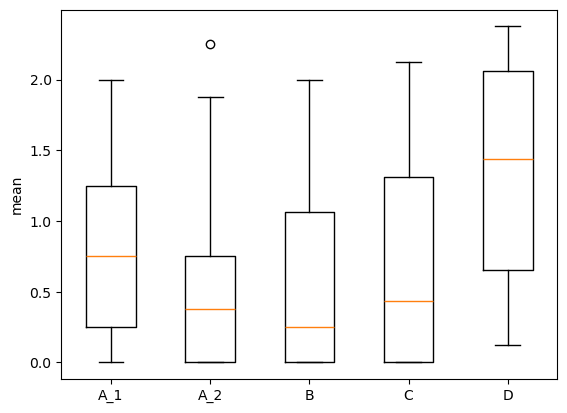

In [141]:
fig, ax = plt.subplots(1, 1)
ax.boxplot(anova_data.values())
ax.set_xticklabels(["A_1", "A_2", "B", "C", "D"]) 
ax.set_ylabel("mean") 
plt.show()

In [142]:
from scipy.stats import tukey_hsd
res = (tukey_hsd(*anova_data.values()))

In [143]:
print(res)

Tukey's HSD Pairwise Group Comparisons (95.0% Confidence Interval)
Comparison  Statistic  p-value  Lower CI  Upper CI
 (0 - 1)      0.275     0.733    -0.346     0.895
 (0 - 2)      0.284     0.594    -0.260     0.829
 (0 - 3)      0.113     0.985    -0.488     0.714
 (0 - 4)     -0.541     0.230    -1.260     0.177
 (1 - 0)     -0.275     0.733    -0.895     0.346
 (1 - 2)      0.010     1.000    -0.580     0.600
 (1 - 3)     -0.161     0.956    -0.804     0.481
 (1 - 4)     -0.816     0.027    -1.570    -0.062
 (2 - 0)     -0.284     0.594    -0.829     0.260
 (2 - 1)     -0.010     1.000    -0.600     0.580
 (2 - 3)     -0.171     0.918    -0.740     0.398
 (2 - 4)     -0.825     0.011    -1.518    -0.133
 (3 - 0)     -0.113     0.985    -0.714     0.488
 (3 - 1)      0.161     0.956    -0.481     0.804
 (3 - 2)      0.171     0.918    -0.398     0.740
 (3 - 4)     -0.654     0.107    -1.392     0.083
 (4 - 0)      0.541     0.230    -0.177     1.260
 (4 - 1)      0.816     0.027   

In [144]:
data_use.query("`Metrologist's score` >= 0 & months == 12").groupby("global_trajectory")["Metrologist's score"].describe()

,count,mean,std,min,25%,50%,75%,max
global_trajectory,,,,,,,,
A_1,30.0,0.795833,0.715803,0.000,0.15625,0.6250,1.12500,2.750
A_2,22.0,0.636364,0.564196,0.000,0.25000,0.5000,0.96875,2.000
B,41.0,0.625000,0.731544,0.000,0.00000,0.2500,1.12500,2.250
C,30.0,0.491667,0.659752,0.000,0.00000,0.1250,0.71875,2.125
D,24.0,1.135417,0.810023,0.125,0.46875,1.0625,1.65625,2.750


In [145]:
for i in range(0,21,3):
    print("\n",i,)
    print(data_use_baseline.query("`Metrologist's score` >= 0 & months >= @i").sort_values("months").groupby("PATNR").tail(1).groupby("global_trajectory")["HAQ_delta"].describe().loc[:,["count","mean","std"]])


 0
                   count      mean       std
global_trajectory                           
A_1                 50.0 -0.447500  0.775539
A_2                 30.0 -0.662500  0.552375
B                   54.0 -0.634259  0.586730
C                   46.0 -0.413043  0.476438
D                   35.0 -0.307143  0.712508

 3
                   count      mean       std
global_trajectory                           
A_1                 50.0 -0.447500  0.775539
A_2                 30.0 -0.662500  0.552375
B                   54.0 -0.634259  0.586730
C                   46.0 -0.413043  0.476438
D                   35.0 -0.307143  0.712508

 6
                   count      mean       std
global_trajectory                           
A_1                 50.0 -0.447500  0.775539
A_2                 29.0 -0.668103  0.561284
B                   54.0 -0.634259  0.586730
C                   45.0 -0.400000  0.473442
D                   35.0 -0.307143  0.712508

 9
                   count      mean     

In [146]:
full_trajectory = data_use_baseline.query("months == 12")[["PATNR","Metrologist's score"]].dropna().PATNR
full_trajectory = data_use_baseline.query("PATNR in @full_trajectory")

In [147]:
data_use_baseline.columns


Index(['PATNR', 'months', 'Study', 'Age', 'Race', 'Sex', 'Weight',
       'Date of Assessment', 'Date of symptom onset', 'Final Score', 'RF',
       'acpa', 'acpa_value', 'rf_value', 'ACPA Value', 'Basophils',
       'CRP Value (mg/L)', 'DAS-28 CRP', 'DAS28', 'DAS28 relative',
       'ESR Value', 'Eosinophils', 'Evaluator global', 'Fatique', 'GL', 'Gdl',
       'HB', 'Lymphocytes', 'Metrologist's score', 'Monocytes', 'Neutrophils',
       'Outside 2 week window', 'PLT', 'Pain score', 'Patient global',
       'RF Unit', 'RF Value', 'SDAI <= 3.3', 'SDAI score',
       'Total 66/68 Swollen Joints', 'Total 66/68 Tender Joints',
       'Total Swollen', 'Total Tender', 'Use of sign '<'', 'WBC', 'Adalimumab',
       'Certolizumab', 'Dexamethasone', 'Etanercept', 'Folic Acid',
       'Golimumab', 'Hydroxychloroquine', 'Leflunomide', 'Methotrexate',
       'Methylprednisolone', 'Methylprednisolone Acetate', 'Prednisolone',
       'Sulfasalazine', 'Tocilizumab', 'Triamcinolone (Kenalog)', 'days'

In [148]:
data_use_baseline.query("`Metrologist's score` >= 0" ).sort_values("months").groupby("PATNR").head(1).groupby("global_trajectory")[["Metrologist's score"]].describe()

Metrologist's score                                      \
                                count      mean       std    min      25%   
global_trajectory                                                           
A_1                              50.0  1.157500  0.804091  0.000  0.37500   
A_2                              30.0  1.162500  0.644230  0.000  0.78125   
B                                55.0  1.177273  0.689157  0.000  0.75000   
C                                46.0  0.970109  0.733705  0.000  0.50000   
D                                35.0  1.457143  0.627892  0.125  1.12500   

                                          
                     50%      75%    max  
global_trajectory                         
A_1                1.125  1.75000  2.875  
A_2                1.125  1.59375  2.250  
B                  1.250  1.62500  2.750  
C                  0.750  1.43750  2.750  
D                  1.375  1.81250  2.875

In [149]:
data_use_baseline.query("`Metrologist's score` >= 0" ).sort_values("months").groupby("PATNR").head(1)[["Metrologist's score"]].describe()

,Metrologist's score
count,216.000000
mean,1.171875
std,0.720880
min,0.000000
25%,0.625000
50%,1.125000
75%,1.750000
max,2.875000


In [150]:
data_use_baseline.query("`Metrologist's score` >= 0" ).sort_values("months").groupby("PATNR").tail(1).groupby("global_trajectory")[["Metrologist's score"]].describe()

Metrologist's score                                   \
                                count      mean       std  min     25%   
global_trajectory                                                        
A_1                              50.0  0.710000  0.649490  0.0  0.1250   
A_2                              30.0  0.500000  0.551252  0.0  0.1250   
B                                55.0  0.554545  0.677330  0.0  0.0000   
C                                46.0  0.557065  0.687541  0.0  0.0000   
D                                35.0  1.150000  0.779329  0.0  0.5625   

                                          
                      50%     75%    max  
global_trajectory                         
A_1                0.6250  1.1250  2.125  
A_2                0.3125  0.7500  2.250  
B                  0.2500  1.0625  2.250  
C                  0.2500  1.0000  2.375  
D                  1.0000  1.8125  2.750

In [151]:
data_use_baseline.query("`Metrologist's score` >= 0" ).sort_values("months").groupby("PATNR").tail(1)[["Metrologist's score"]].describe()

,Metrologist's score
count,216.000000
mean,0.679977
std,0.703770
min,0.000000
25%,0.000000
50%,0.500000
75%,1.125000
max,2.750000


['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


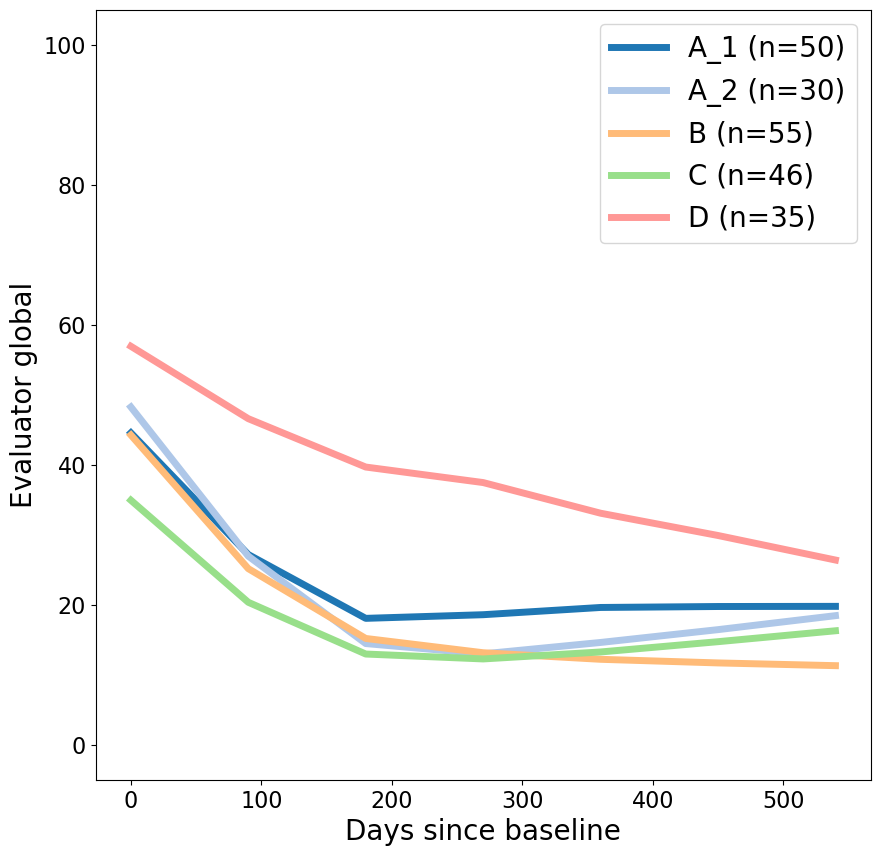

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


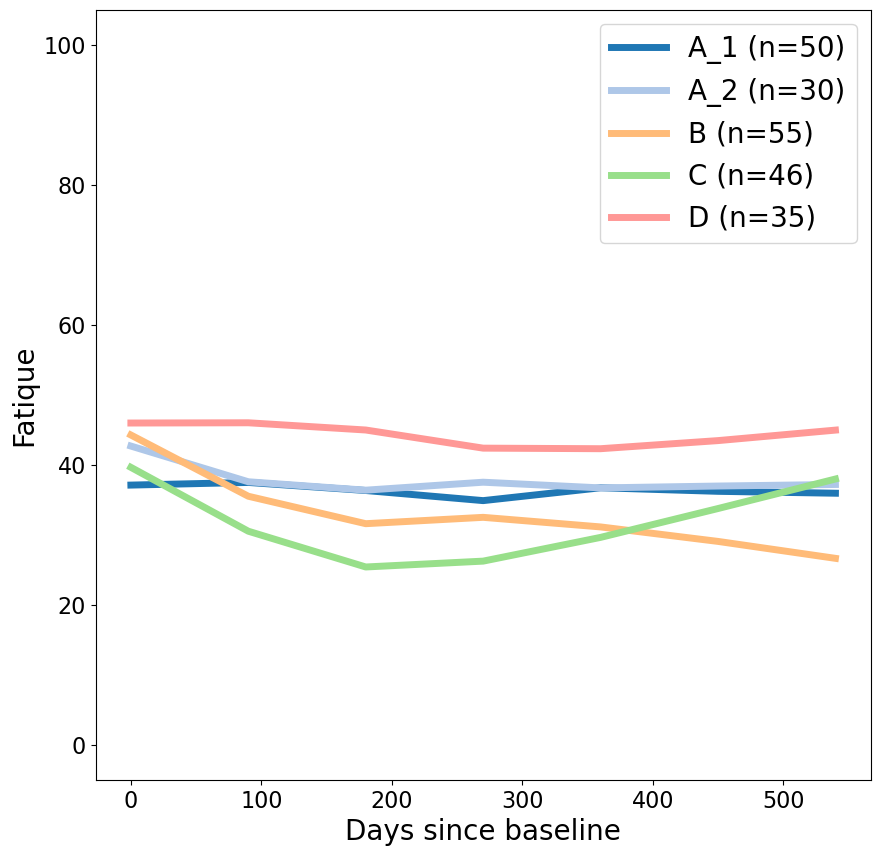

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


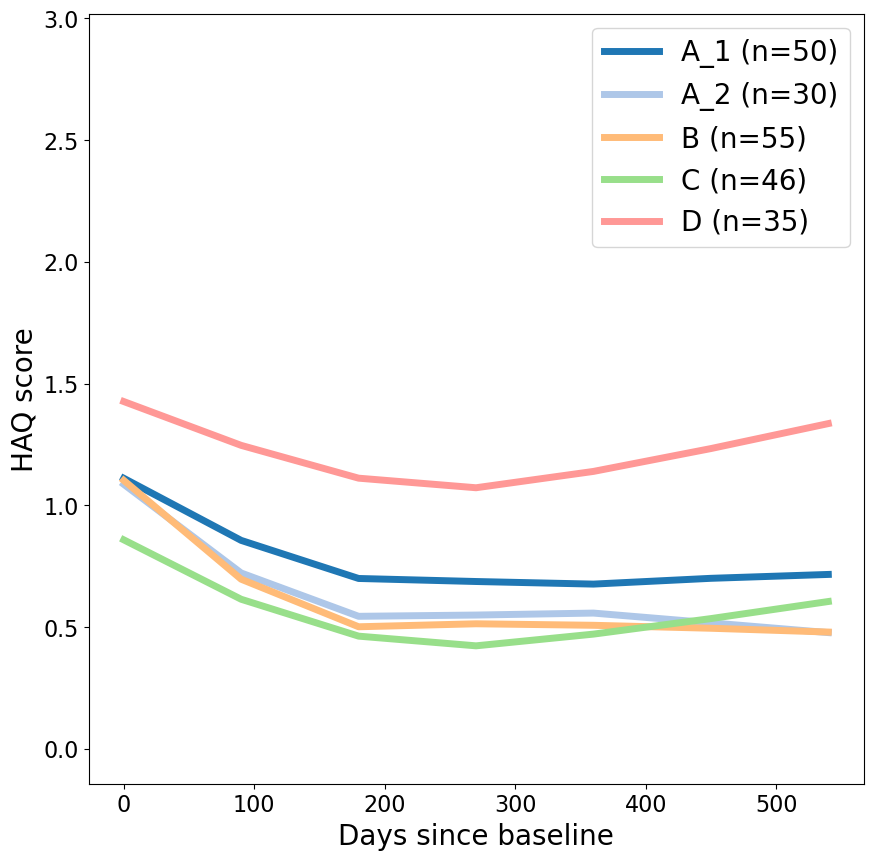

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


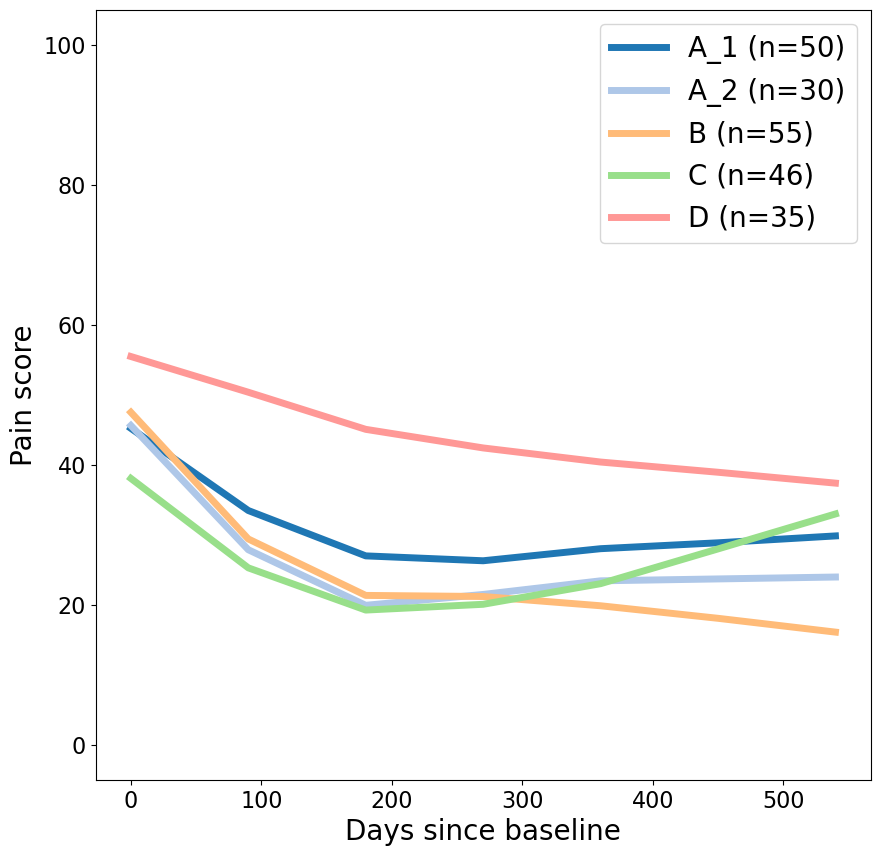

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


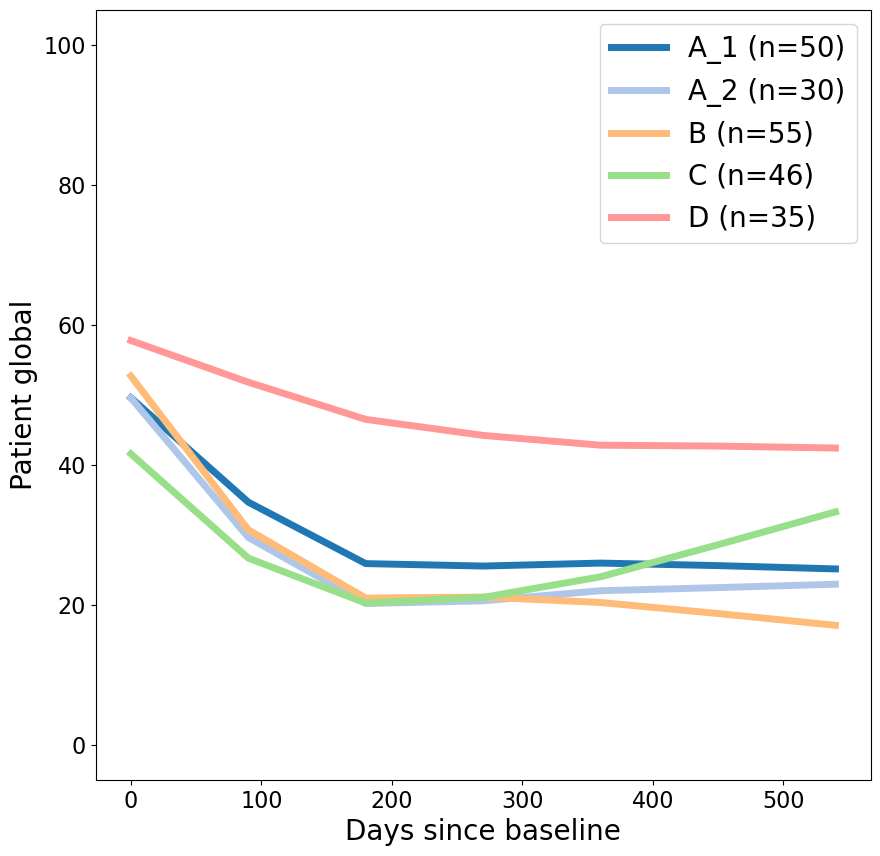

In [152]:
#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']
for column in patient_values:
    plot_clusters(data_use_baseline, column, "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper, alpha=0)
    #plt.title("TACERA patient reported outcomes") 
    plt.xlabel('Days since baseline', fontsize=20)
    if column == "Metrologist's score":
        column = "HAQ score"
    plt.ylabel(column, fontsize=20)
    plt.tick_params(axis='both', which='major', labelsize=16)
    plt.tick_params(axis='both', which='minor', labelsize=16)
    plt.savefig(results_dir+f"/{column}_tacera", dpi=900, transparent=True, bbox_inches='tight')
    plt.show()

#plt.xlim((0,550))
#plt.hlines(2.6, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


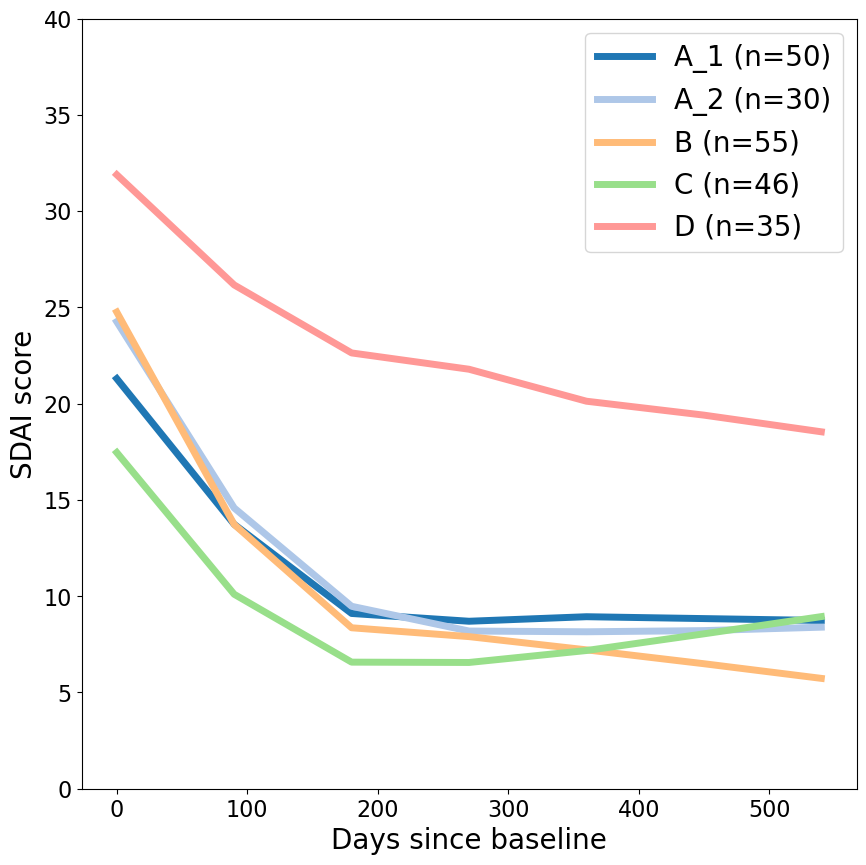

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


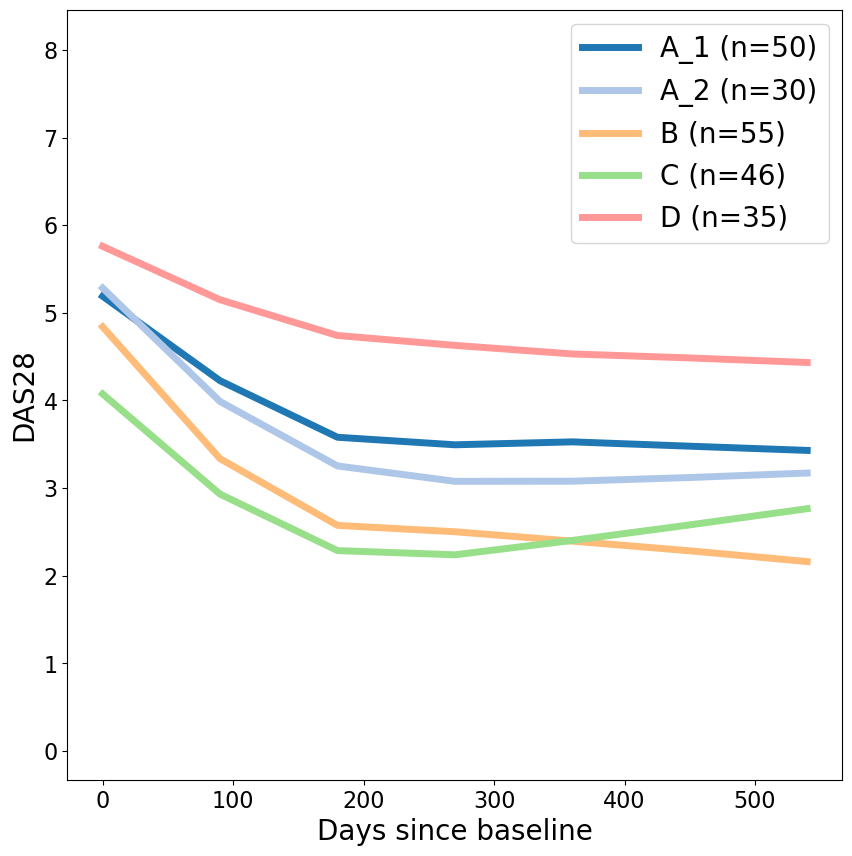

In [153]:
#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']
for column in ["SDAI score", "DAS28"]:
    plot_clusters(data_use_baseline, column, "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper, alpha=0)
    #plt.title("TACERA patient reported outcomes") 
    if column == "SDAI score":
        plt.ylim((0,40))
    plt.xlabel('Days since baseline', fontsize=20)
    plt.ylabel(column, fontsize=20)
    plt.tick_params(axis='both', which='major', labelsize=16)
    plt.tick_params(axis='both', which='minor', labelsize=16)
    plt.savefig(results_dir+f"/{column}_tacera", dpi=900, transparent=True, bbox_inches='tight')
    plt.show()

#plt.xlim((0,550))
#plt.hlines(2.6, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


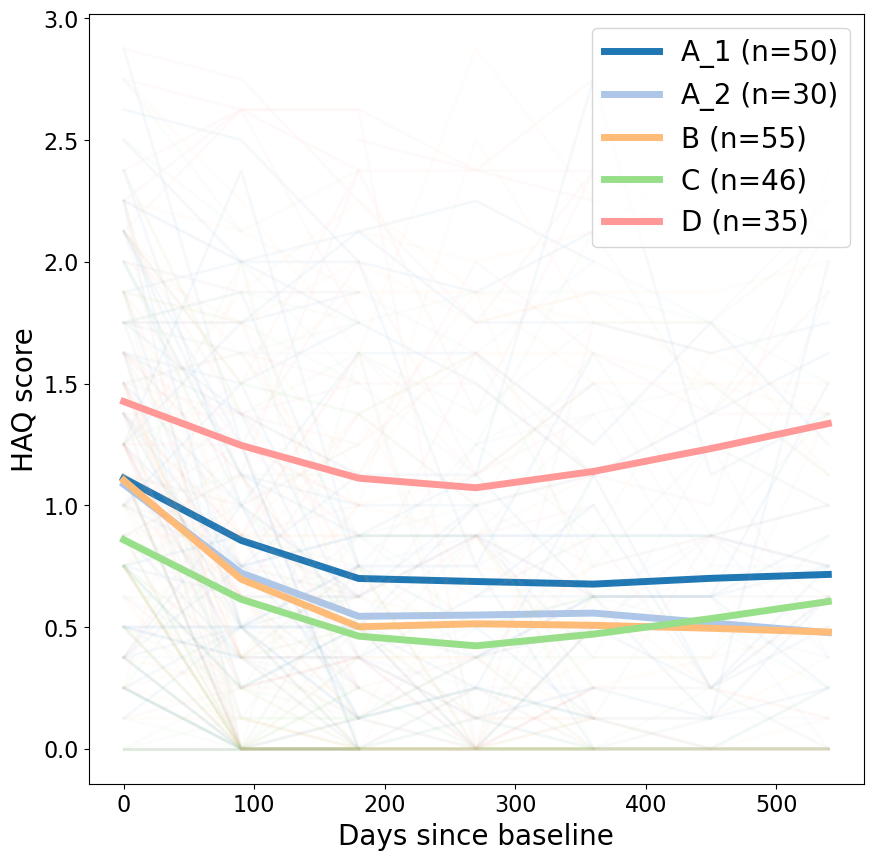

In [154]:
#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']

plot_clusters(data_use_baseline, "Metrologist's score", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
#plt.title("TACERA patient reported outcomes") 
plt.xlabel('Days since baseline', fontsize=20)
plt.ylabel("HAQ score", fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=16)
plt.tick_params(axis='both', which='minor', labelsize=16)
plt.savefig(results_dir+f"/HAQ score_tacera", dpi=900, transparent=True, bbox_inches='tight')
plt.show()

In [155]:
full_trajectory

,PATNR,months,Study,Age,Race,Sex,Weight,Date of Assessment,Date of symptom onset,Final Score,...,Evaluator_b,Fatique_b,HAQ_b,Pain_b,Patient_b,Evaluator_delta,Fatique_delta,HAQ_delta,Pain_delta,Patient_delta
7,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,0,TACERA,42,White- British,Female,73.4,8/9/2013,3/2/2013,0.0,...,88.0,15.0,1.625,36.0,63.0,0.0,0.0,0.000,0.0,0.0
8,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,3,TACERA,42,White- British,Female,73.4,8/9/2013,3/2/2013,0.0,...,88.0,15.0,1.625,36.0,63.0,-67.0,6.0,-1.625,-15.0,-35.0
9,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,6,TACERA,42,White- British,Female,73.4,8/9/2013,3/2/2013,0.0,...,88.0,15.0,1.625,36.0,63.0,-85.0,3.0,-1.625,-34.0,-62.0
10,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,9,TACERA,42,White- British,Female,73.4,8/9/2013,3/2/2013,0.0,...,88.0,15.0,1.625,36.0,63.0,-80.0,57.0,-1.625,-30.0,-53.0
11,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,12,TACERA,42,White- British,Female,73.4,8/9/2013,3/2/2013,0.0,...,88.0,15.0,1.625,36.0,63.0,-85.0,32.0,-1.625,-8.0,-20.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1507,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,6,TACERA,52,Asian or Asian British - Any other Asian backg...,Female,80.0,2/5/2014,7/8/2013,1.0,...,79.0,75.0,2.125,76.0,7.0,-25.0,-19.0,0.250,-2.0,65.0
1508,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,9,TACERA,52,Asian or Asian British - Any other Asian backg...,Female,80.0,2/5/2014,7/8/2013,1.0,...,79.0,75.0,2.125,76.0,7.0,-35.0,-66.0,-0.750,-59.0,10.0
1509,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,12,TACERA,52,Asian or Asian British - Any other Asian backg...,Female,80.0,2/5/2014,7/8/2013,1.0,...,79.0,75.0,2.125,76.0,7.0,-4.0,-6.0,0.250,3.0,81.0
1510,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,15,TACERA,52,Asian or Asian British - Any other Asian backg...,Female,80.0,2/5/2014,7/8/2013,1.0,...,79.0,75.0,2.125,76.0,7.0,-45.0,13.0,0.000,9.0,70.0


In [156]:
data_heatmap

,Subject ID,months,Study,Age,Race,Sex,Weight,Date of Assessment,Date of symptom onset,Final Score,...,label_text,to_clust_text,age_cate,seasons,global_trajectory,communi,das28_o,Remission,Digest,Symp_Duration
0,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,0,TACERA,79,White- British,1,50.80,6/25/2015,2/1/2015,9.0,...,7,5,old,1,A_1,3,7.278203,False,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,144.0
1,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,6,TACERA,79,White- British,1,50.80,6/25/2015,2/1/2015,9.0,...,5,-1,old,1,A_1,3,2.328413,True,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,144.0
2,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,0,TACERA,42,White- British,1,73.40,8/9/2013,3/2/2013,0.0,...,7,3,middle,1,B,1,4.963557,False,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,160.0
3,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,6,TACERA,42,White- British,1,73.40,8/9/2013,3/2/2013,0.0,...,3,7,middle,1,B,1,2.983482,False,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,160.0
4,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,12,TACERA,42,White- British,1,73.40,8/9/2013,3/2/2013,0.0,...,7,1,middle,1,B,1,4.521627,False,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,160.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
745,FF316CBA26DD9BC1E0575F0930ECE7A0F15F9D2B3FED6C...,6,TACERA,69,White- British,0,94.45,2/2/2015,10/5/2014,19.0,...,2,-1,old,1,A_2,2,2.159716,True,FF316CBA26DD9BC1E0575F0930ECE7A0F15F9D2B3FED6C...,120.0
746,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,0,TACERA,52,Asian or Asian British - Any other Asian backg...,1,80.00,2/5/2014,7/8/2013,1.0,...,7,7,old,1,D,4,5.842586,False,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,212.0
747,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,6,TACERA,52,Asian or Asian British - Any other Asian backg...,1,80.00,2/5/2014,7/8/2013,1.0,...,7,7,old,1,D,4,5.505155,False,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,212.0
748,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,12,TACERA,52,Asian or Asian British - Any other Asian backg...,1,80.00,2/5/2014,7/8/2013,1.0,...,7,7,old,1,D,4,6.397339,False,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,212.0


['A_1 (n=53)', 'A_2 (n=37)', 'B (n=62)', 'C (n=50)', 'D (n=41)']


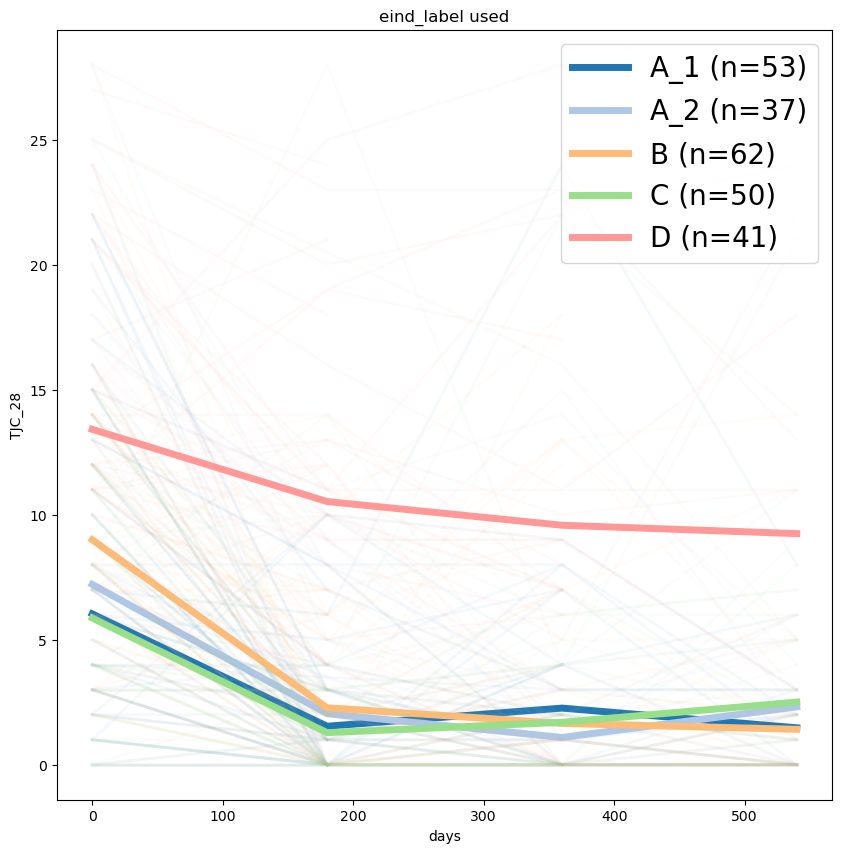

['A_1 (n=53)', 'A_2 (n=37)', 'B (n=62)', 'C (n=50)', 'D (n=41)']


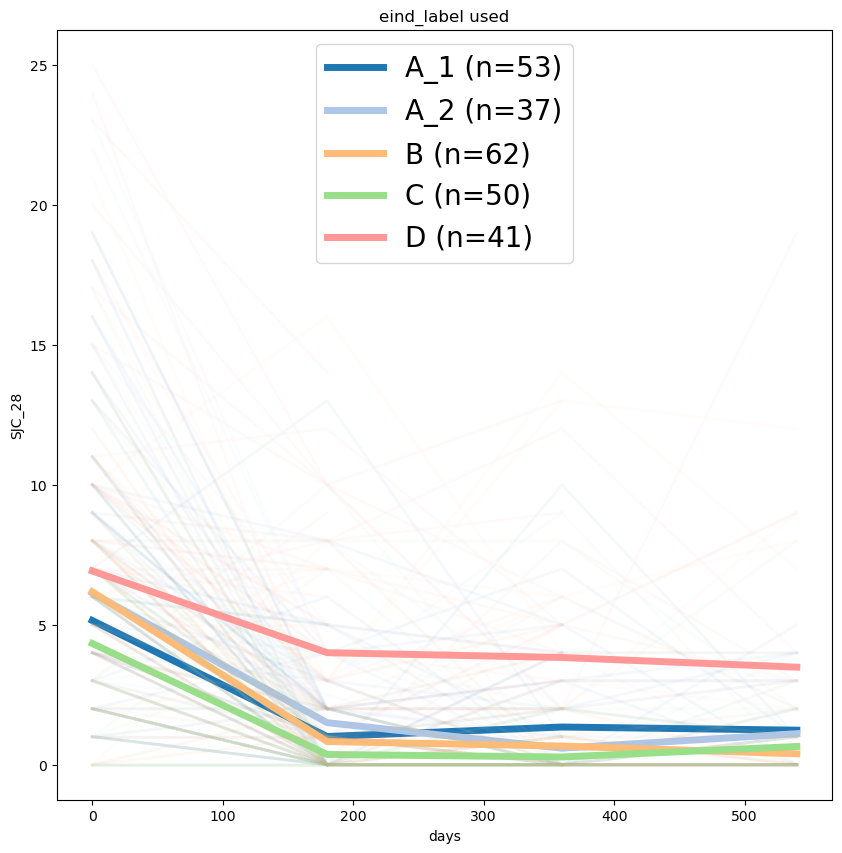

['A_1 (n=53)', 'A_2 (n=37)', 'B (n=62)', 'C (n=50)', 'D (n=41)']


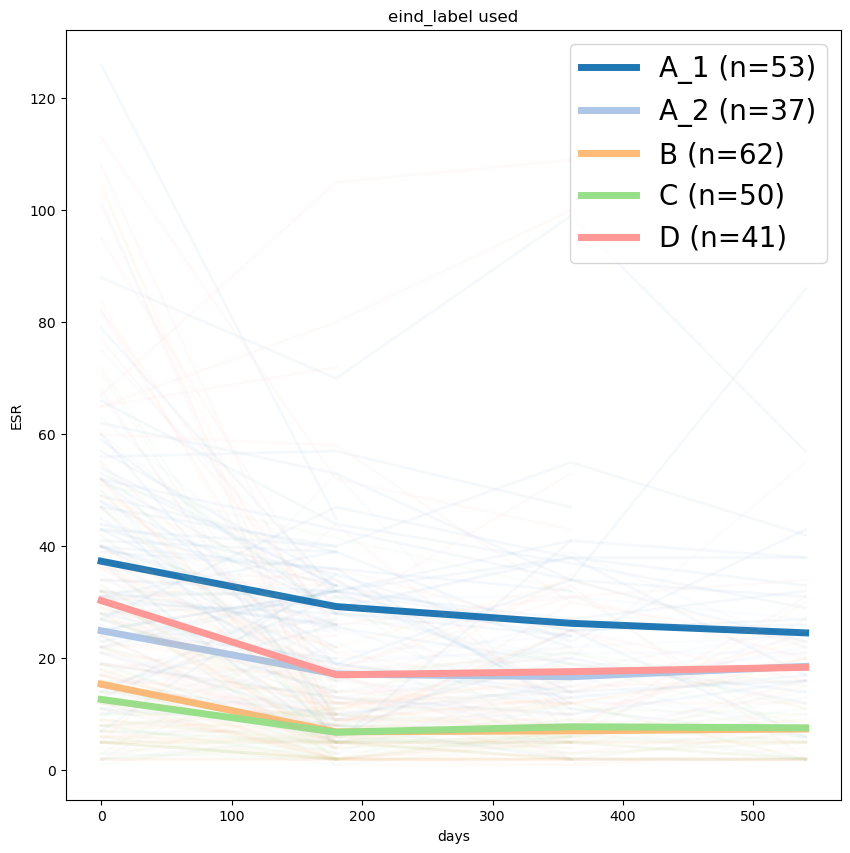

['A_1 (n=53)', 'A_2 (n=37)', 'B (n=62)', 'C (n=50)', 'D (n=41)']


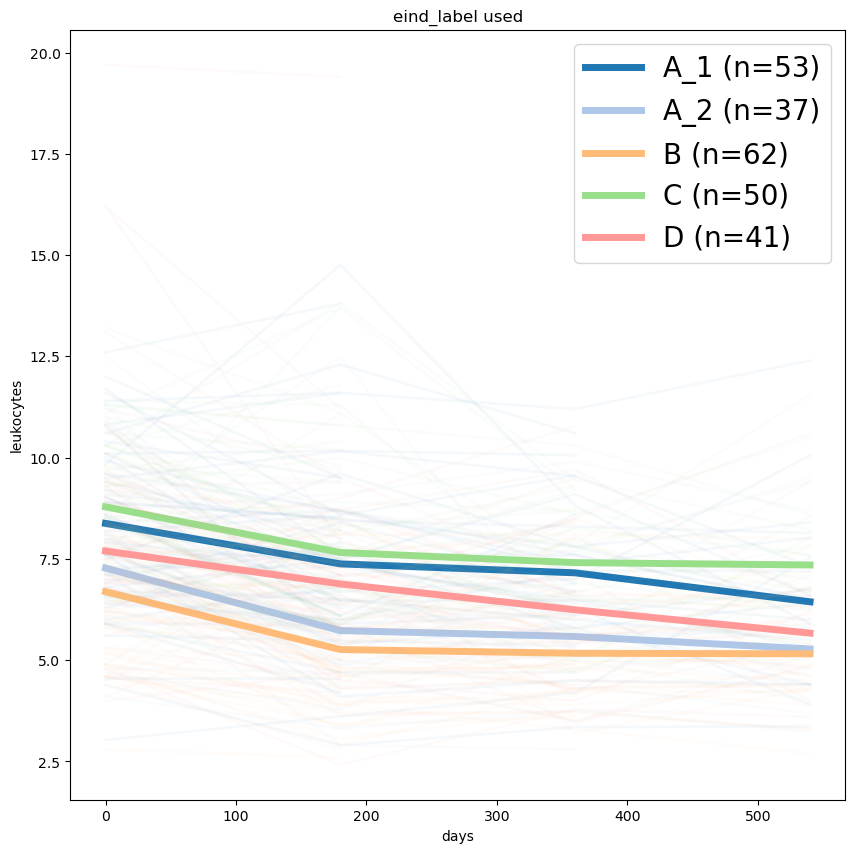

['A_1 (n=53)', 'A_2 (n=37)', 'B (n=62)', 'C (n=50)', 'D (n=41)']


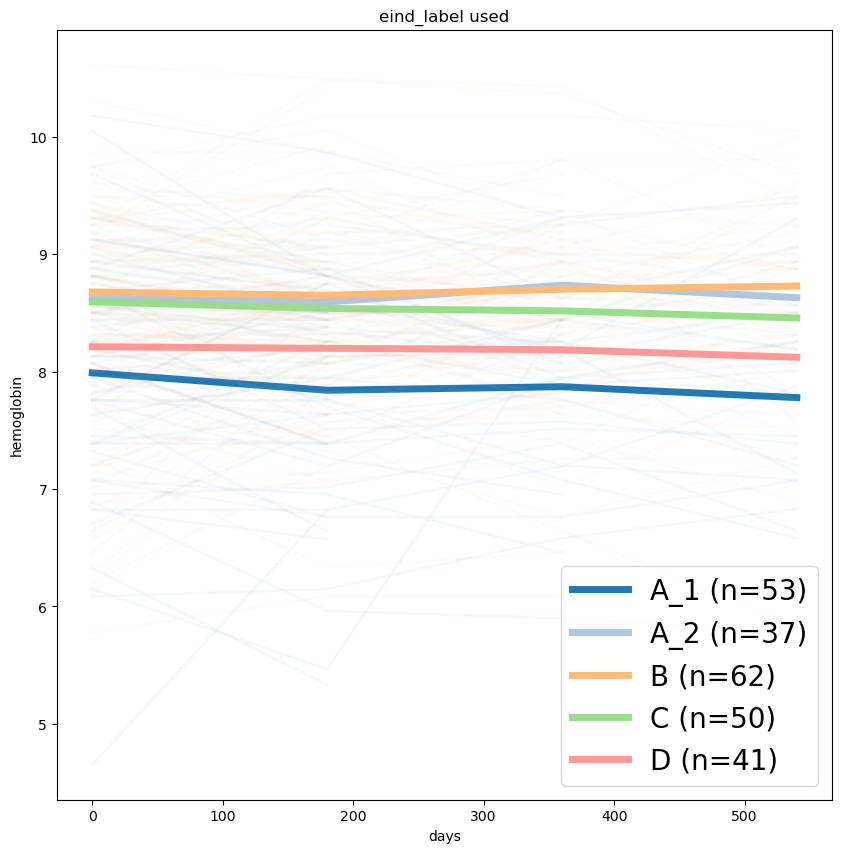

['A_1 (n=53)', 'A_2 (n=37)', 'B (n=62)', 'C (n=50)', 'D (n=41)']


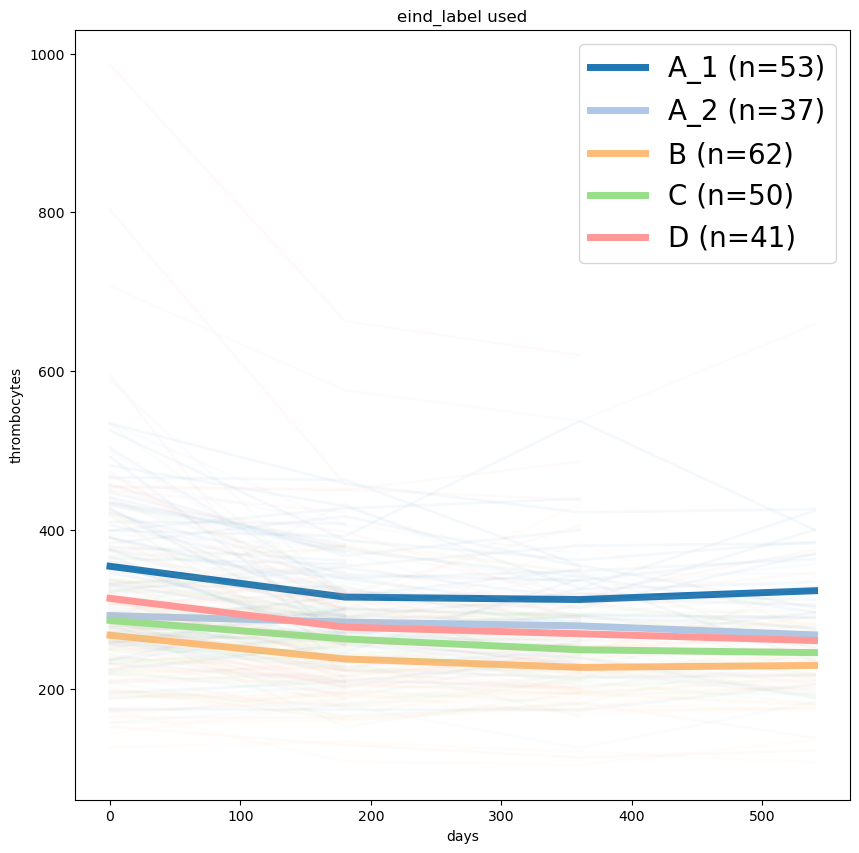

In [157]:
#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']
for column in features:
    plot_clusters(data_heatmap, column, "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
    plt.title("eind_label used") 
    plt.show()

#plt.xlim((0,550))
#plt.hlines(2.6, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

['A_1 (n=30)', 'A_2 (n=22)', 'B (n=41)', 'C (n=30)', 'D (n=24)']


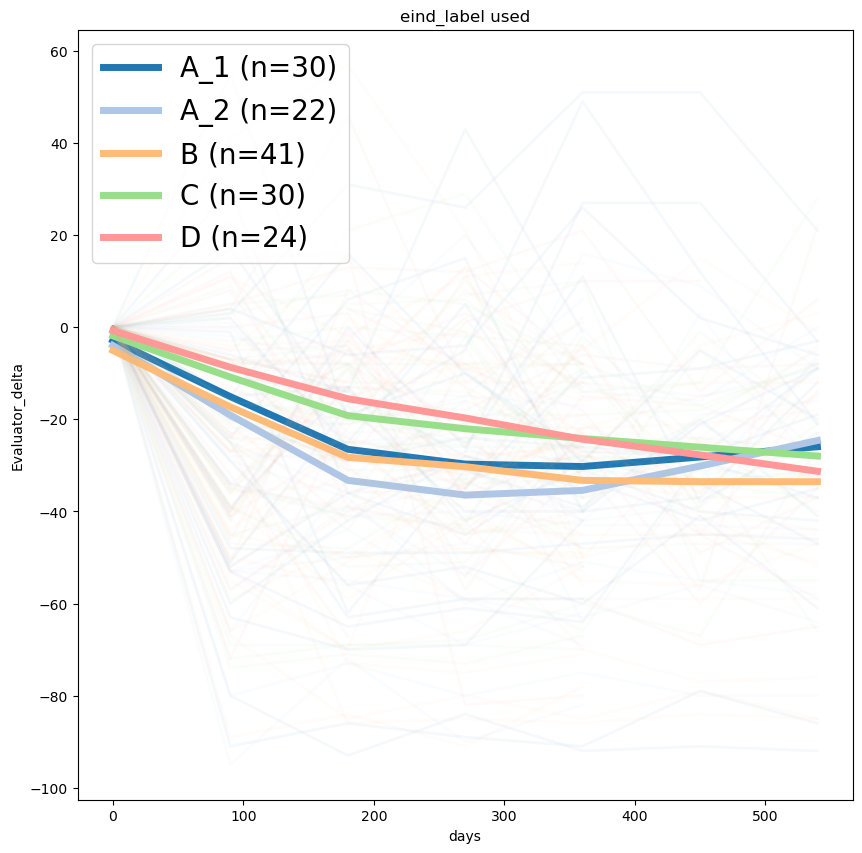

['A_1 (n=30)', 'A_2 (n=22)', 'B (n=41)', 'C (n=30)', 'D (n=24)']


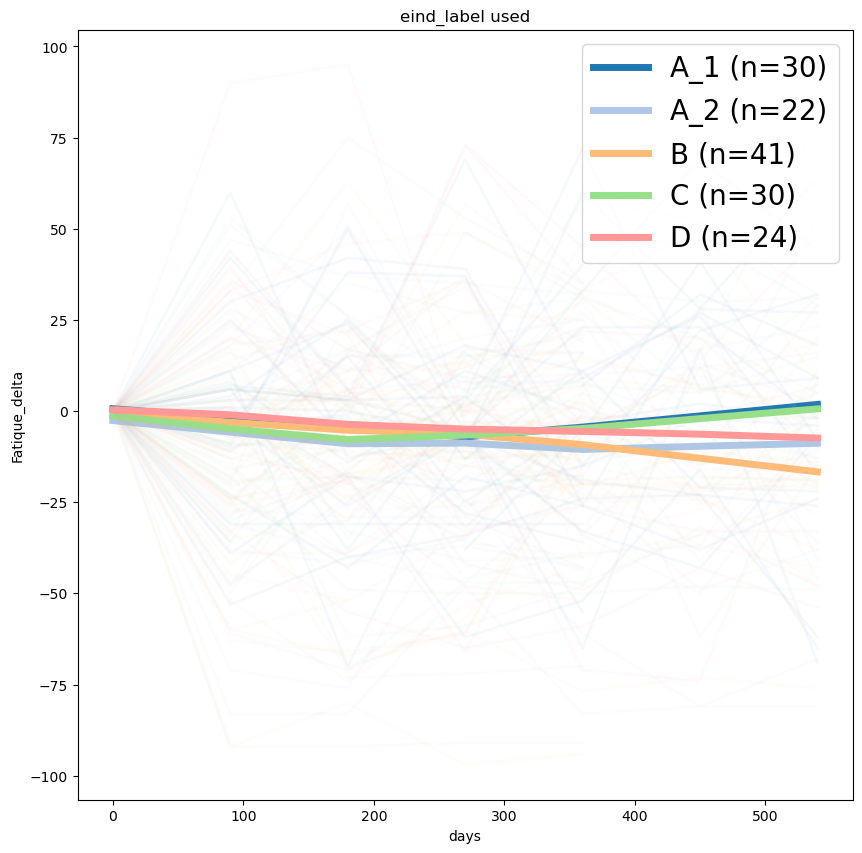

['A_1 (n=30)', 'A_2 (n=22)', 'B (n=41)', 'C (n=30)', 'D (n=24)']


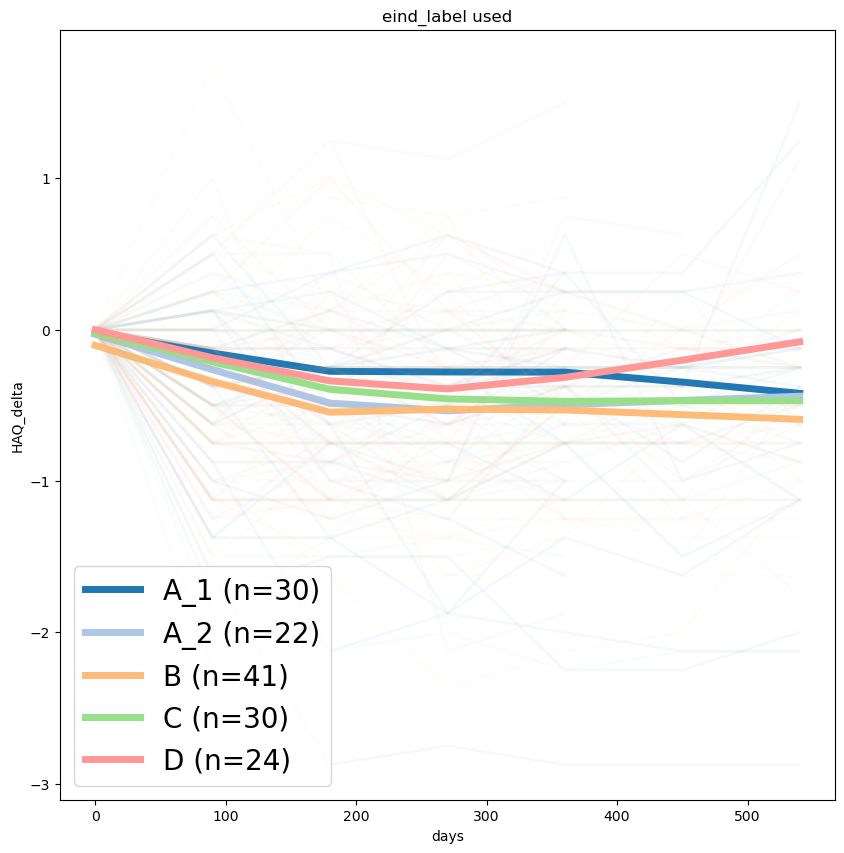

['A_1 (n=30)', 'A_2 (n=22)', 'B (n=41)', 'C (n=30)', 'D (n=24)']


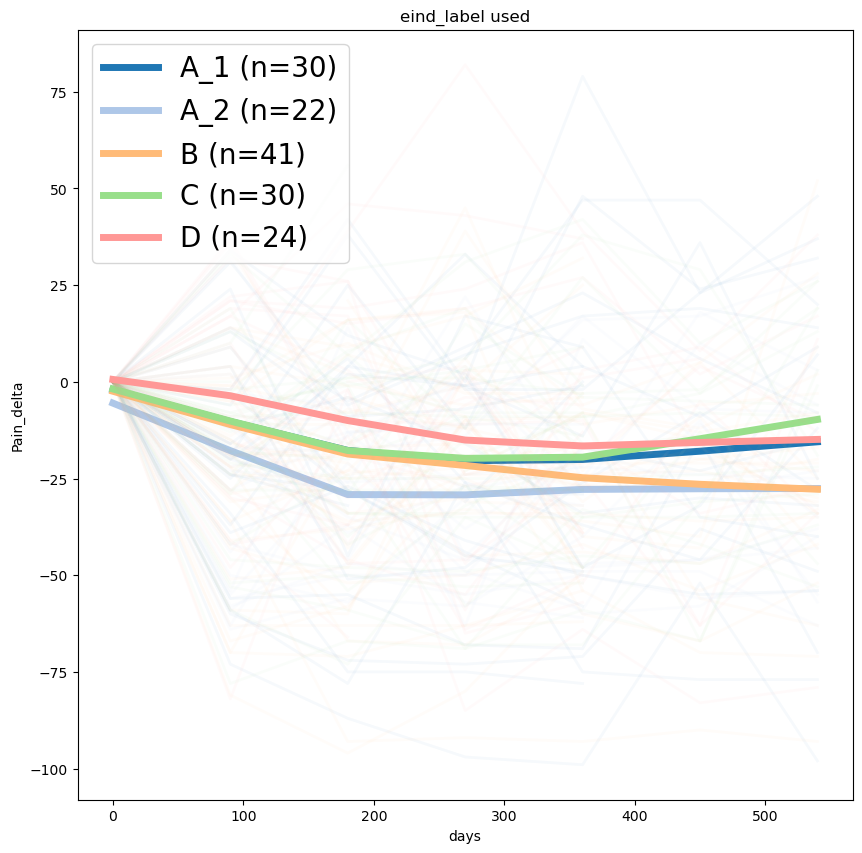

['A_1 (n=30)', 'A_2 (n=22)', 'B (n=41)', 'C (n=30)', 'D (n=24)']


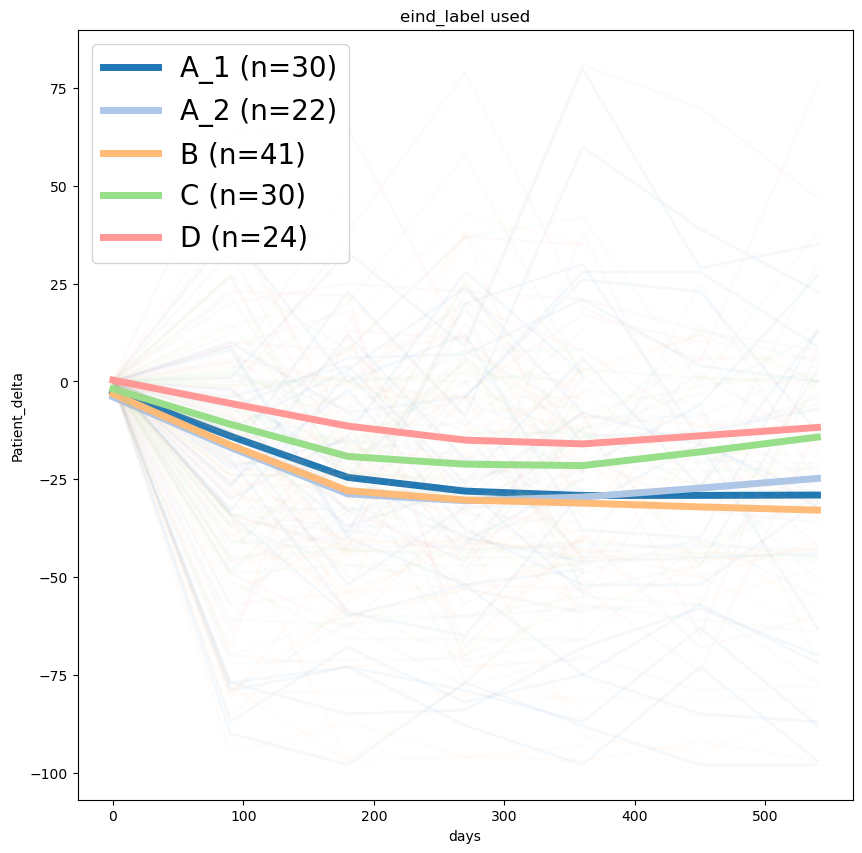

In [158]:
#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']
for column in patient_values_delta:
    plot_clusters(full_trajectory, column, "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
    plt.title("eind_label used") 
    plt.show()

#plt.xlim((0,550))
#plt.hlines(2.6, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

['A_1 (n=30)', 'A_2 (n=22)', 'B (n=41)', 'C (n=30)', 'D (n=24)']


Text(0.5, 1.0, 'eind_label used')

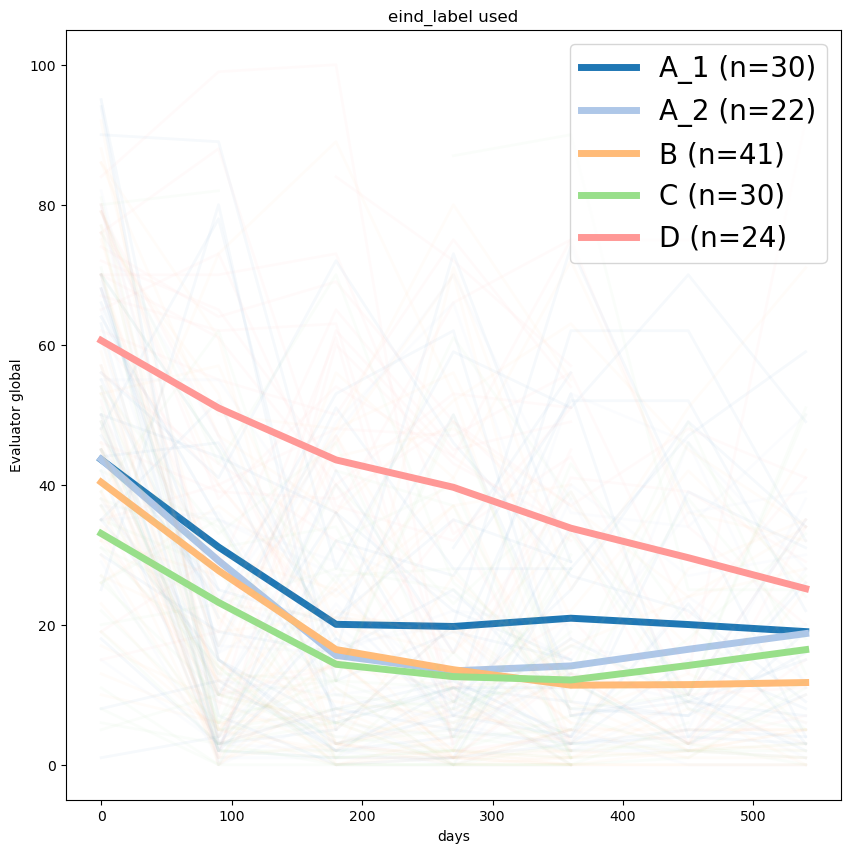

In [159]:
#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']

plot_clusters(full_trajectory, "Evaluator global", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
plt.title("eind_label used") 

#plt.xlim((0,550))
#plt.hlines(2.6, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

['A_1 (n=30)', 'A_2 (n=22)', 'B (n=41)', 'C (n=30)', 'D (n=24)']


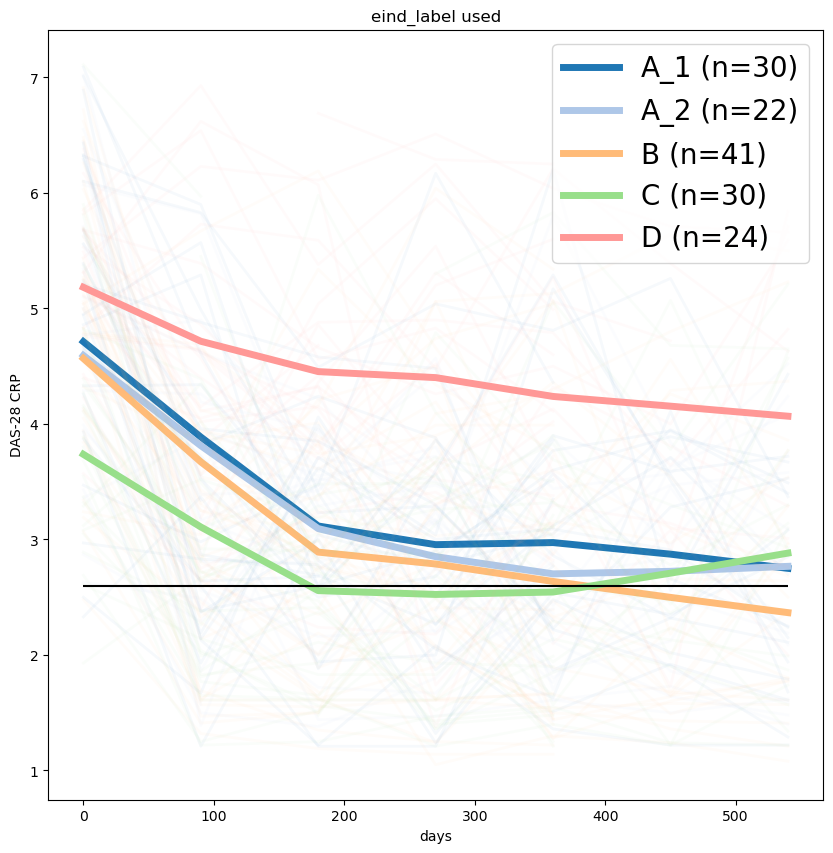

In [160]:
#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']

plot_clusters(full_trajectory, "DAS-28 CRP", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
plt.title("eind_label used") 

#plt.xlim((0,550))
plt.hlines(2.6, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

['A_1 (n=30)', 'A_2 (n=22)', 'B (n=41)', 'C (n=30)', 'D (n=24)']


Text(0.5, 1.0, 'Fatique')

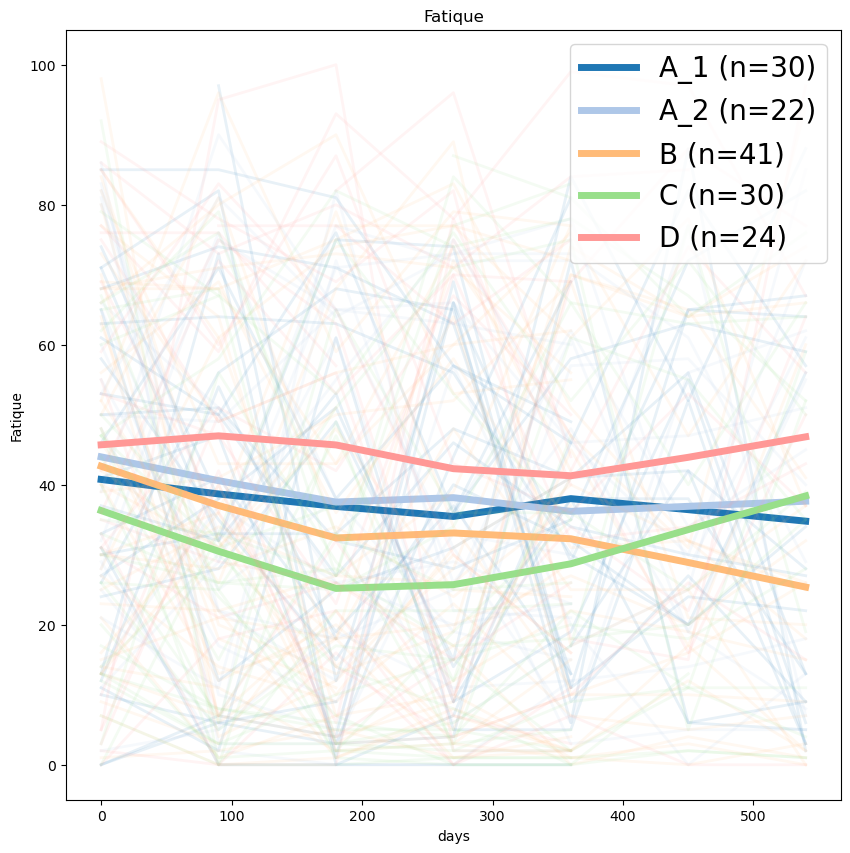

In [161]:
#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']

plot_clusters(full_trajectory, "Fatique", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper, alpha=0.1)
plt.title("Fatique") 

#plt.xlim((0,550))
#plt.hlines(2.6, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

['A_1 (n=30)', 'A_2 (n=22)', 'B (n=41)', 'C (n=30)', 'D (n=24)']


Text(0.5, 1.0, 'global_trajectory used')

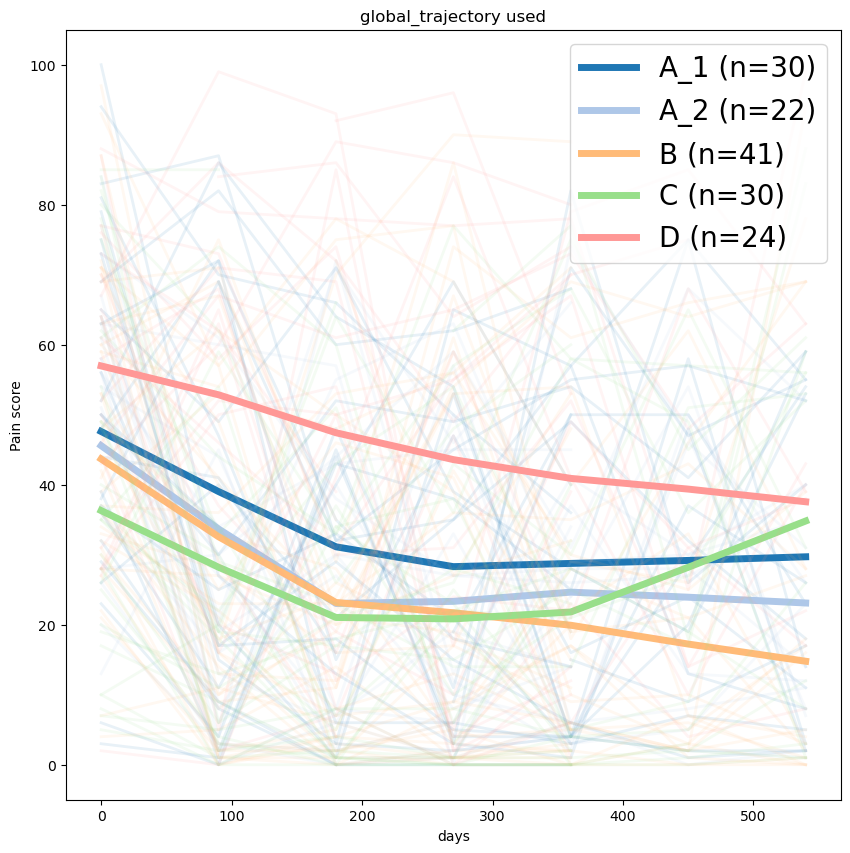

In [162]:
#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']

plot_clusters(full_trajectory, "Pain score", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper, alpha=0.1)
plt.title("global_trajectory used") 

#plt.xlim((0,550))
#plt.hlines(2.6, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

['A_1 (n=30)', 'A_2 (n=22)', 'B (n=41)', 'C (n=30)', 'D (n=24)']


Text(0.5, 1.0, 'global_trajectory used')

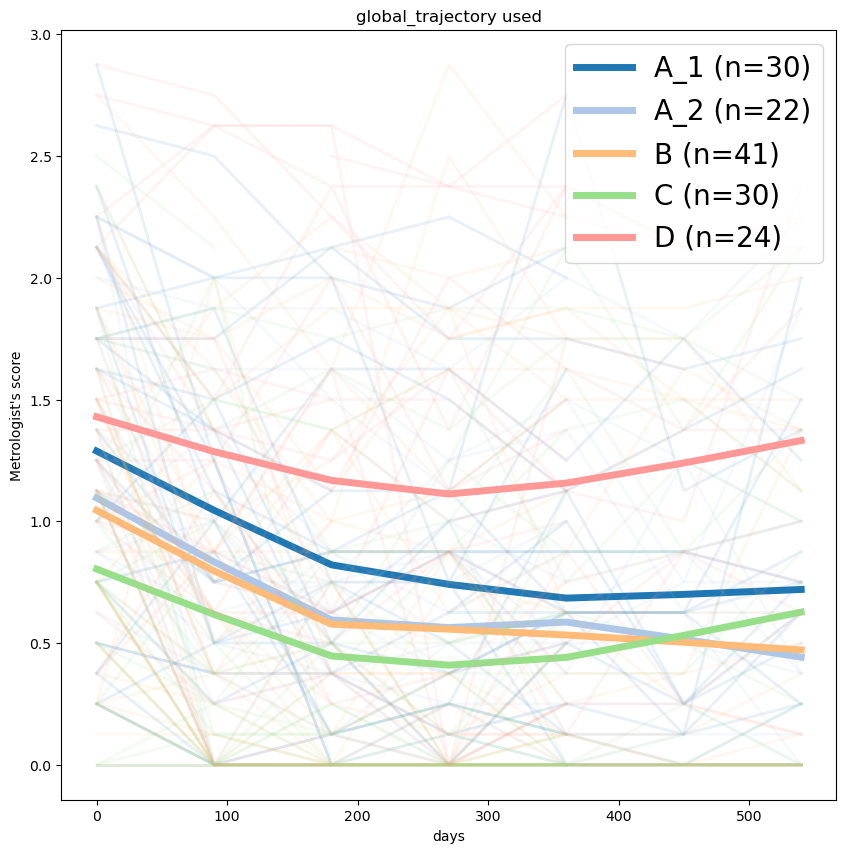

In [163]:

#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']

plot_clusters(full_trajectory, "Metrologist's score", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper, alpha=0.1)
plt.title("global_trajectory used") 

#plt.xlim((0,550))
#plt.hlines(2.6, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

['A_1 (n=30)', 'A_2 (n=22)', 'B (n=41)', 'C (n=30)', 'D (n=24)']


Text(0.5, 1.0, 'Patient global')

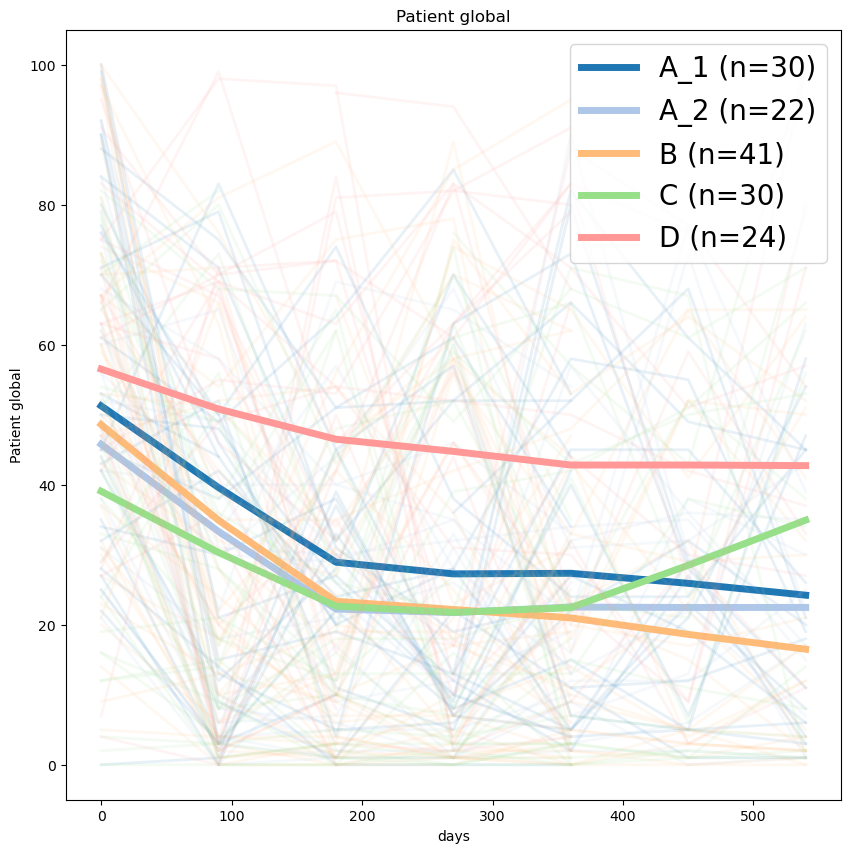

In [164]:



#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']

plot_clusters(full_trajectory, "Patient global", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper, alpha=0.1)
plt.title("Patient global") 

#plt.xlim((0,550))
#plt.hlines(2.6, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")


In [165]:
data_use[["PATNR","days","Patient global","global_trajectory"]].dropna(axis=0).groupby(["days","global_trajectory"]).count().reset_index(level=-1).pivot_table(
            values=["PATNR"], index="days", columns="global_trajectory").T

days                      0     90    180   270   360   450   540
      global_trajectory                                          
PATNR A_1                50.0  47.0  47.0  28.0  31.0  20.0  21.0
      A_2                30.0  29.0  28.0  21.0  22.0  14.0  16.0
      B                  55.0  54.0  55.0  39.0  41.0  23.0  28.0
      C                  46.0  45.0  45.0  30.0  30.0  18.0  19.0
      D                  34.0  33.0  35.0  22.0  24.0  11.0  11.0

In [166]:
data_heatmap.groupby(["months","global_trajectory"]).count()

Subject ID  Study  Age  Race  Sex  Weight  \
months global_trajectory                                              
0      A_1                        53     53   53    53   53      53   
       A_2                        37     37   37    37   37      37   
       B                          62     62   62    62   62      62   
       C                          50     50   50    50   50      50   
       D                          41     41   41    41   41      41   
6      A_1                        50     50   50    50   50      50   
       A_2                        36     36   36    36   36      36   
       B                          62     62   62    62   62      62   
       C                          49     49   49    49   49      49   
       D                          41     41   41    41   41      41   
12     A_1                        32     32   32    32   32      32   
       A_2                        27     27   27    27   27      27   
       B                          47     47   47    47   47      47   
       C                          32     32   32    32   32      32   
       D                          26     26   26    26   26      26   
18     A_1                        22     22   22    22   22      22   
       A_2                        18     18   18    18   18      18   
       B                          32     32   32    32   32      32   
       C                          21     21   21    21   21      21   
       D                          12     12   12    12   12      12   

                          Date of Assessment  Date of symptom onset  \
months global_trajectory                                              
0      A_1                                53                     53   
       A_2                                37                     37   
       B                                  62                     62   
       C                                  50                     50   
       D                                  41                     41   
6      A_1                                50                     50   
       A_2                                36                     36   
       B                                  62                     62   
       C                                  49                     49   
       D                                  41                     41   
12     A_1                                32                     32   
       A_2                                27                     27   
       B                                  47                     47   
       C                                  32                     32   
       D                                  26                     26   
18     A_1                                22                     22   
       A_2                                18                     18   
       B                                  32                     32   
       C                                  21                     21   
       D                                  12                     12   

                          Final Score  Unnamed: 10  ...  to_clust  label_text  \
months global_trajectory                            ...                         
0      A_1                         43           53  ...        53          53   
       A_2                         35           37  ...        37          37   
       B                           60           62  ...        62          62   
       C                           48           50  ...        50          50   
       D                           36           41  ...        41          41   
6      A_1                         41           50  ...        50          50   
       A_2                         34           36  ...        36          36   
       B                           60           62  ...        62          62   
       C                           47           49  ...        49          49   
       D 

In [167]:
data_use.columns

Index(['PATNR', 'months', 'Study', 'Age', 'Race', 'Sex', 'Weight',
       'Date of Assessment', 'Date of symptom onset', 'Final Score', 'RF',
       'acpa', 'acpa_value', 'rf_value', 'ACPA Value', 'Basophils',
       'CRP Value (mg/L)', 'DAS-28 CRP', 'DAS28', 'DAS28 relative',
       'ESR Value', 'Eosinophils', 'Evaluator global', 'Fatique', 'GL', 'Gdl',
       'HB', 'Lymphocytes', 'Metrologist's score', 'Monocytes', 'Neutrophils',
       'Outside 2 week window', 'PLT', 'Pain score', 'Patient global',
       'RF Unit', 'RF Value', 'SDAI <= 3.3', 'SDAI score',
       'Total 66/68 Swollen Joints', 'Total 66/68 Tender Joints',
       'Total Swollen', 'Total Tender', 'Use of sign '<'', 'WBC', 'Adalimumab',
       'Certolizumab', 'Dexamethasone', 'Etanercept', 'Folic Acid',
       'Golimumab', 'Hydroxychloroquine', 'Leflunomide', 'Methotrexate',
       'Methylprednisolone', 'Methylprednisolone Acetate', 'Prednisolone',
       'Sulfasalazine', 'Tocilizumab', 'Triamcinolone (Kenalog)', 'days'

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


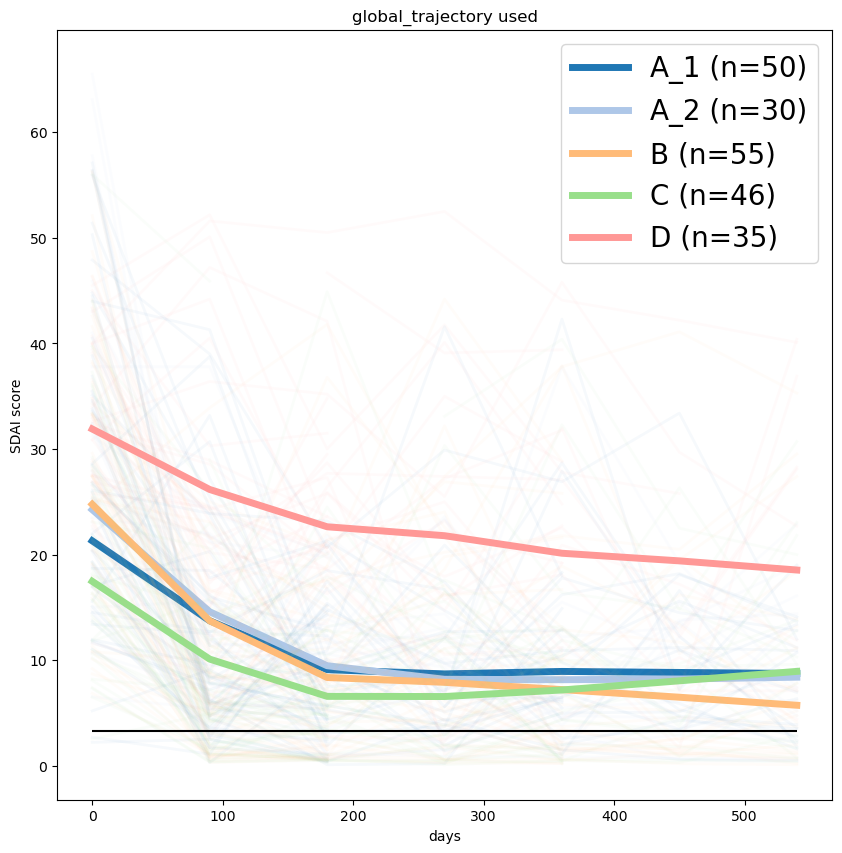

In [168]:

#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']

plot_clusters(data_use, "SDAI score", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
plt.title("global_trajectory used") 

#plt.xlim((0,550))
plt.hlines(3.3, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


(0.0, 40.0)

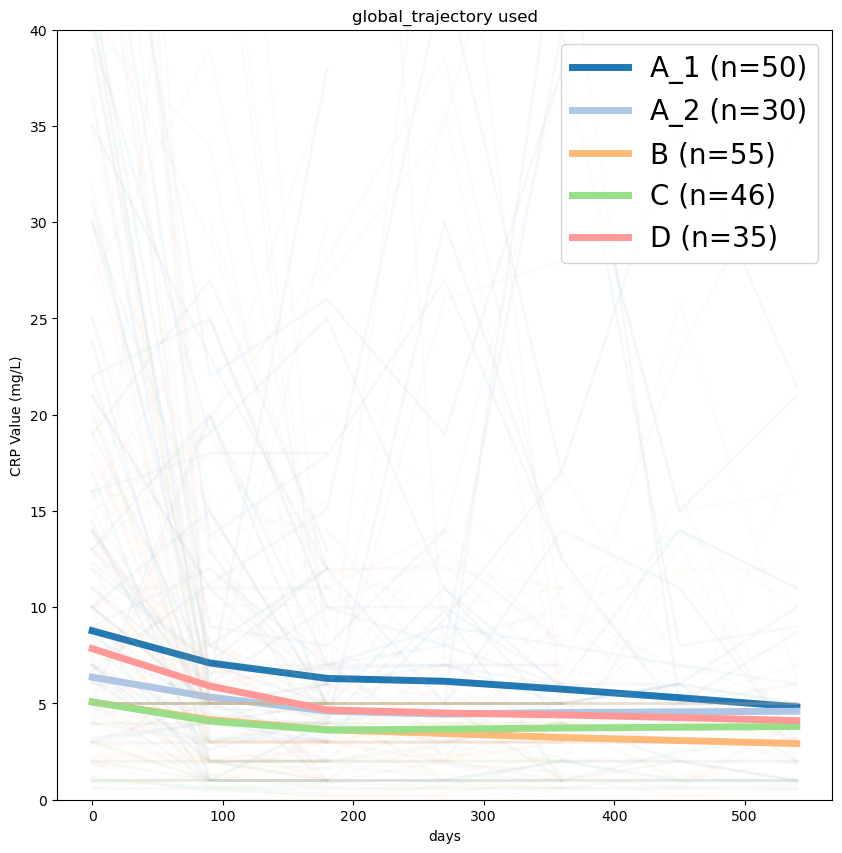

In [169]:

#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']

plot_clusters(data_use, "CRP Value (mg/L)", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
plt.title("global_trajectory used") 
plt.ylim((0,40))
#plt.xlim((0,550))
#plt.hlines(3.3, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


Text(0.5, 1.0, 'global_trajectory used')

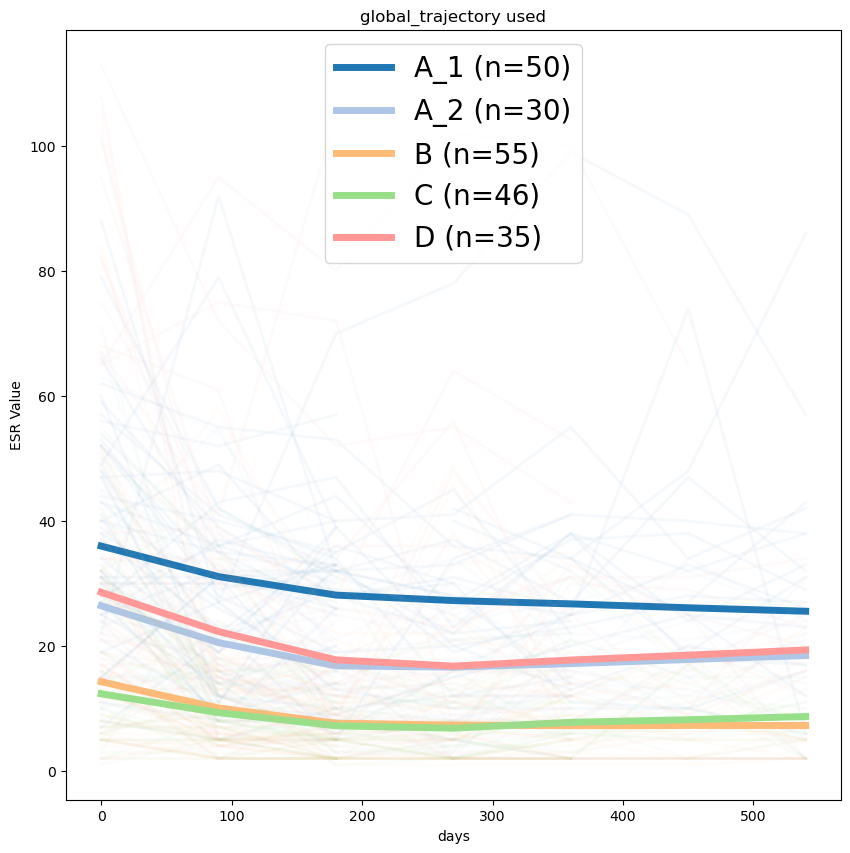

In [170]:

#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']

plot_clusters(data_use, "ESR Value", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
plt.title("global_trajectory used") 
#plt.ylim((0,40))
#plt.xlim((0,550))
#plt.hlines(3.3, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

<Axes: xlabel='CRP Value (mg/L)', ylabel='ESR Value'>

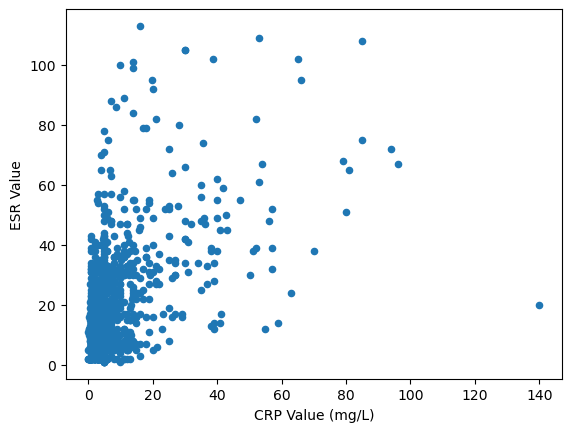

In [171]:
data_use[["CRP Value (mg/L)","ESR Value"]].plot.scatter("CRP Value (mg/L)","ESR Value")

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


Text(0.5, 1.0, 'global_trajectory used')

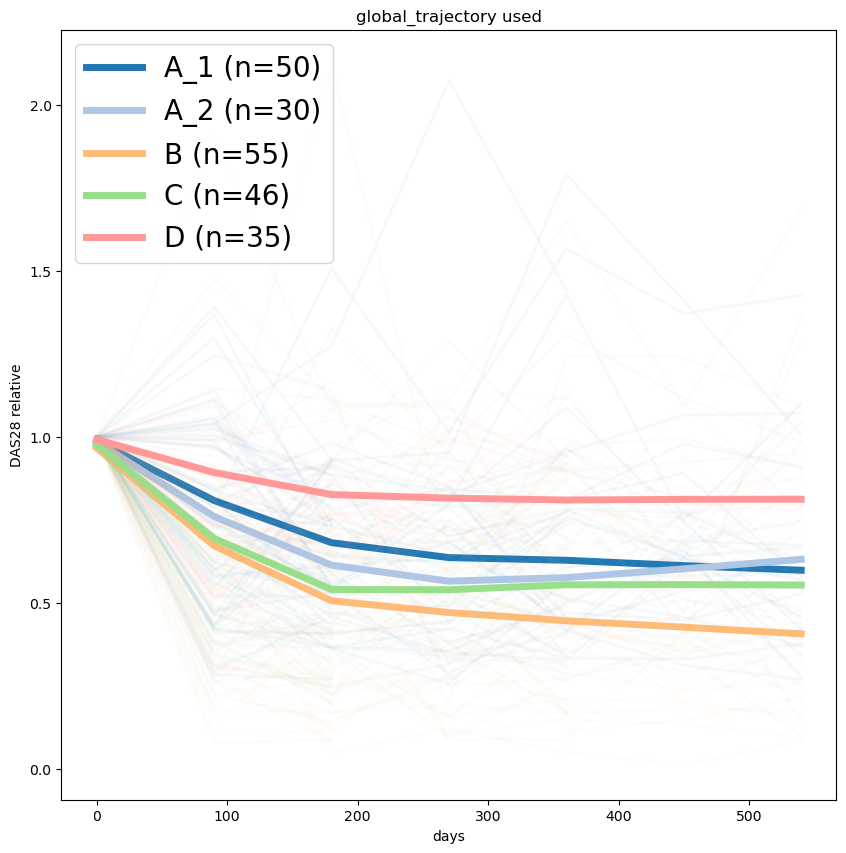

In [172]:


#colormap = {1:"red",2:"grey",3:"blue",4:"purple",5:"green",6:"orange",7:"yellow"}
cmap = mpl.colormaps['Set1']

plot_clusters(data_use, "DAS28 relative", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
plt.title("global_trajectory used") 
#plt.ylim((0,40))
#plt.xlim((0,550))
#plt.hlines(3.3, xmin=0,xmax=data_cluster_plot.days.max(), color="black", label="remision")

In [173]:
data_use.query("months == 15").groupby("global_trajectory")["Metrologist's score"].describe()

,count,mean,std,min,25%,50%,75%,max
global_trajectory,,,,,,,,
A_1,20.0,0.562500,0.555327,0.00,0.1250,0.4375,0.87500,1.750
A_2,14.0,0.687500,0.506567,0.00,0.3125,0.6875,0.87500,1.750
B,23.0,0.538043,0.701495,0.00,0.0000,0.1250,1.18750,1.875
C,18.0,0.618056,0.650893,0.00,0.0000,0.4375,1.15625,1.750
D,11.0,1.272727,0.693312,0.25,0.8750,1.3750,1.87500,2.125


In [174]:
data_use["remision"] = data_use.DAS28 < 2.6

In [175]:
data_use.groupby("PATNR")[["global_trajectory","remision"]].max().groupby("global_trajectory").remision.mean()

global_trajectory
A_1    0.560000
A_2    0.700000
B      0.836364
C      0.869565
D      0.200000
Name: remision, dtype: float64

In [176]:
data_use.query("months == 12")["DAS28 relative"].describe()

count    147.000000
mean       0.632898
std        0.318249
min        0.048110
25%        0.416505
50%        0.578415
75%        0.847978
max        1.789809
Name: DAS28 relative, dtype: float64

In [177]:
data_use.columns

Index(['PATNR', 'months', 'Study', 'Age', 'Race', 'Sex', 'Weight',
       'Date of Assessment', 'Date of symptom onset', 'Final Score', 'RF',
       'acpa', 'acpa_value', 'rf_value', 'ACPA Value', 'Basophils',
       'CRP Value (mg/L)', 'DAS-28 CRP', 'DAS28', 'DAS28 relative',
       'ESR Value', 'Eosinophils', 'Evaluator global', 'Fatique', 'GL', 'Gdl',
       'HB', 'Lymphocytes', 'Metrologist's score', 'Monocytes', 'Neutrophils',
       'Outside 2 week window', 'PLT', 'Pain score', 'Patient global',
       'RF Unit', 'RF Value', 'SDAI <= 3.3', 'SDAI score',
       'Total 66/68 Swollen Joints', 'Total 66/68 Tender Joints',
       'Total Swollen', 'Total Tender', 'Use of sign '<'', 'WBC', 'Adalimumab',
       'Certolizumab', 'Dexamethasone', 'Etanercept', 'Folic Acid',
       'Golimumab', 'Hydroxychloroquine', 'Leflunomide', 'Methotrexate',
       'Methylprednisolone', 'Methylprednisolone Acetate', 'Prednisolone',
       'Sulfasalazine', 'Tocilizumab', 'Triamcinolone (Kenalog)', 'days'

In [178]:
traject_data = data_use.groupby("PATNR").head(1)[["PATNR","global_trajectory"]]
traject_data

,PATNR,global_trajectory
0,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,A_1
7,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,B
14,016BBC0766785143D12B9EEE5B3B9DDA4C0C850D720120...,A_1
21,026A123E54047C669FA3C239D3D89ECC817437B0FE8CA1...,A_2
28,036A2E585D2906AA2EE0114C9F34B066DCF0C9107F4AF0...,A_2
...,...,...
1477,FA8F7566A07AECD6E12FFC518489802DEA9C44ECB18FD7...,C
1484,FCF14F3AAA87DE5EF1B23F0C26DC69BFEADC5A135BD06D...,C
1491,FF18BE7F07D2B832CC6434ECF110D30F786D776F0A9E1F...,D
1498,FF316CBA26DD9BC1E0575F0930ECE7A0F15F9D2B3FED6C...,A_2


In [179]:
add_data = pd.read_csv(data_dir +f"TACERA_data_add_2024-03-26.csv")
print(add_data.columns)
add_data = add_data.merge(traject_data, left_on='Subject ID', right_on=["PATNR"])

Index(['Subject ID', '\RAMAP\RAMAP\XRAY\Annualised Progression\',
       '\RAMAP\RAMAP\XRAY\Erosive\', '\RAMAP\RAMAP\XRAY\Final Score\',
       '\RAMAP\RAMAP\XRAY\Initial Score\',
       '\RAMAP\RAMAP\XRAY\Only 6 Month X-Rays\',
       '\RAMAP\RAMAP\XRAY\Unadjusted Progression\',
       '\RAMAP\RAMAP\Subjects\Demographics\Age\',
       '\RAMAP\RAMAP\Subjects\Demographics\Height\',
       '\RAMAP\RAMAP\Subjects\Demographics\Race\',
       '\RAMAP\RAMAP\Subjects\Demographics\Sex\',
       '\RAMAP\RAMAP\Subjects\Demographics\Weight\',
       '\RAMAP\RAMAP\Subjects\Medical History\Alcohol History\Consumption frequency\',
       '\RAMAP\RAMAP\Subjects\Medical History\Alcohol History\Drinks alcohol\',
       '\RAMAP\RAMAP\Subjects\Medical History\Alcohol History\Units of alcohol consumption per week (if over 20)\',
       '\RAMAP\RAMAP\Subjects\Medical History\Alcohol History\Units of alcohol consumption per week Range\',
       '\RAMAP\RAMAP\Subjects\Medical History\Alcohol History\Units of

In [180]:
cols_names =  add_data.columns[1:-2].str.rsplit("\\").str[-2]
cols_names = [add_data.columns[0]] + list(cols_names) + list(add_data.columns[-2:])
add_data.columns = cols_names
add_data

,Subject ID,Annualised Progression,Erosive,Final Score,Initial Score,Only 6 Month X-Rays,Unadjusted Progression,Age,Height,Race,...,If previous or current smoker Other Type,If previous or current smoker Type,If previous smoker date stopped smoking,Number of cigarettes per day,Number of years smoked,Smoking status,Date of Report,Enrollment,PATNR,global_trajectory
0,0A0B0E97239BE7AB5F473C8C046A69142C2213BC4ABADC...,NaN,NaN,NaN,NaN,NaN,NaN,26,180.0,White- British,...,NaN,NaN,NaN,NaN,NaN,Never Smoked,6/22/2015,Withdrawn -lost to follow up,0A0B0E97239BE7AB5F473C8C046A69142C2213BC4ABADC...,C
1,747FC68D04F159A9D79B21F8228350946727DCD2E3C966...,0.0,False,1.0,1.0,False,0.0,48,292.0,White- British,...,NaN,Cigarrette,NaN,5.0,30.0,Current Smoker,4/16/2015,Completed,747FC68D04F159A9D79B21F8228350946727DCD2E3C966...,B
2,F7347C9F21B34DCE309FEDEFE6C3C8C4FFDA7B339BEBCB...,1.0,True,11.0,11.0,False,1.0,51,179.0,White- British,...,NaN,Hand-rolled tobacco,1985-1-1,6.0,4.0,Previous Smoker,2/20/2015,Completed,F7347C9F21B34DCE309FEDEFE6C3C8C4FFDA7B339BEBCB...,C
3,1D64D145CB205919CFE0070487BC628EFA2D08E7AA7AB3...,0.0,False,0.0,0.0,False,0.0,28,165.0,Asian or Asian British - Bangladeshi,...,NaN,NaN,NaN,NaN,NaN,Never Smoked,1/27/2015,Completed,1D64D145CB205919CFE0070487BC628EFA2D08E7AA7AB3...,B
4,3A9C04CAA9BBAAE16A20614D827FA3B55AA09C94F69284...,1.0,False,1.0,0.0,False,1.0,43,172.0,Black or Black British - Caribbean,...,NaN,NaN,NaN,NaN,NaN,Never Smoked,3/13/2015,Completed,3A9C04CAA9BBAAE16A20614D827FA3B55AA09C94F69284...,B
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211,73E3E20E931D3832BAA8D3AAFC90DA30140BFE8E4D2F67...,3.0,False,24.0,21.0,False,3.0,73,156.0,White- British,...,NaN,Cigarrette,1981-1-1,1.0,21.0,Previous Smoker,12/8/2015,Completed,73E3E20E931D3832BAA8D3AAFC90DA30140BFE8E4D2F67...,A_1
212,D101FCDEB12001A9081FCF64FF858157276AAC74CF7B00...,0.0,False,0.0,0.0,False,0.0,33,162.0,White- British,...,NaN,Hand-rolled tobacco,2006-24-4,6.0,12.0,Previous Smoker,12/2/2015,Completed,D101FCDEB12001A9081FCF64FF858157276AAC74CF7B00...,B
213,A029055653371689A0FAF774AB7B9B07FCCB0671A6030F...,2.0,False,14.0,12.0,False,2.0,69,160.0,White- British,...,NaN,Cigarrette,1964-1-1,1.0,3.0,Previous Smoker,2015-25-11,Completed,A029055653371689A0FAF774AB7B9B07FCCB0671A6030F...,B
214,9BFE0604CD4F53CBF89EDF95353DD57D4EE442829DABA3...,0.0,False,0.0,0.0,False,0.0,44,166.0,White- British,...,NaN,NaN,NaN,NaN,NaN,Never Smoked,2015-14-10,Completed,9BFE0604CD4F53CBF89EDF95353DD57D4EE442829DABA3...,A_2


In [181]:
add_data.loc[1,"Height"] = 192
add_data[['Height', 'Weight']] = add_data[['Height', 'Weight']].astype(float)
add_data["BMI"] = add_data.Weight /((add_data.Height/100)**2)
add_data.Weight, add_data.Height, add_data.BMI

(0      88.0
 1      79.5
 2      75.7
 3      95.9
 4      90.0
        ... 
 211    61.0
 212    95.0
 213    62.8
 214    79.5
 215    73.9
 Name: Weight, Length: 216, dtype: float64,
 0      180.0
 1      192.0
 2      179.0
 3      165.0
 4      172.0
        ...  
 211    156.0
 212    162.0
 213    160.0
 214    166.0
 215    167.0
 Name: Height, Length: 216, dtype: float64,
 0      27.160494
 1      21.565755
 2      23.625979
 3      35.224977
 4      30.421850
          ...    
 211    25.065746
 212    36.198750
 213    24.531250
 214    28.850341
 215    26.497902
 Name: BMI, Length: 216, dtype: float64)

In [182]:
add_data.columns

Index(['Subject ID', 'Annualised Progression', 'Erosive', 'Final Score',
       'Initial Score', 'Only 6 Month X-Rays', 'Unadjusted Progression', 'Age',
       'Height', 'Race', 'Sex', 'Weight', 'Consumption frequency',
       'Drinks alcohol', 'Units of alcohol consumption per week (if over 20)',
       'Units of alcohol consumption per week Range',
       'Units of alcohol consumption per week',
       'Any intramuscular steroid injections',
       'Corticosteroid treatment for current episode',
       'DMARD and TNF inhibitor naive', 'Date of Assessment',
       'Date of symptom onset', 'If previous or current smoker Other Type',
       'If previous or current smoker Type',
       'If previous smoker date stopped smoking',
       'Number of cigarettes per day', 'Number of years smoked',
       'Smoking status', 'Date of Report', 'Enrollment', 'PATNR',
       'global_trajectory', 'BMI'],
      dtype='object')

In [183]:
add_data

,Subject ID,Annualised Progression,Erosive,Final Score,Initial Score,Only 6 Month X-Rays,Unadjusted Progression,Age,Height,Race,...,If previous or current smoker Type,If previous smoker date stopped smoking,Number of cigarettes per day,Number of years smoked,Smoking status,Date of Report,Enrollment,PATNR,global_trajectory,BMI
0,0A0B0E97239BE7AB5F473C8C046A69142C2213BC4ABADC...,NaN,NaN,NaN,NaN,NaN,NaN,26,180.0,White- British,...,NaN,NaN,NaN,NaN,Never Smoked,6/22/2015,Withdrawn -lost to follow up,0A0B0E97239BE7AB5F473C8C046A69142C2213BC4ABADC...,C,27.160494
1,747FC68D04F159A9D79B21F8228350946727DCD2E3C966...,0.0,False,1.0,1.0,False,0.0,48,192.0,White- British,...,Cigarrette,NaN,5.0,30.0,Current Smoker,4/16/2015,Completed,747FC68D04F159A9D79B21F8228350946727DCD2E3C966...,B,21.565755
2,F7347C9F21B34DCE309FEDEFE6C3C8C4FFDA7B339BEBCB...,1.0,True,11.0,11.0,False,1.0,51,179.0,White- British,...,Hand-rolled tobacco,1985-1-1,6.0,4.0,Previous Smoker,2/20/2015,Completed,F7347C9F21B34DCE309FEDEFE6C3C8C4FFDA7B339BEBCB...,C,23.625979
3,1D64D145CB205919CFE0070487BC628EFA2D08E7AA7AB3...,0.0,False,0.0,0.0,False,0.0,28,165.0,Asian or Asian British - Bangladeshi,...,NaN,NaN,NaN,NaN,Never Smoked,1/27/2015,Completed,1D64D145CB205919CFE0070487BC628EFA2D08E7AA7AB3...,B,35.224977
4,3A9C04CAA9BBAAE16A20614D827FA3B55AA09C94F69284...,1.0,False,1.0,0.0,False,1.0,43,172.0,Black or Black British - Caribbean,...,NaN,NaN,NaN,NaN,Never Smoked,3/13/2015,Completed,3A9C04CAA9BBAAE16A20614D827FA3B55AA09C94F69284...,B,30.421850
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211,73E3E20E931D3832BAA8D3AAFC90DA30140BFE8E4D2F67...,3.0,False,24.0,21.0,False,3.0,73,156.0,White- British,...,Cigarrette,1981-1-1,1.0,21.0,Previous Smoker,12/8/2015,Completed,73E3E20E931D3832BAA8D3AAFC90DA30140BFE8E4D2F67...,A_1,25.065746
212,D101FCDEB12001A9081FCF64FF858157276AAC74CF7B00...,0.0,False,0.0,0.0,False,0.0,33,162.0,White- British,...,Hand-rolled tobacco,2006-24-4,6.0,12.0,Previous Smoker,12/2/2015,Completed,D101FCDEB12001A9081FCF64FF858157276AAC74CF7B00...,B,36.198750
213,A029055653371689A0FAF774AB7B9B07FCCB0671A6030F...,2.0,False,14.0,12.0,False,2.0,69,160.0,White- British,...,Cigarrette,1964-1-1,1.0,3.0,Previous Smoker,2015-25-11,Completed,A029055653371689A0FAF774AB7B9B07FCCB0671A6030F...,B,24.531250
214,9BFE0604CD4F53CBF89EDF95353DD57D4EE442829DABA3...,0.0,False,0.0,0.0,False,0.0,44,166.0,White- British,...,NaN,NaN,NaN,NaN,Never Smoked,2015-14-10,Completed,9BFE0604CD4F53CBF89EDF95353DD57D4EE442829DABA3...,A_2,28.850341


In [184]:
add_data.fillna(0).groupby("global_trajectory")["Annualised Progression"].mean()

global_trajectory
A_1    1.380000
A_2    0.433333
B      0.490909
C      0.739130
D      0.657143
Name: Annualised Progression, dtype: float64

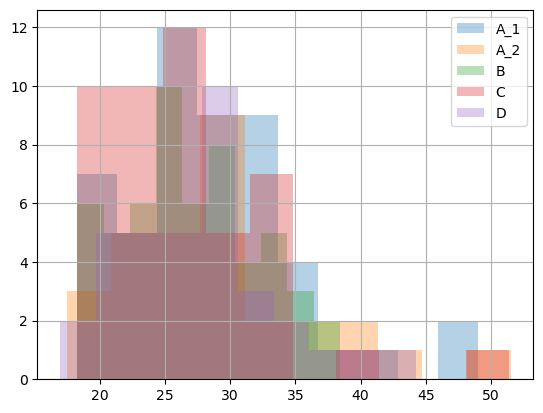

In [185]:
ax = add_data.groupby("global_trajectory").BMI.hist(alpha=0.333, legend=True)#.plot.pie(subplots=True,)
plt.legend()

In [186]:
add_data.groupby("global_trajectory").BMI.describe()

,count,mean,std,min,25%,50%,75%,max
global_trajectory,,,,,,,,
A_1,50.0,28.720793,6.365169,18.292011,25.147951,27.758507,31.615448,48.979592
A_2,30.0,29.269945,7.389134,17.505615,24.096806,28.855795,31.792564,51.523388
B,55.0,26.997293,5.089973,18.285714,23.817061,26.484375,30.208328,38.424271
C,46.0,26.698030,6.059283,18.256319,22.273393,26.044545,29.150192,51.357733
D,35.0,27.603989,5.915394,16.964429,22.868382,28.145449,30.482326,44.256055


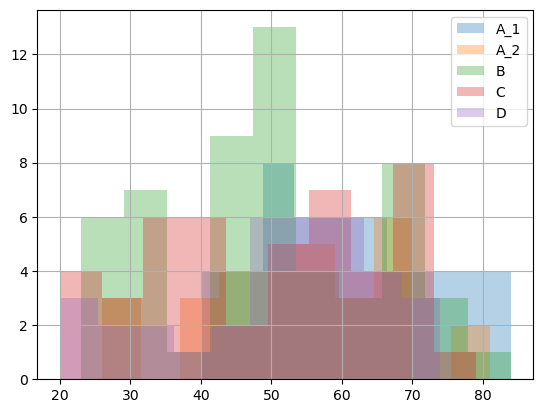

In [187]:
ax = add_data.groupby("global_trajectory").Age.hist(alpha=0.333, legend=True)#.plot.pie(subplots=True,)
plt.legend()

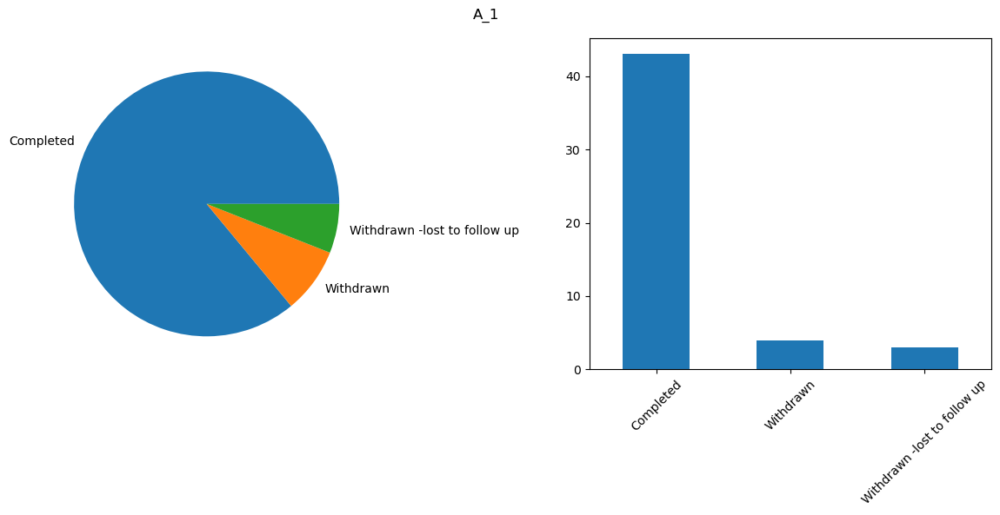

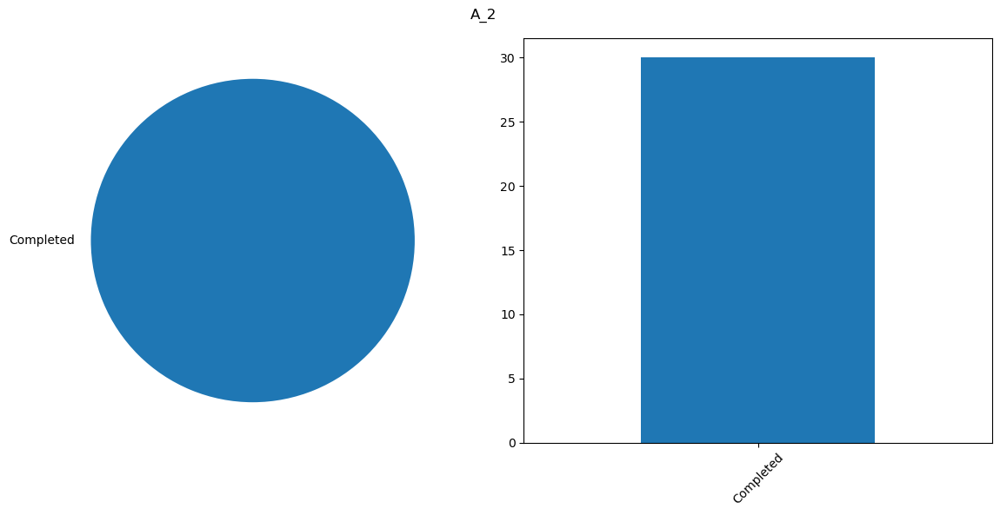

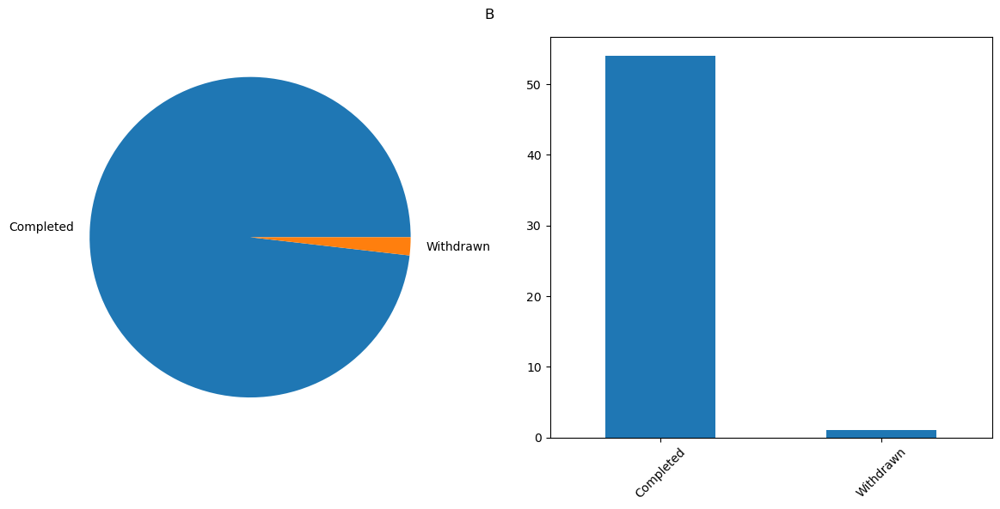

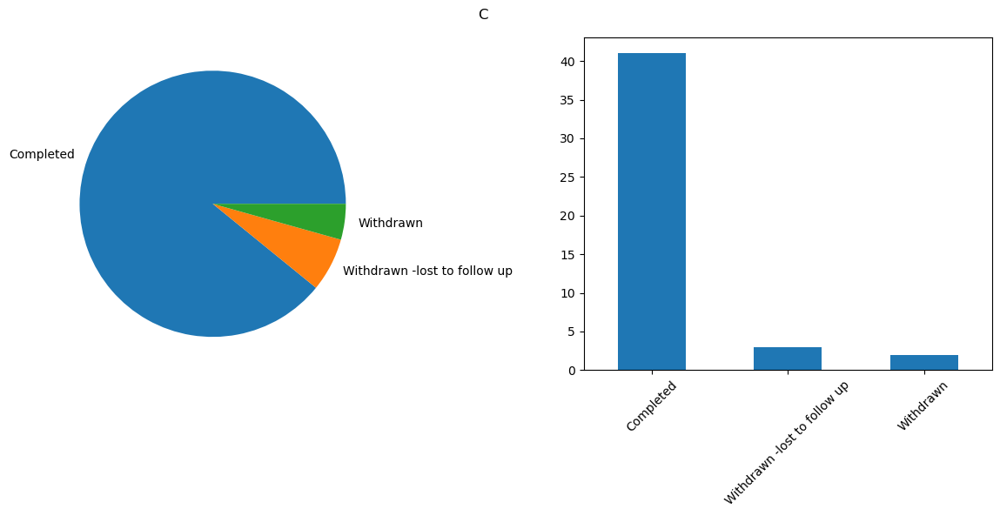

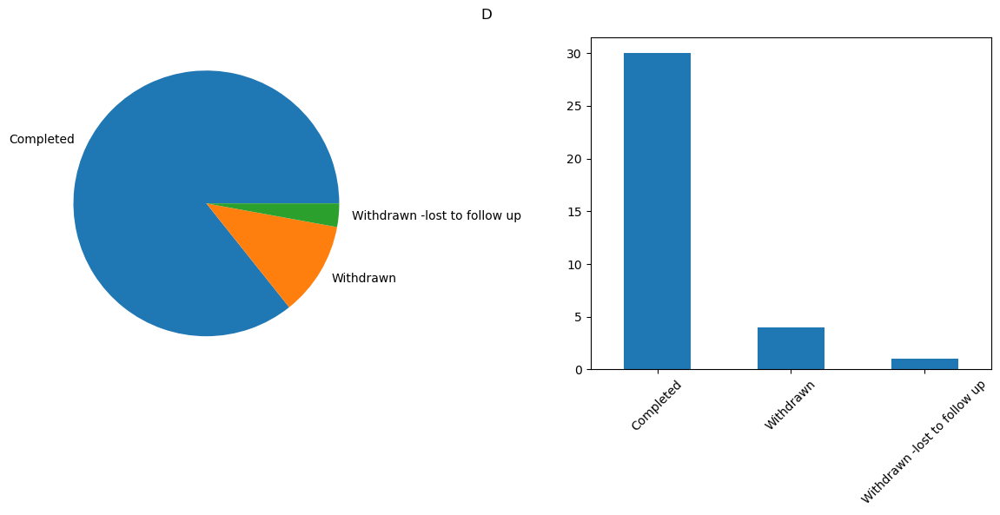

global_trajectory  Enrollment                  
A_1                Completed                       43
                   Withdrawn                        4
                   Withdrawn -lost to follow up     3
A_2                Completed                       30
B                  Completed                       54
                   Withdrawn                        1
C                  Completed                       41
                   Withdrawn -lost to follow up     3
                   Withdrawn                        2
D                  Completed                       30
                   Withdrawn                        4
                   Withdrawn -lost to follow up     1
Name: count, dtype: int64

In [188]:
a = add_data.groupby("global_trajectory")["Enrollment"].value_counts()#.plot.pie(subplots=True,)
for cat1, subdf in a.groupby(level='global_trajectory'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    subdf.loc[cat1, :].plot.pie(y='count', ax=ax1, ylabel='', legend=False)
    subdf.loc[cat1, :].plot.bar(y='%', ax=ax2, rot=45, xlabel='', legend=False)
    fig.suptitle(cat1)
    fig.tight_layout()
    plt.show()
a

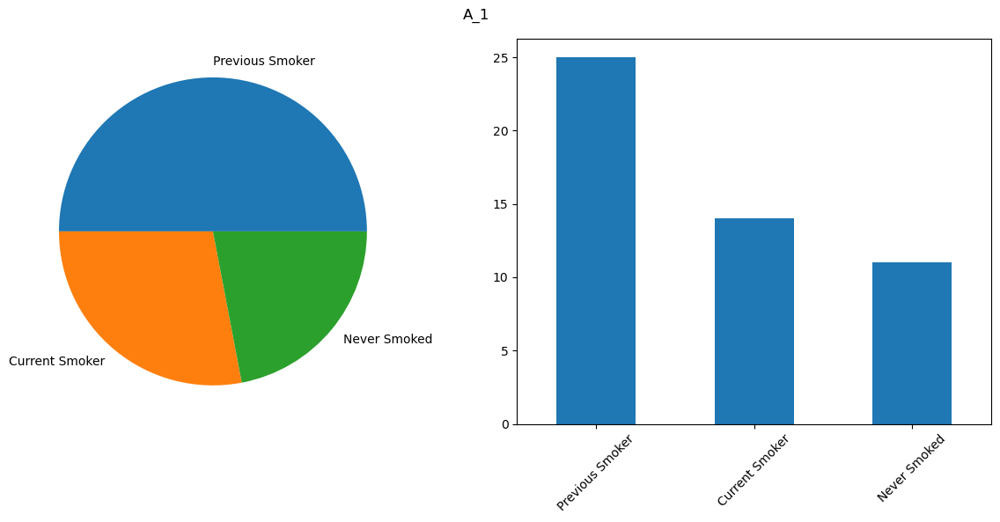

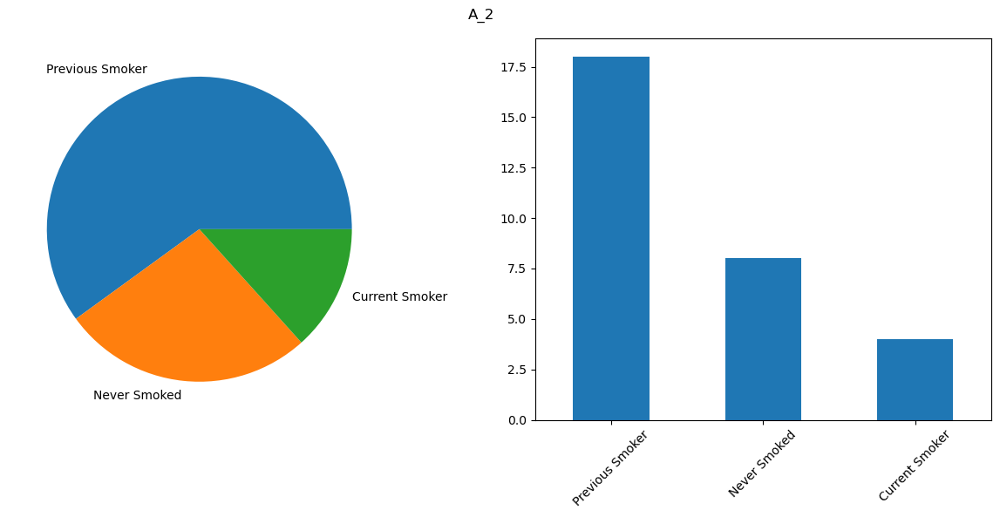

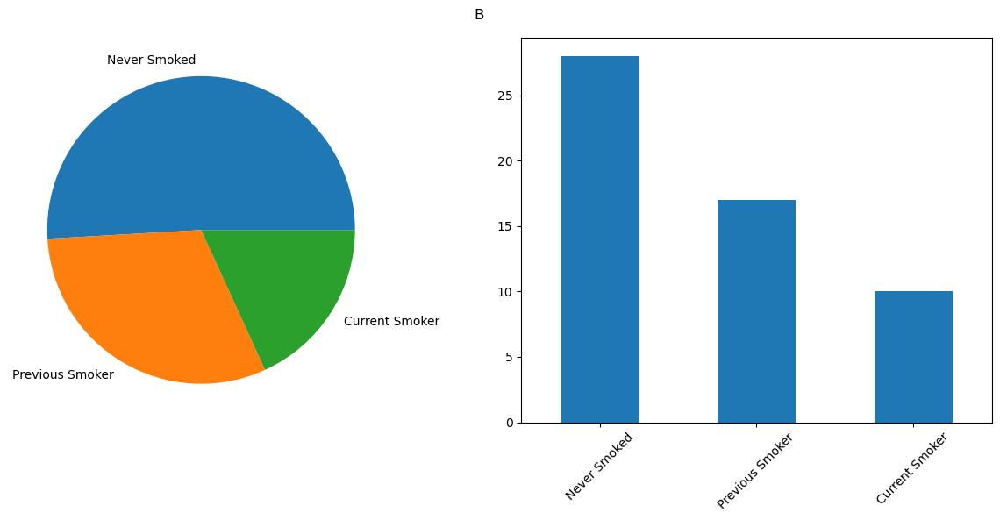

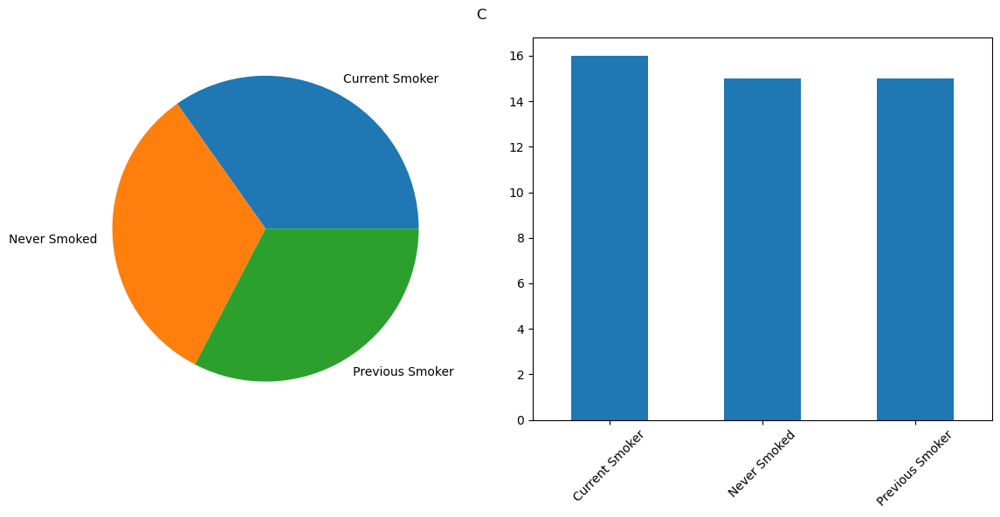

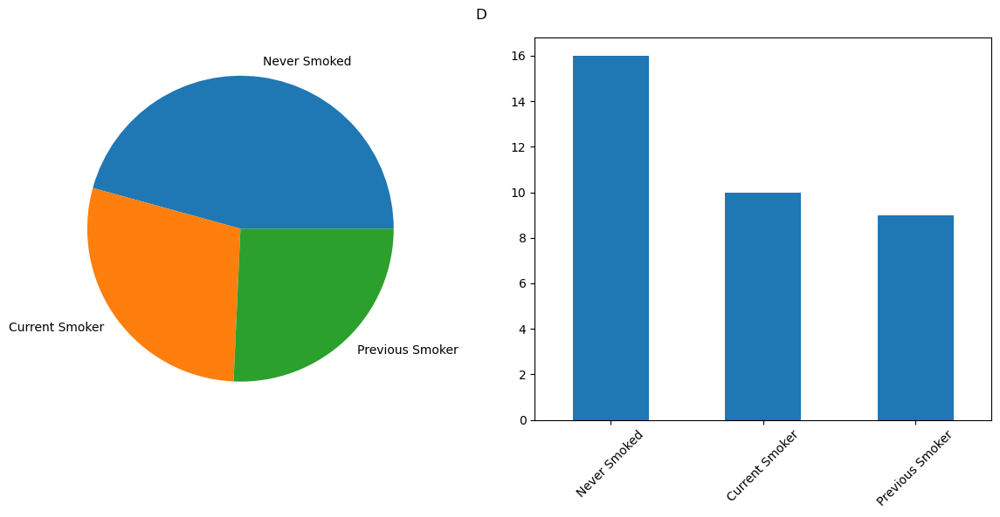

In [189]:
a = add_data.groupby("global_trajectory")["Smoking status"].value_counts()#.plot.pie(subplots=True,)
for cat1, subdf in a.groupby(level='global_trajectory'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    subdf.loc[cat1, :].plot.pie(y='count', ax=ax1, ylabel='', legend=False)
    subdf.loc[cat1, :].plot.bar(y='%', ax=ax2, rot=45, xlabel='', legend=False)
    fig.suptitle(cat1)
    fig.tight_layout()
    plt.show()

In [190]:
a = add_data.groupby("global_trajectory")["If previous or current smoker Type"].value_counts()#.plot.pie(subplots=True,)
a

global_trajectory  If previous or current smoker Type
A_1                Cigarrette                            33
                   Hand-rolled tobacco                    4
                   Cigar                                  2
A_2                Cigarrette                            21
                   Hand-rolled tobacco                    1
B                  Cigarrette                            24
                   Hand-rolled tobacco                    3
C                  Cigarrette                            26
                   Hand-rolled tobacco                    5
D                  Cigarrette                            17
                   Hand-rolled tobacco                    2
Name: count, dtype: int64

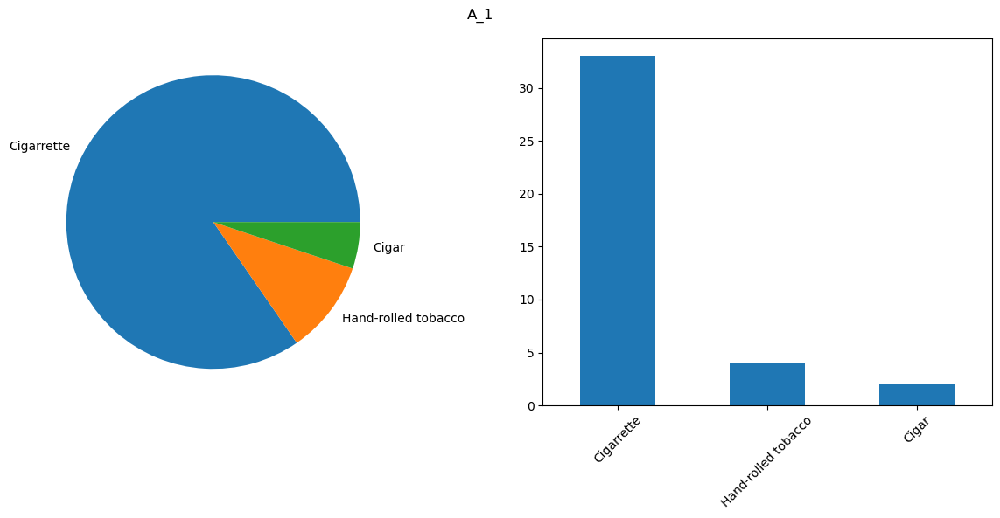

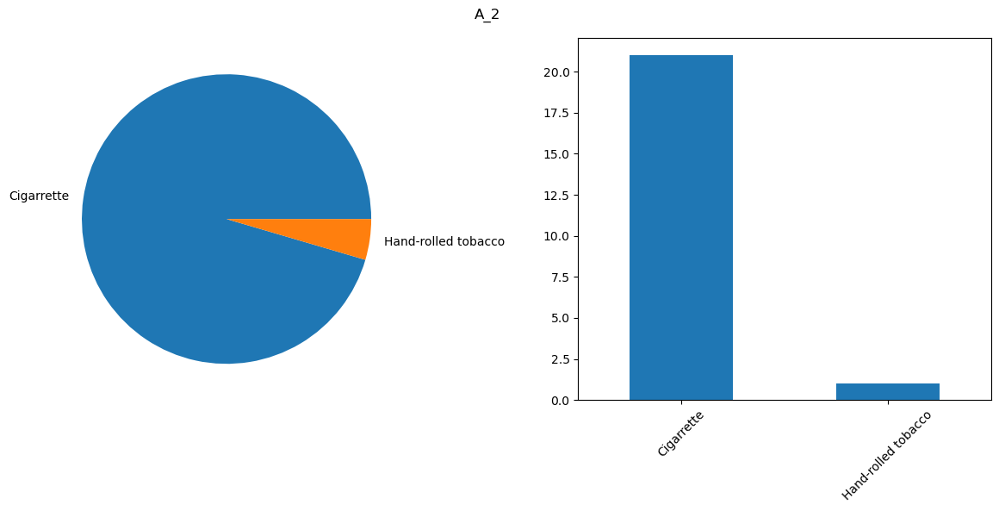

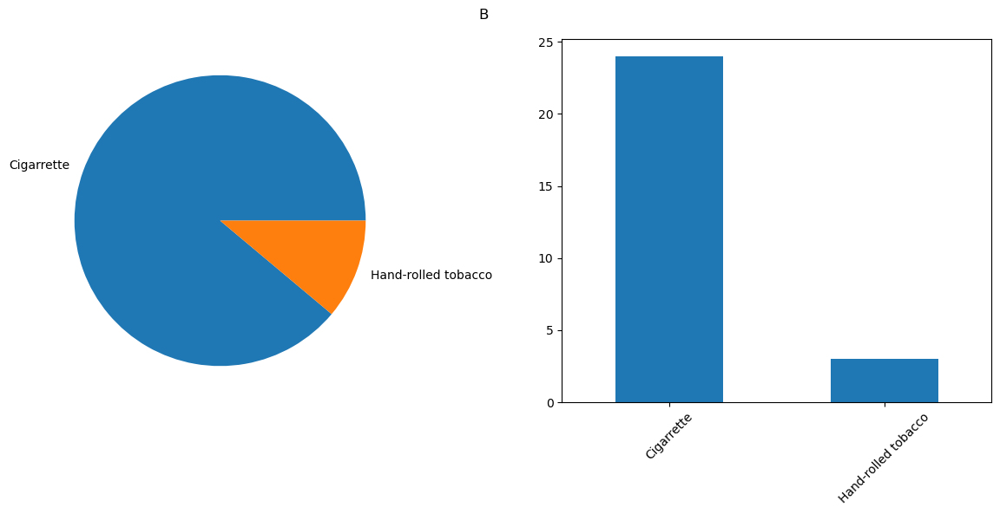

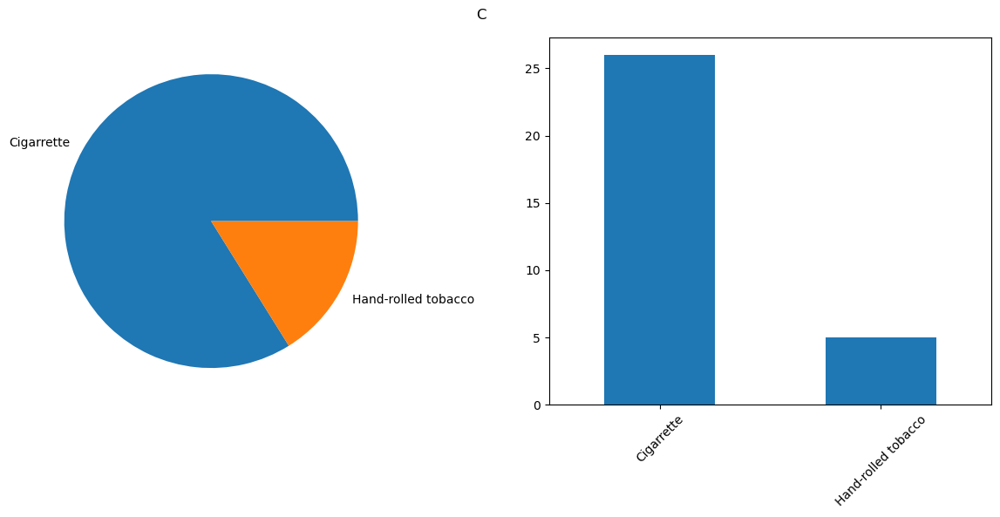

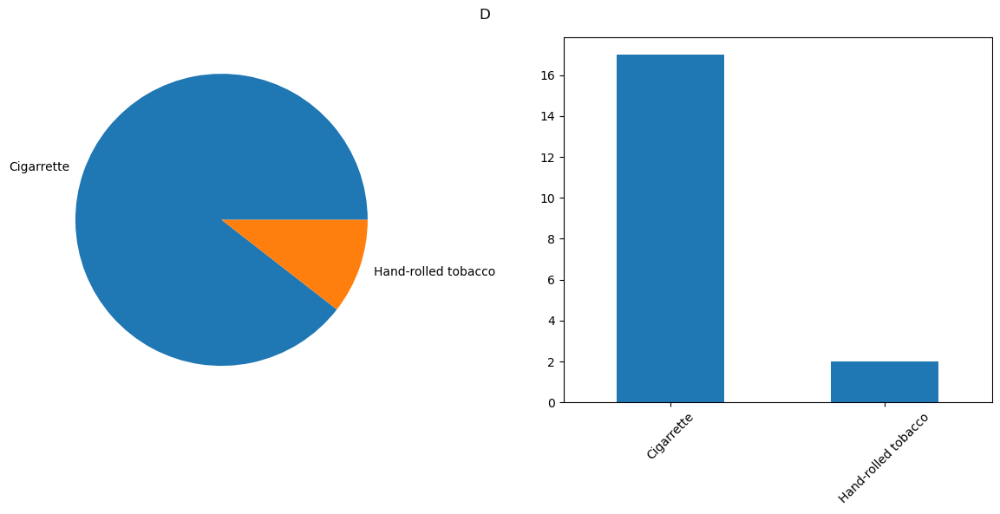

In [191]:
for cat1, subdf in a.groupby(level='global_trajectory'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    subdf.loc[cat1, :].plot.pie(y='count', ax=ax1, ylabel='', legend=False)
    subdf.loc[cat1, :].plot.bar(y='%', ax=ax2, rot=45, xlabel='', legend=False)
    fig.suptitle(cat1)
    fig.tight_layout()
    plt.show()

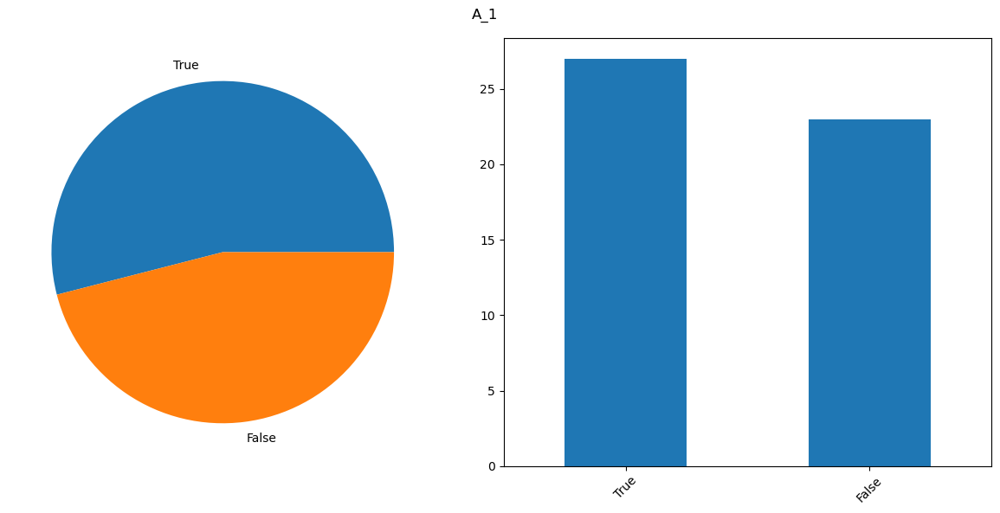

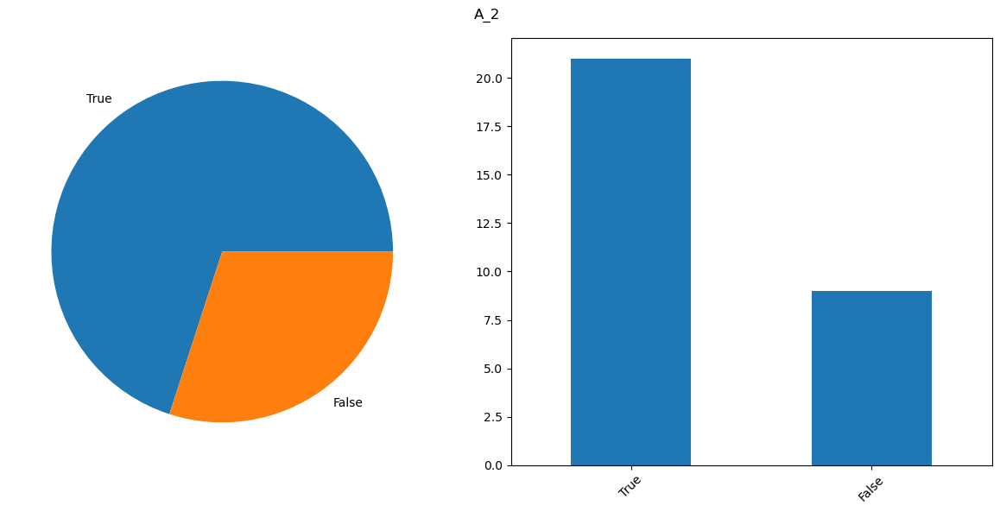

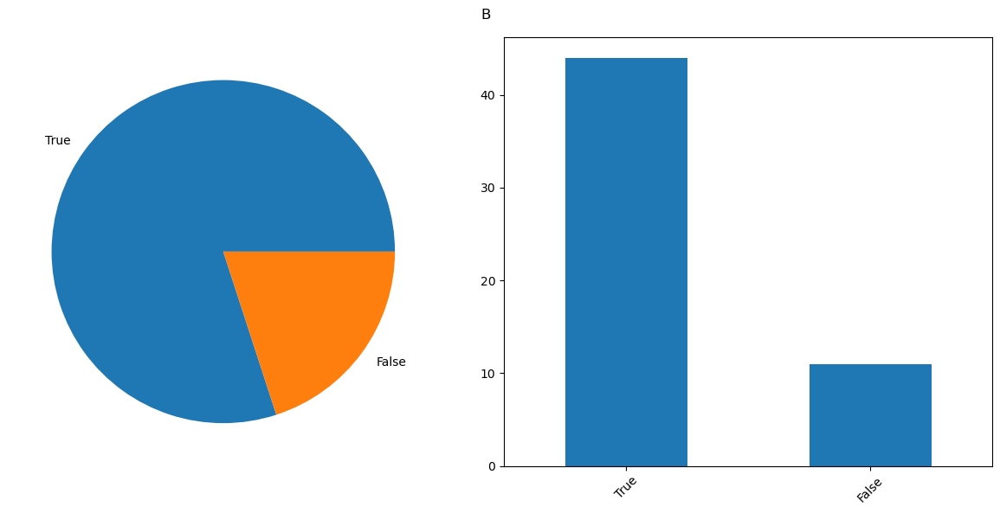

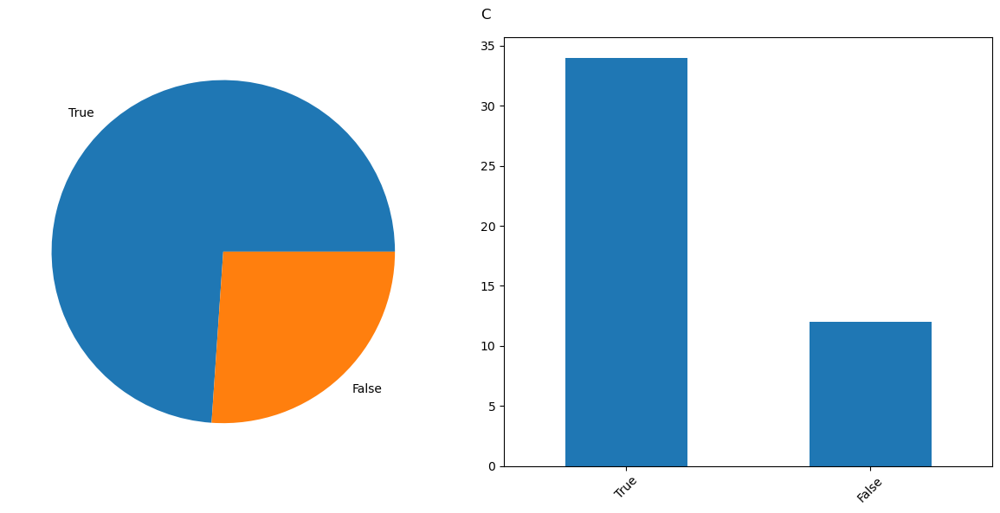

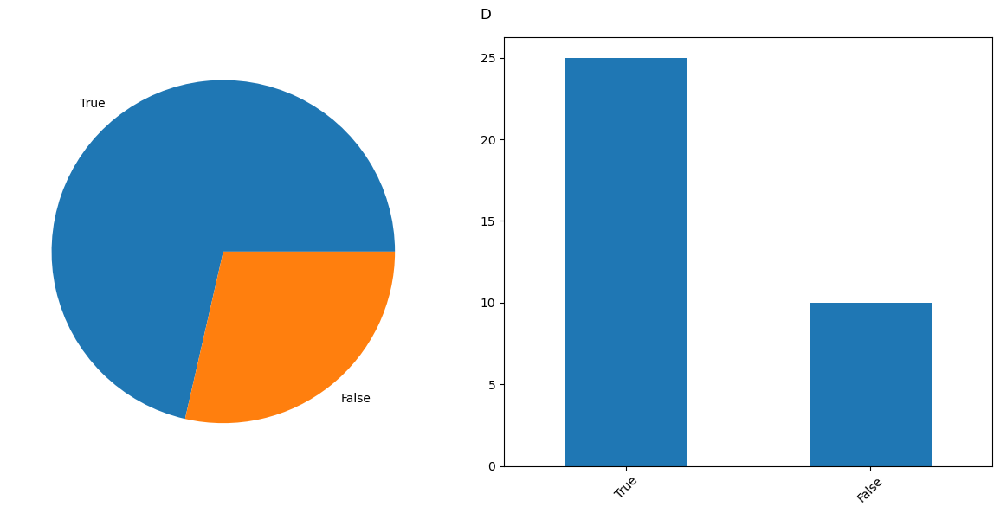

In [192]:
a = add_data.groupby("global_trajectory")["Drinks alcohol"].value_counts()#.plot.pie(subplots=True,)
for cat1, subdf in a.groupby(level='global_trajectory'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    subdf.loc[cat1, :].plot.pie(y='count', ax=ax1, ylabel='', legend=False)
    subdf.loc[cat1, :].plot.bar(y='%', ax=ax2, rot=45, xlabel='', legend=False)
    fig.suptitle(cat1)
    fig.tight_layout()
    plt.show()

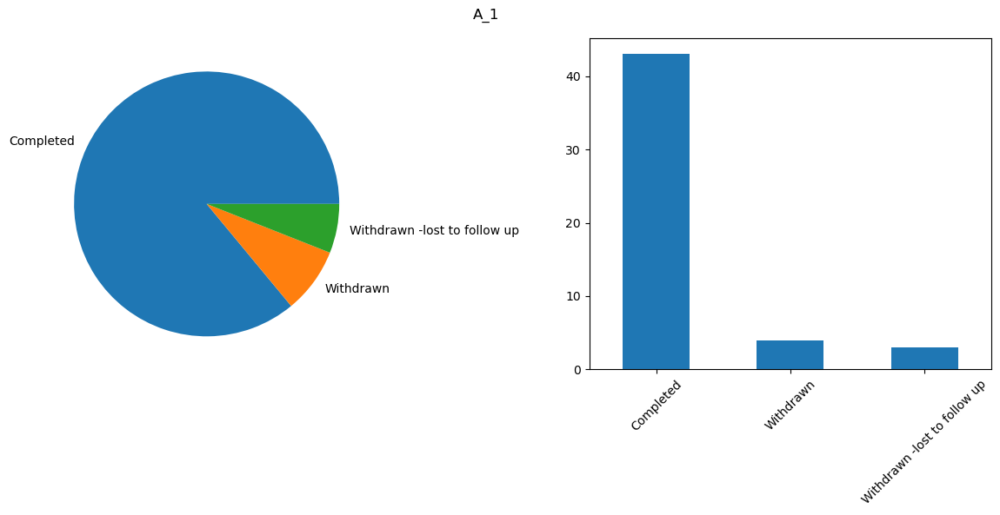

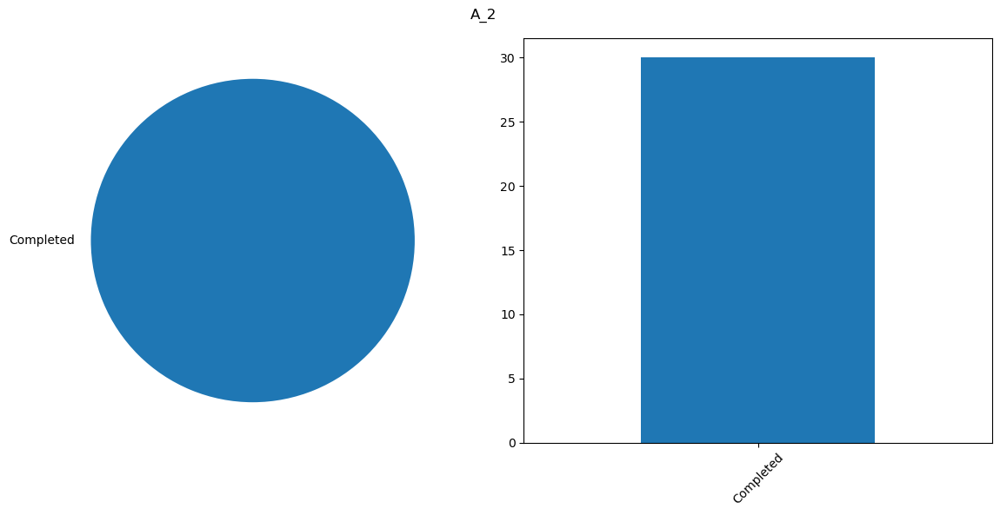

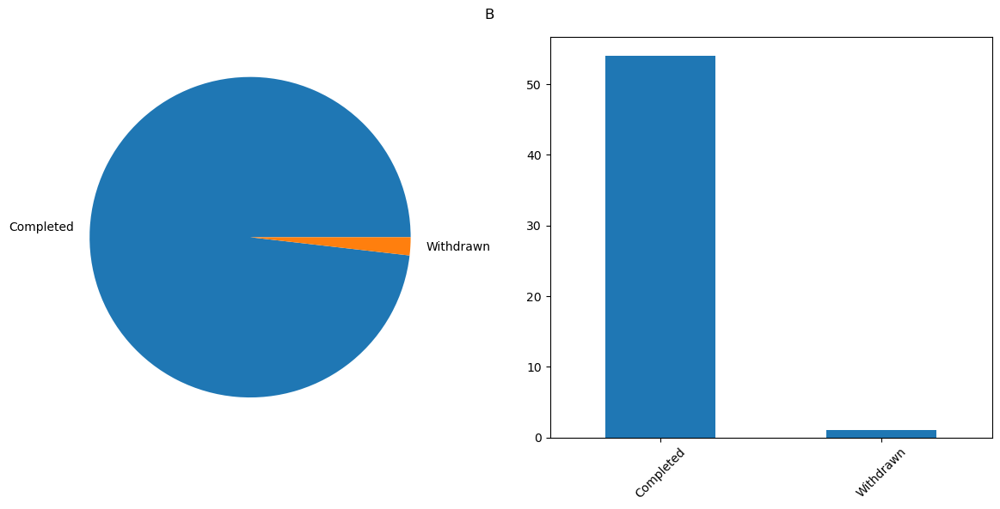

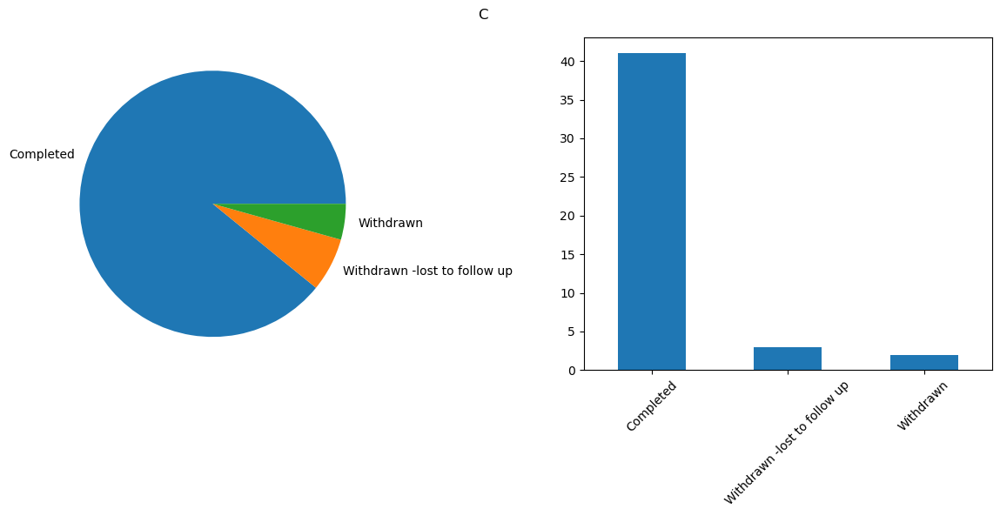

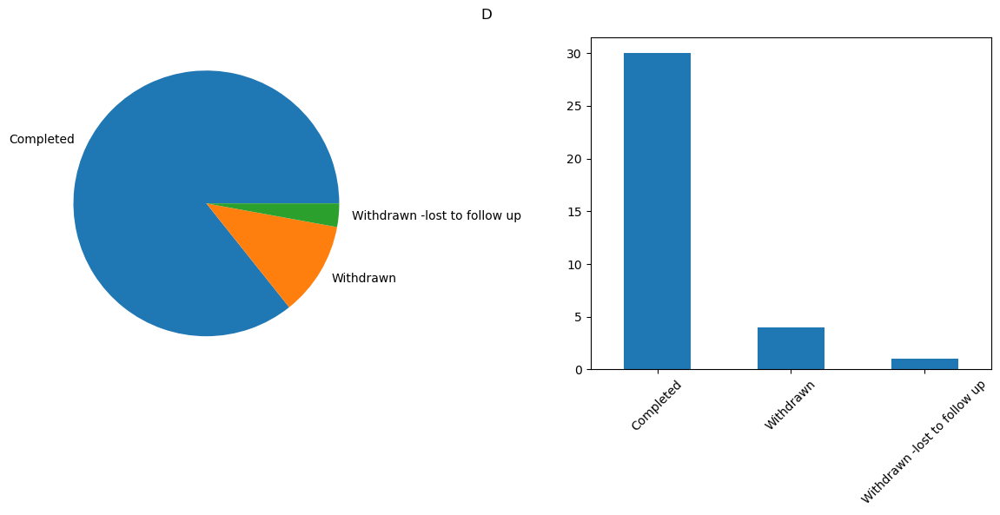

In [193]:
a = add_data.groupby("global_trajectory")["Enrollment"].value_counts()#.plot.pie(subplots=True,)
for cat1, subdf in a.groupby(level='global_trajectory'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    subdf.loc[cat1, :].plot.pie(y='count', ax=ax1, ylabel='', legend=False)
    subdf.loc[cat1, :].plot.bar(y='%', ax=ax2, rot=45, xlabel='', legend=False)
    fig.suptitle(cat1)
    fig.tight_layout()
    plt.show()

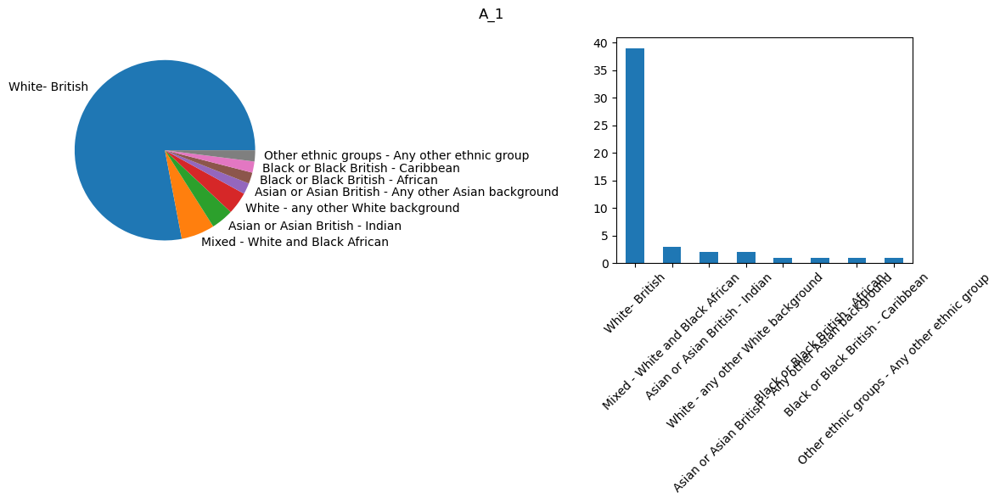

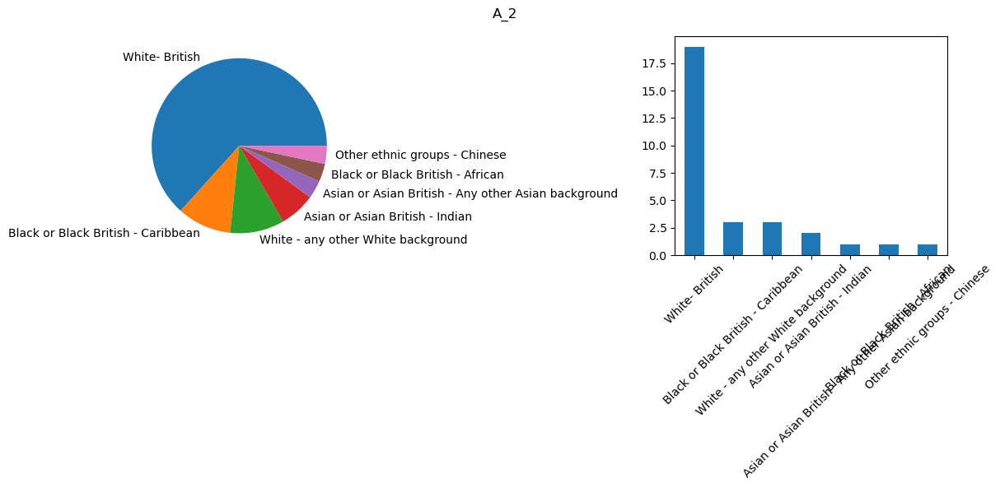

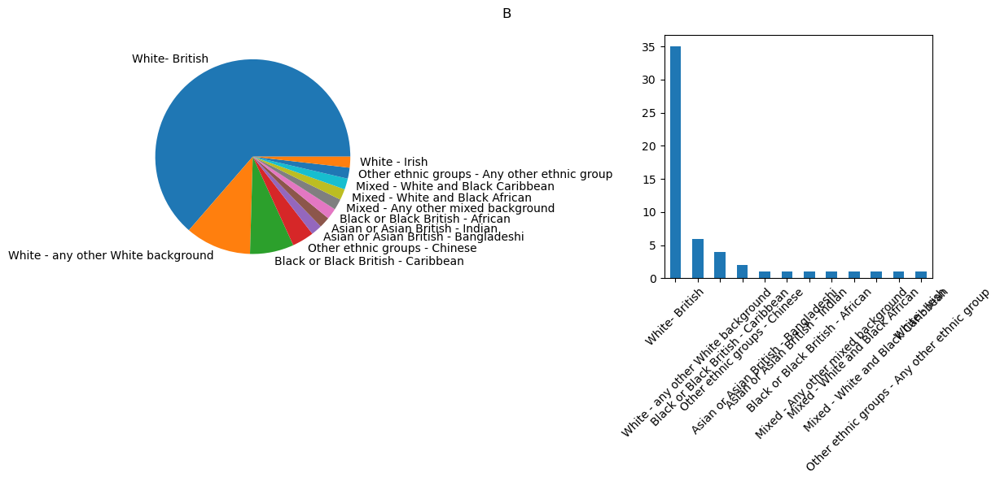

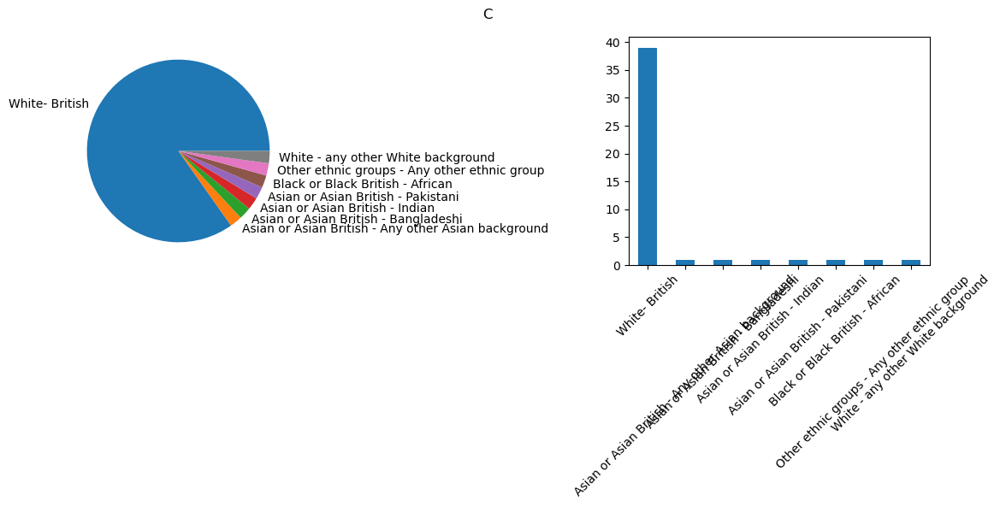

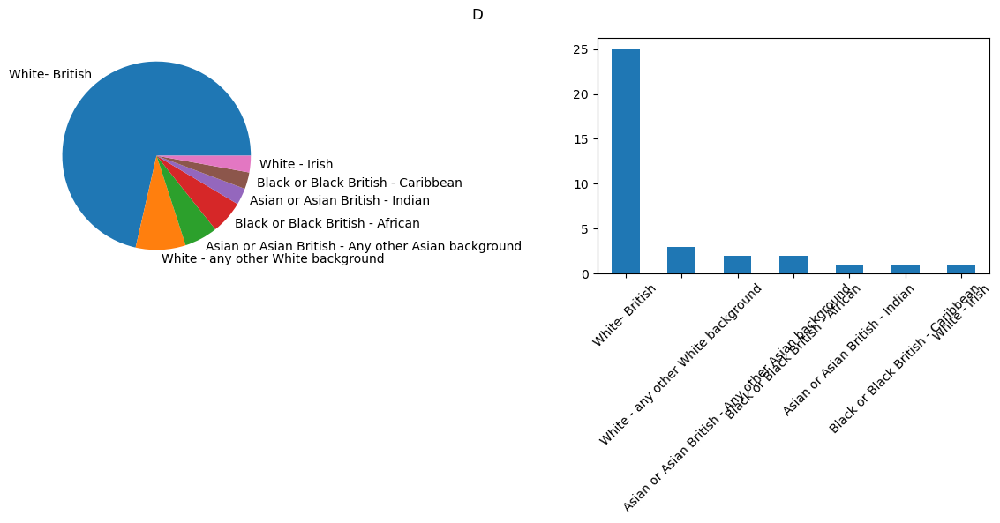

In [194]:
a = add_data.groupby("global_trajectory")["Race"].value_counts()#.plot.pie(subplots=True,)
for cat1, subdf in a.groupby(level='global_trajectory'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    subdf.loc[cat1, :].plot.pie(y='count', ax=ax1, ylabel='', legend=False)
    subdf.loc[cat1, :].plot.bar(y='%', ax=ax2, rot=45, xlabel='', legend=False)
    fig.suptitle(cat1)
    fig.tight_layout()
    plt.show()

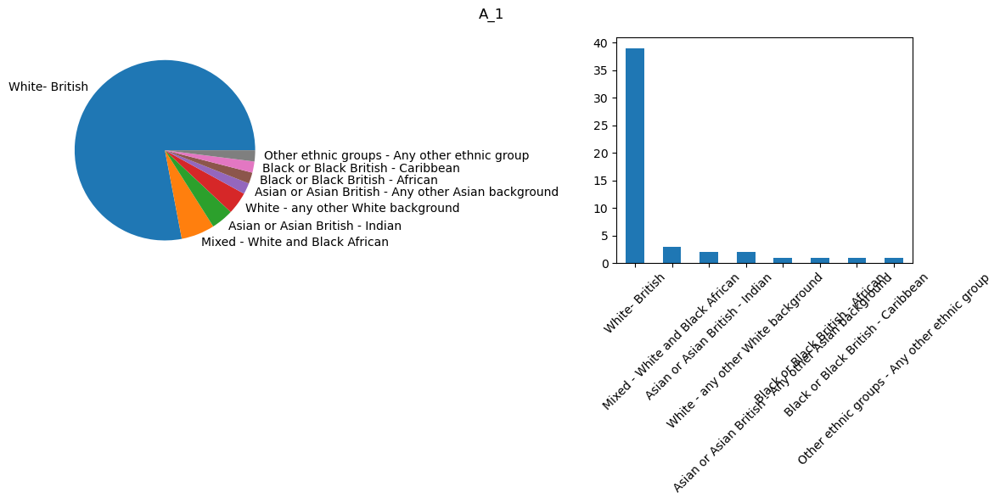

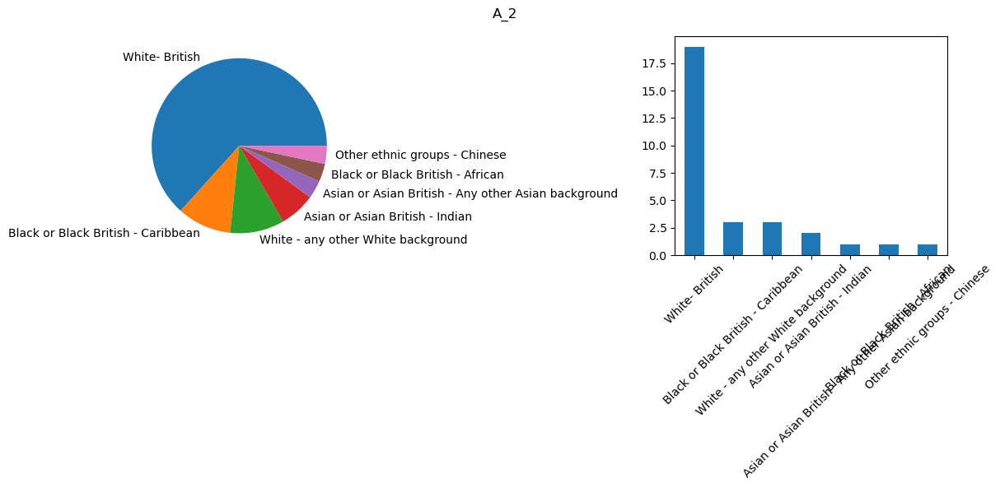

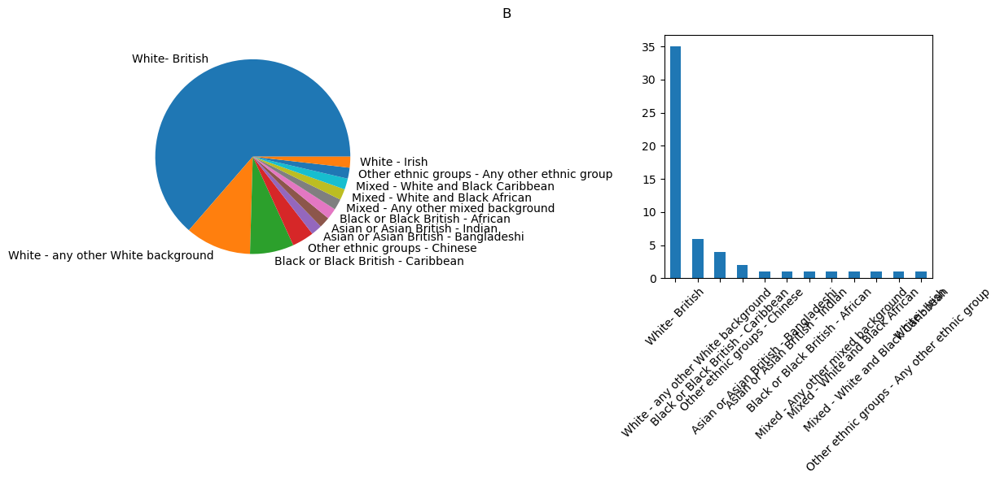

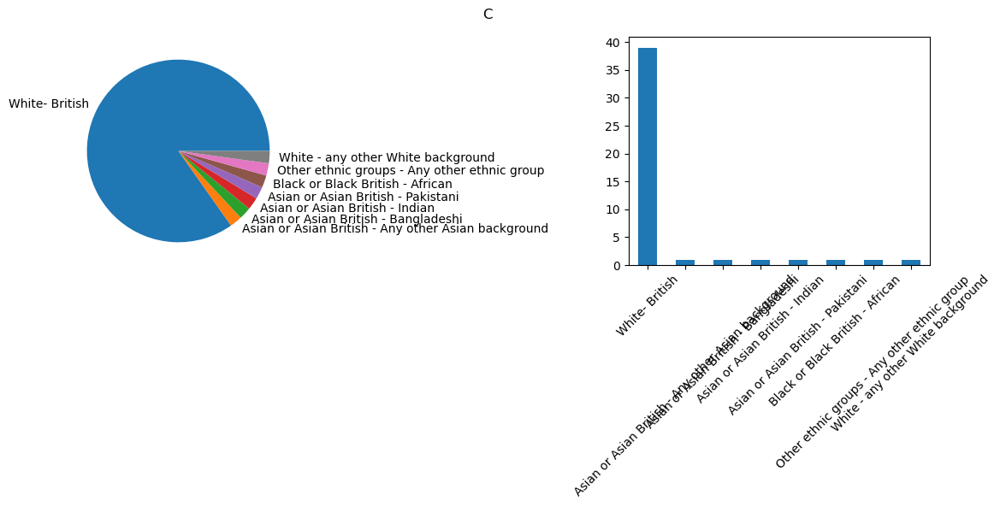

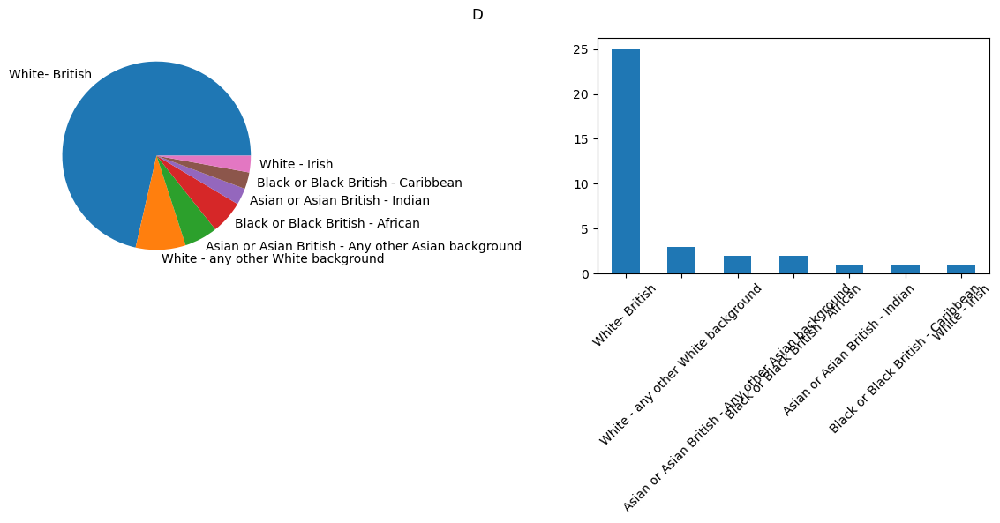

In [195]:
a = add_data.groupby("global_trajectory")["Race"].value_counts()#.plot.pie(subplots=True,)
for cat1, subdf in a.groupby(level='global_trajectory'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    subdf.loc[cat1, :].plot.pie(y='count', ax=ax1, ylabel='', legend=False)
    subdf.loc[cat1, :].plot.bar(y='%', ax=ax2, rot=45, xlabel='', legend=False)
    fig.suptitle(cat1)
    fig.tight_layout()
    plt.show()

In [196]:
leukos = ["Lymphocytes", 'Eosinophils',  'Basophils', "Monocytes", "Neutrophils"]

lab_data = pd.read_csv(data_dir +f"TACERA_data_2024-03-26.csv")
lab_data = lab_data.merge(traject_data, left_on='Subject ID', right_on=["PATNR"])
lab_data.columns

Index(['Subject ID', 'months', 'Study', 'Age', 'Race', 'Sex', 'Weight',
       'Date of Assessment', 'Date of symptom onset', 'Final Score', 'RF',
       'acpa', 'acpa_value', 'rf_value', 'ACPA Value', 'Basophils',
       'CRP Value (mg/L)', 'DAS-28 CRP', 'DAS28', 'DAS28 relative',
       'ESR Value', 'Eosinophils', 'Evaluator global', 'Fatique', 'GL', 'Gdl',
       'HB', 'Lymphocytes', 'Metrologist's score', 'Monocytes', 'Neutrophils',
       'Outside 2 week window', 'PLT', 'Pain score', 'Patient global',
       'RF Unit', 'RF Value', 'SDAI <= 3.3', 'SDAI score',
       'Total 66/68 Swollen Joints', 'Total 66/68 Tender Joints',
       'Total Swollen', 'Total Tender', 'Use of sign '<'', 'WBC', 'Adalimumab',
       'Certolizumab', 'Dexamethasone', 'Etanercept', 'Folic Acid',
       'Golimumab', 'Hydroxychloroquine', 'Leflunomide', 'Methotrexate',
       'Methylprednisolone', 'Methylprednisolone Acetate', 'Prednisolone',
       'Sulfasalazine', 'Tocilizumab', 'Triamcinolone (Kenalog)', '

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


(0.0, 8.0)

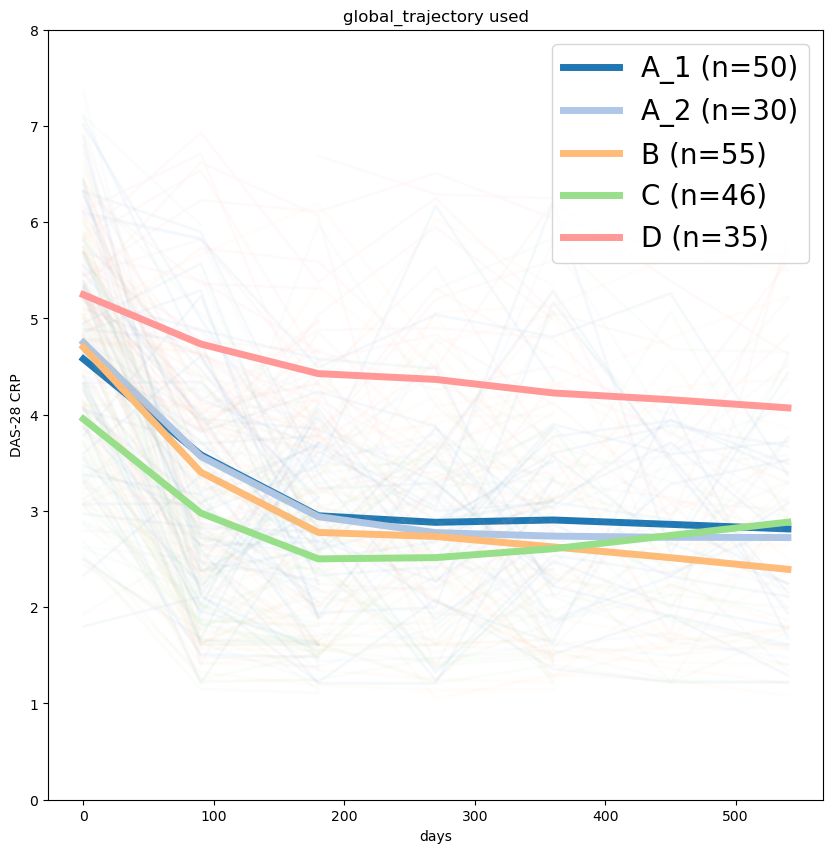

In [197]:

plot_clusters(lab_data, "DAS-28 CRP", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
plt.title("global_trajectory used") 
plt.ylim((0,8))

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


(0.0, 8.0)

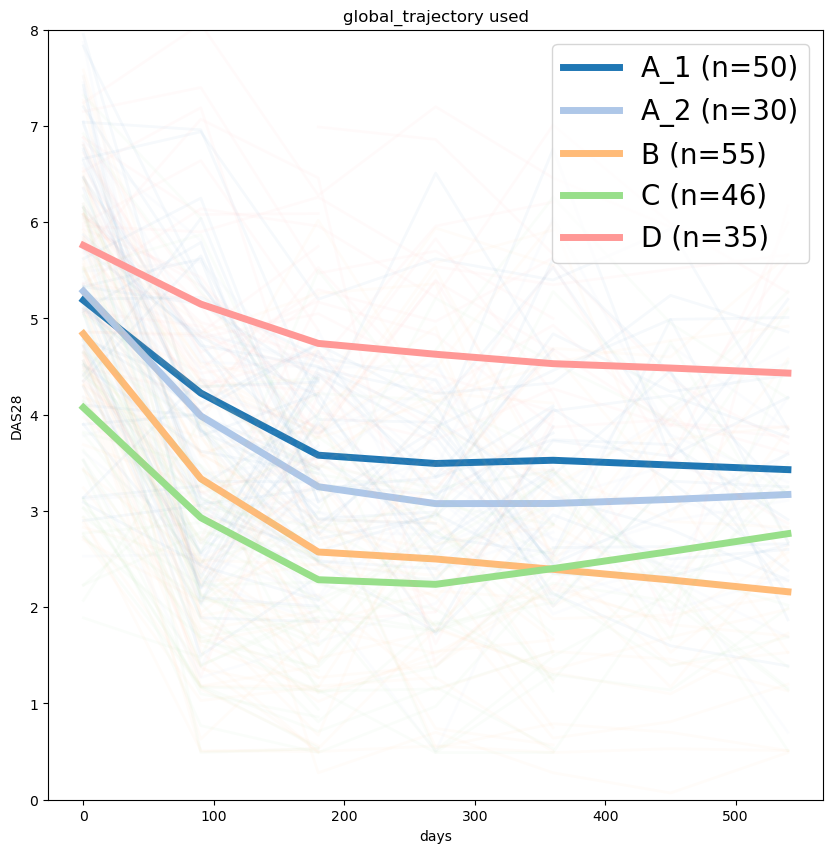

In [198]:

plot_clusters(lab_data, "DAS28", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
plt.title("global_trajectory used") 
plt.ylim((0,8))

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


(0.0, 2.0)

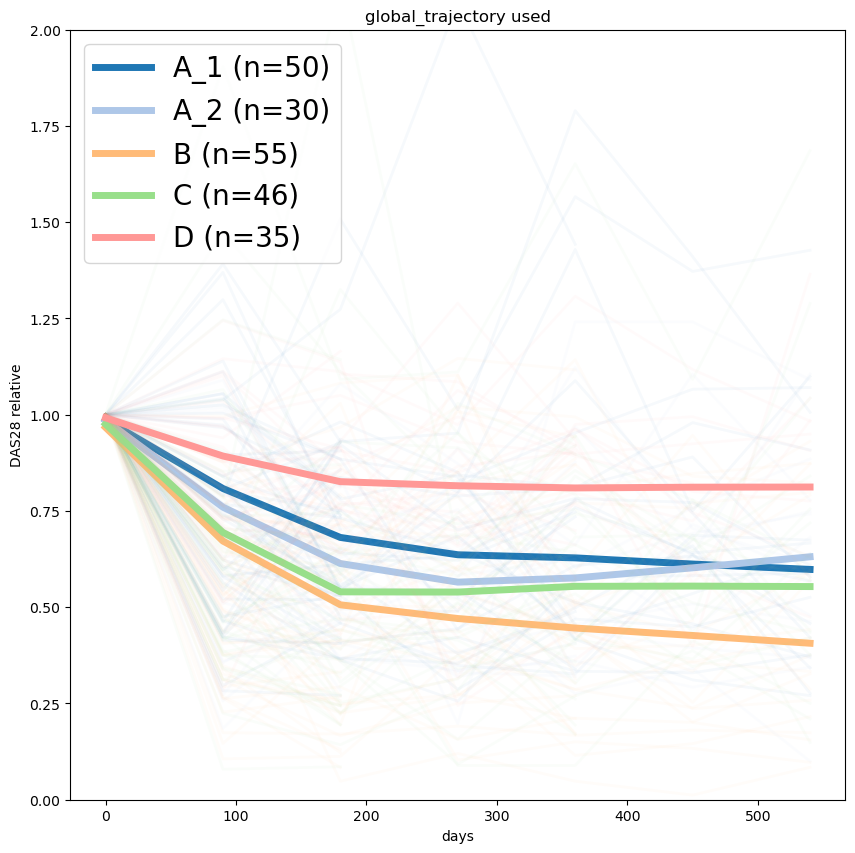

In [199]:

plot_clusters(lab_data, "DAS28 relative", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
plt.title("global_trajectory used") 
plt.ylim((0,2))

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


Text(0.5, 1.0, 'global_trajectory used')

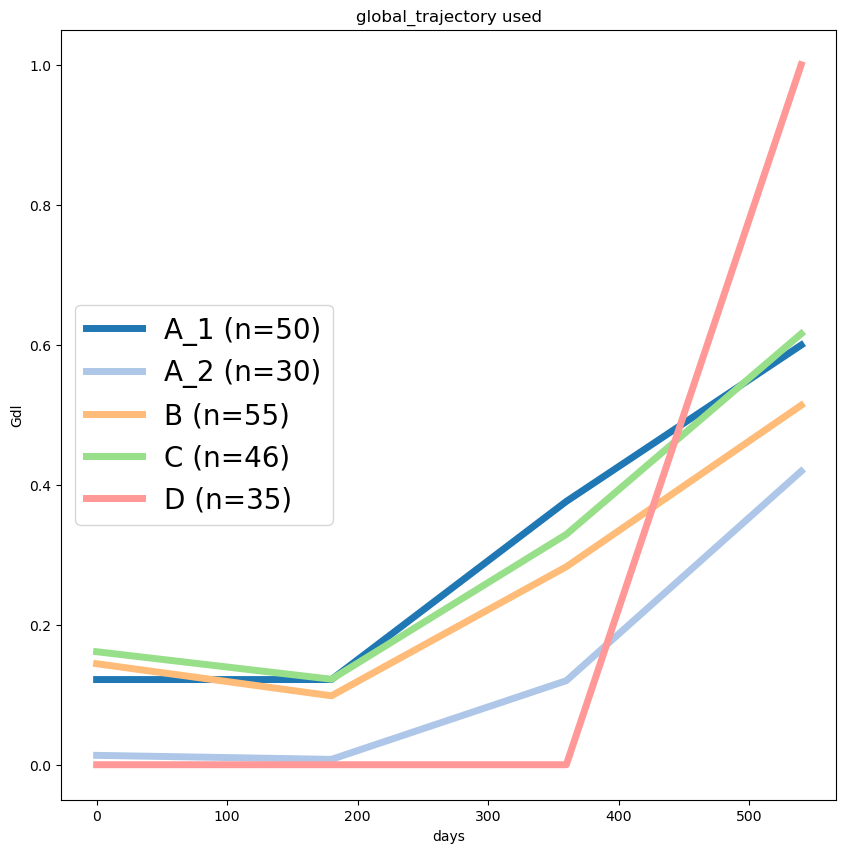

In [200]:

plot_clusters(lab_data, "Gdl", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
plt.title("global_trajectory used") 

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


Text(0.5, 1.0, 'global_trajectory used')

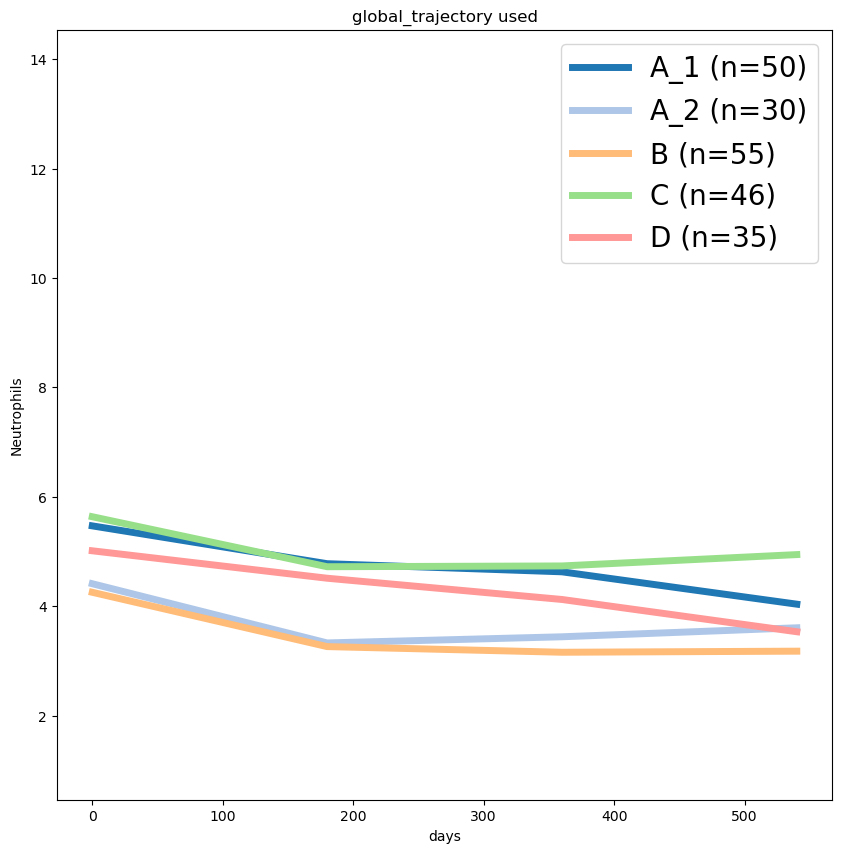

In [201]:

plot_clusters(lab_data, "Neutrophils", "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
plt.title("global_trajectory used") 

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


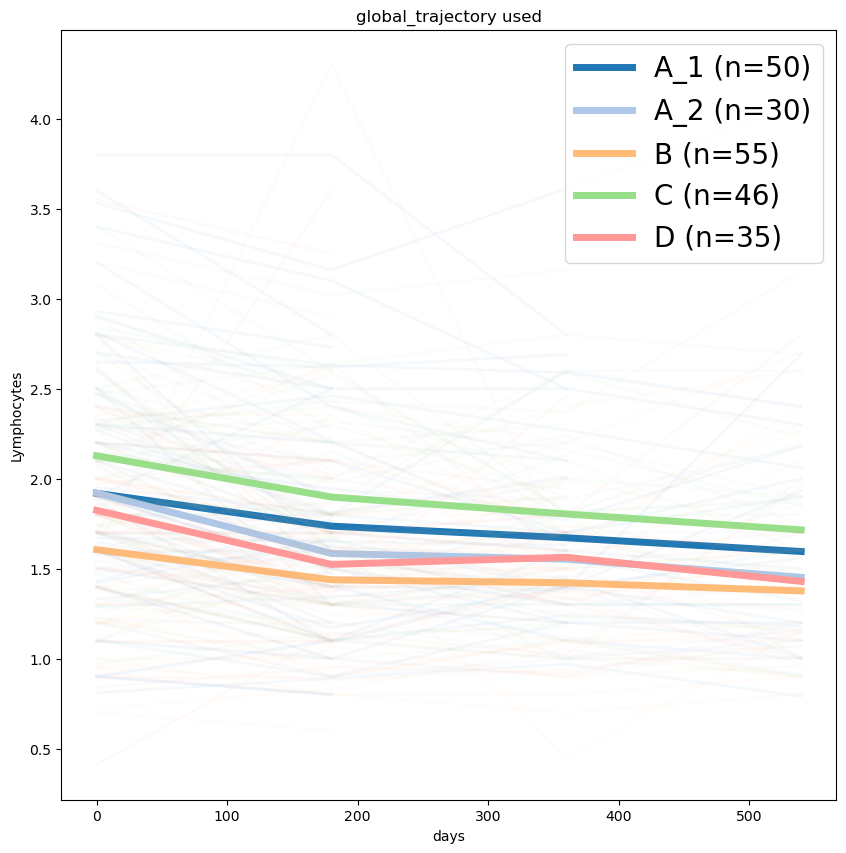

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=52)', 'C (n=46)', 'D (n=35)']


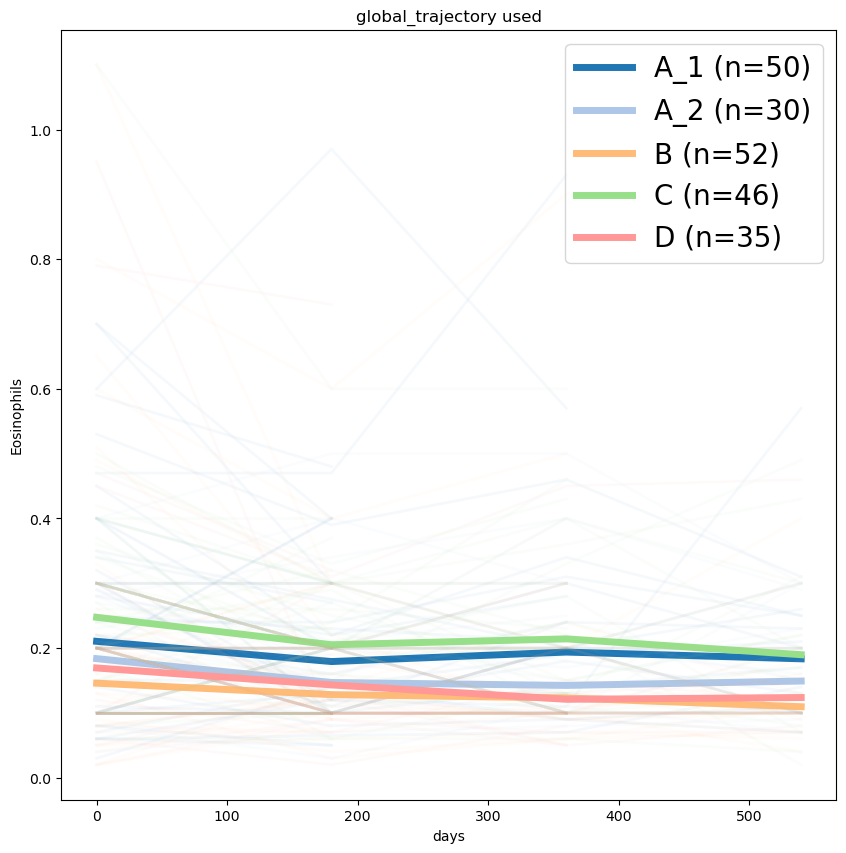

['A_1 (n=45)', 'A_2 (n=23)', 'B (n=40)', 'C (n=41)', 'D (n=23)']


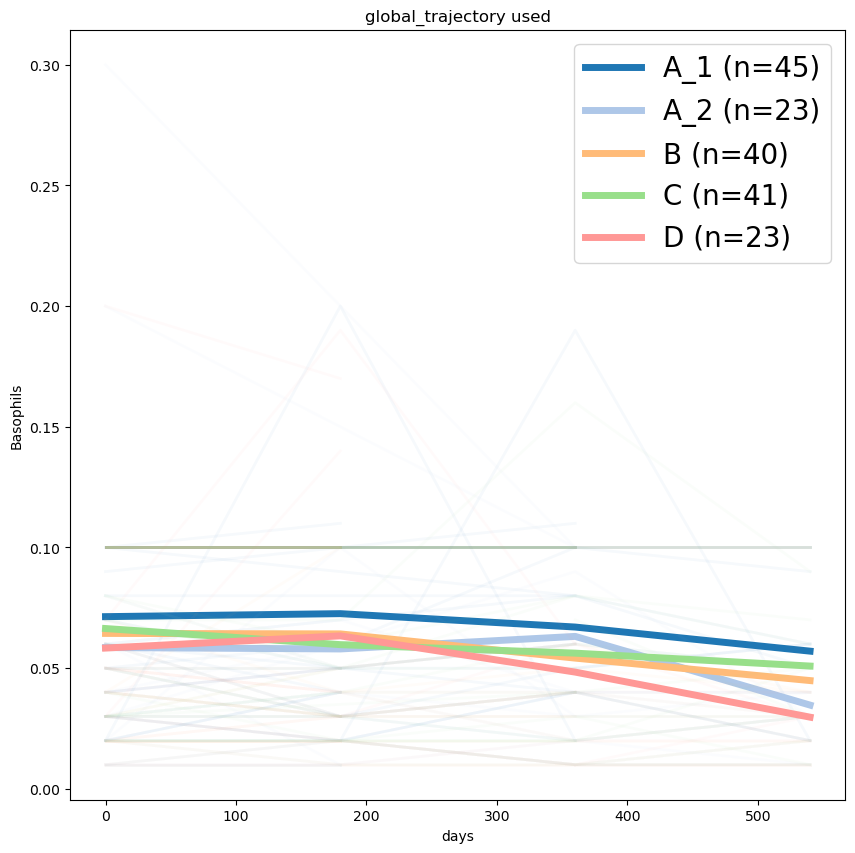

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


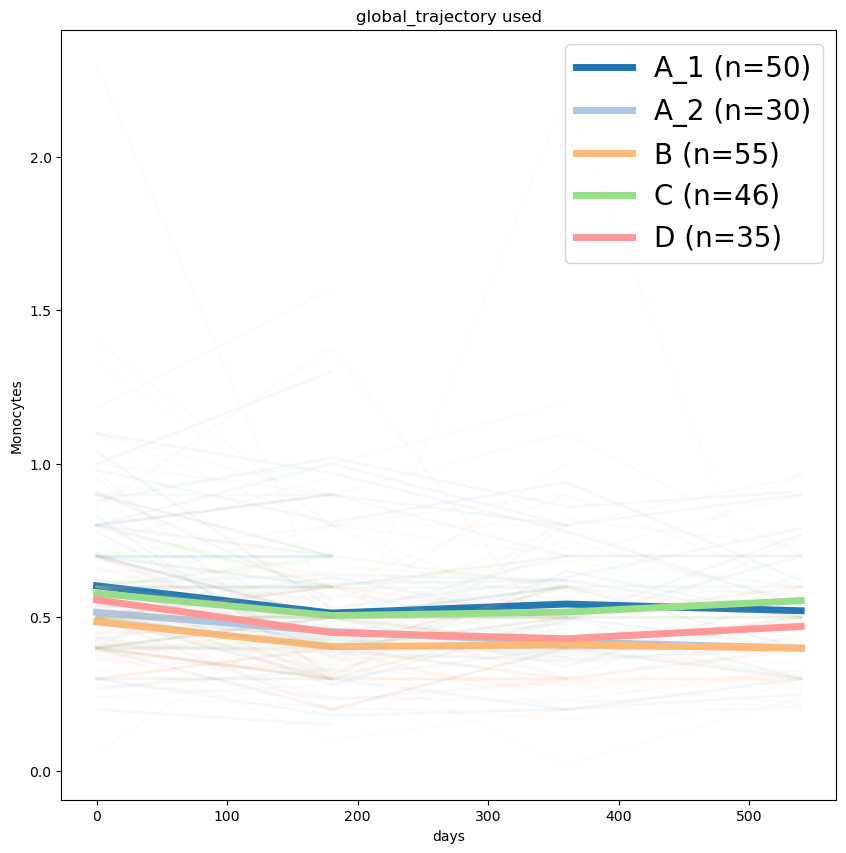

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


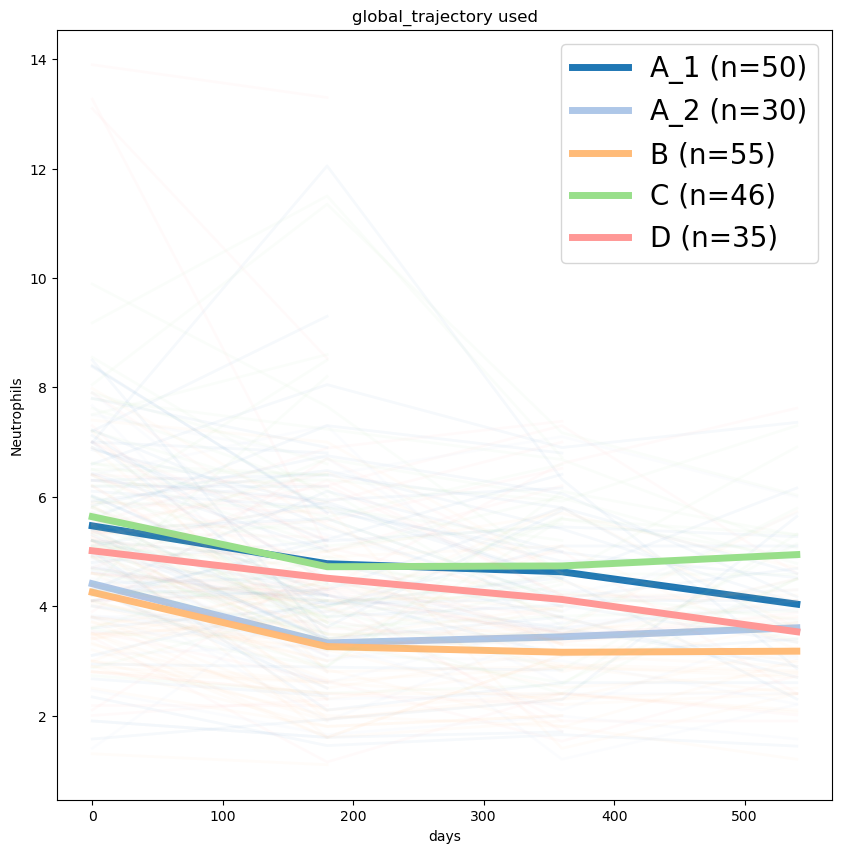

In [202]:
for cell in leukos:
    data = lab_data.query(f"{cell} > 0")
    plot_clusters(data, cell, "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
    plt.title("global_trajectory used") 
    plt.show()

In [203]:
leuko_prob = [f'{x}_ratio'  for x in leukos]
lab_data["sum_leuko"]=lab_data[leukos].sum(axis=1)
lab_data[leuko_prob] = (lab_data[leukos +["sum_leuko"]].apply(lambda x:x/x.sum_leuko, axis=1))[leukos]
lab_data[leukos + ["sum_leuko"]]

,Lymphocytes,Eosinophils,Basophils,Monocytes,Neutrophils,sum_leuko
0,0.9,0.1,0.0,0.8,4.2,6.0
1,NaN,NaN,NaN,NaN,NaN,0.0
2,0.8,0.1,0.0,0.9,5.1,6.9
3,NaN,NaN,NaN,NaN,NaN,0.0
4,NaN,NaN,NaN,NaN,NaN,0.0
...,...,...,...,...,...,...
1507,2.0,0.1,0.0,0.5,4.0,6.6
1508,NaN,NaN,NaN,NaN,NaN,0.0
1509,1.8,0.2,0.0,0.3,1.9,4.2
1510,NaN,NaN,NaN,NaN,NaN,0.0


['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


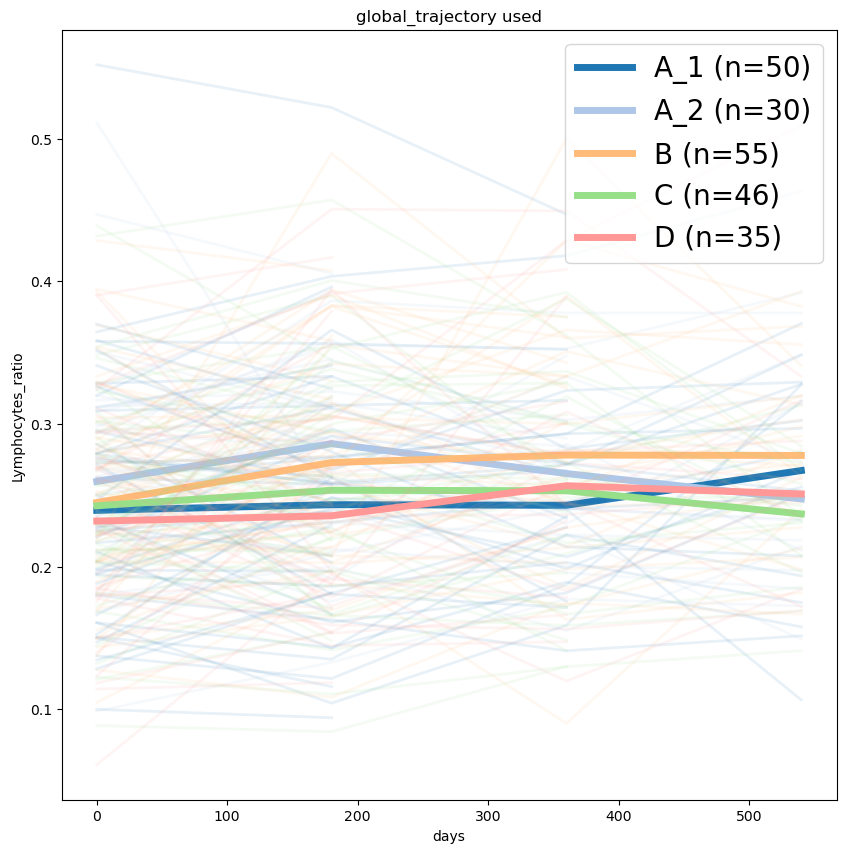

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=52)', 'C (n=46)', 'D (n=35)']


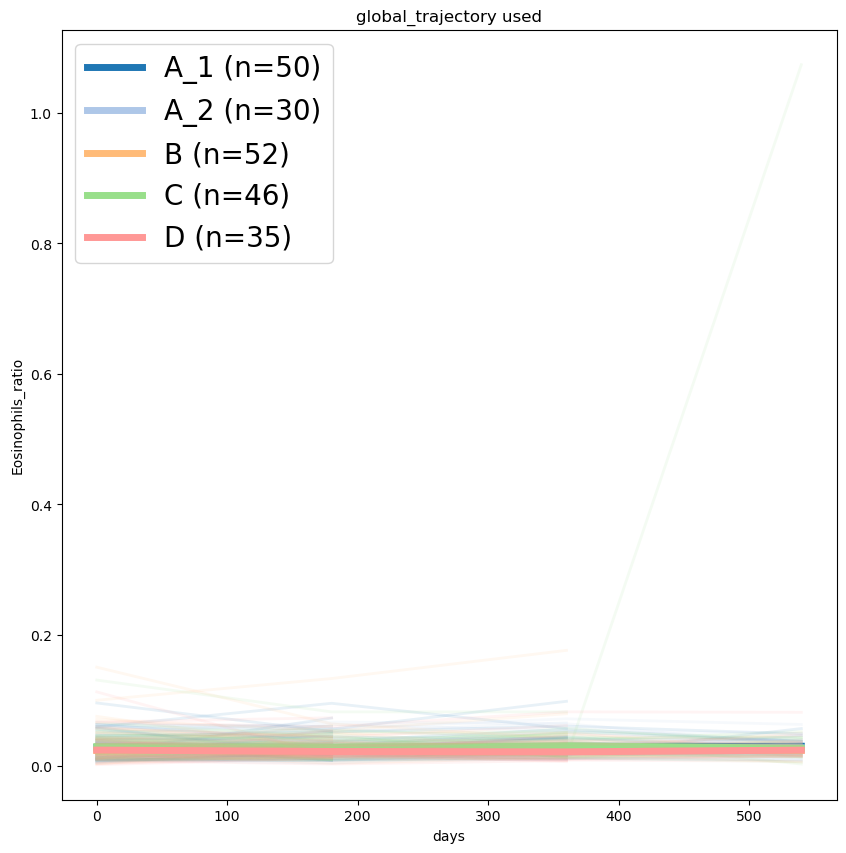

['A_1 (n=45)', 'A_2 (n=23)', 'B (n=40)', 'C (n=41)', 'D (n=23)']


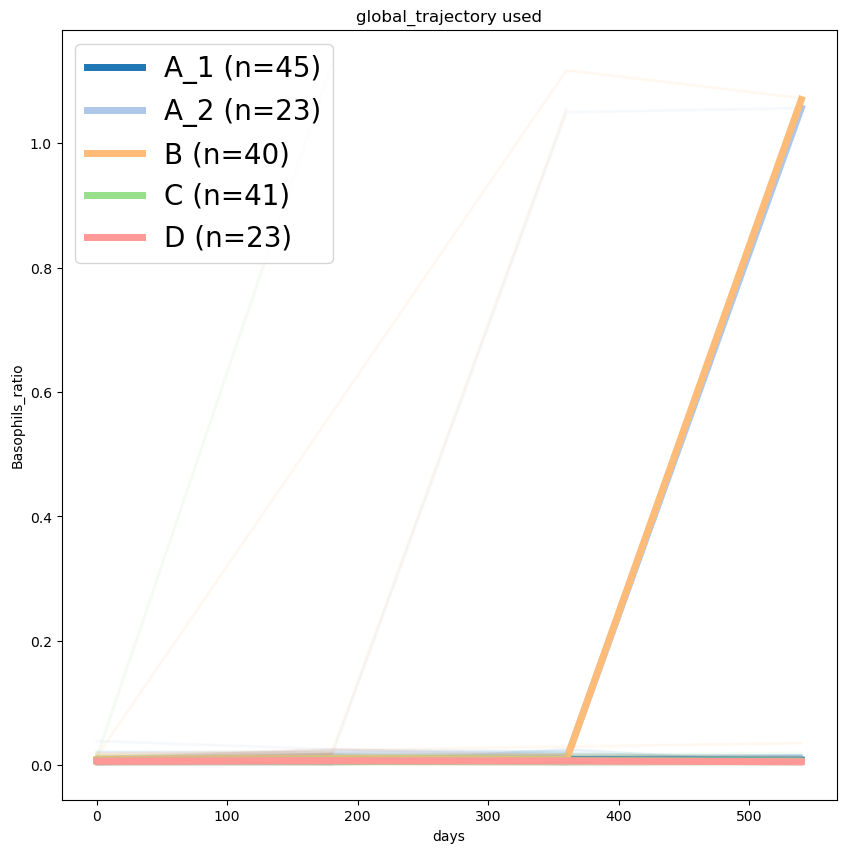

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


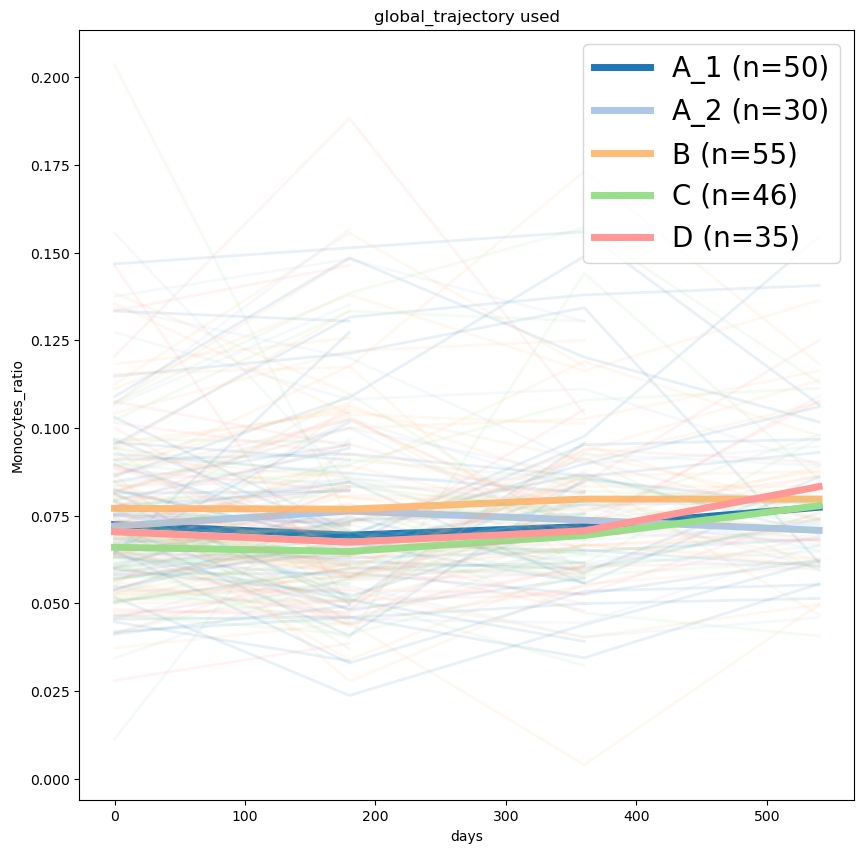

['A_1 (n=50)', 'A_2 (n=30)', 'B (n=55)', 'C (n=46)', 'D (n=35)']


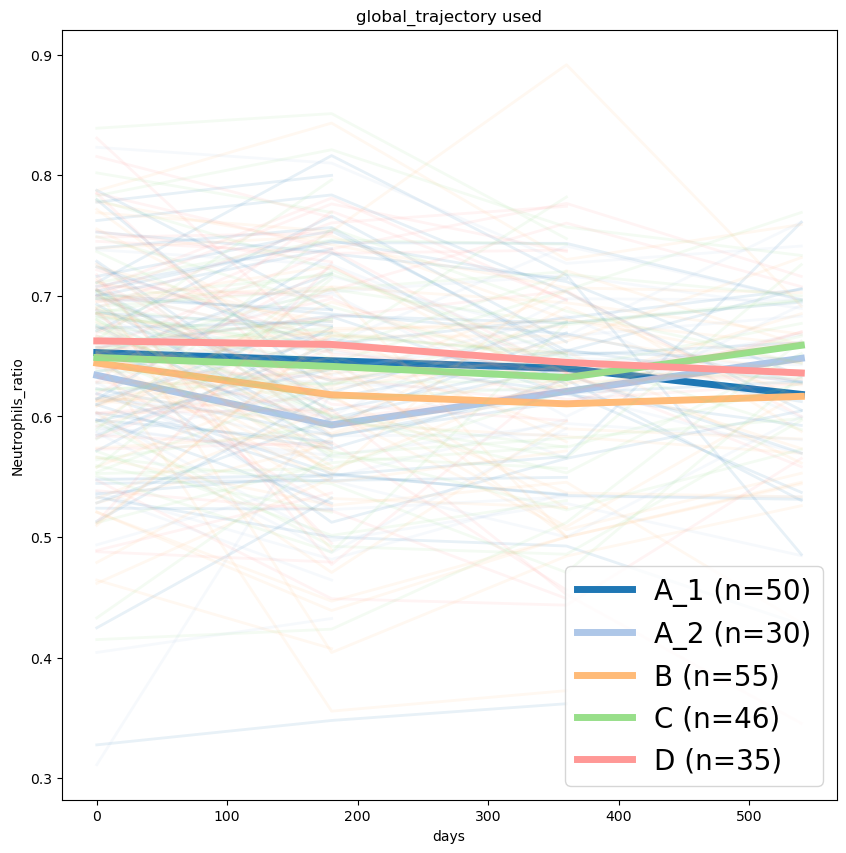

In [204]:
for cell in leuko_prob:
    data = lab_data.query(f"{cell} > 0")
    plot_clusters(data, cell, "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper, alpha=0.1)
    plt.title("global_trajectory used") 
    plt.show()

In [205]:
class surv_functions_2:
    ALL_QUERY = "PATNR in PATNR"

    def km_data(
        dataset: pd.DataFrame,
        group_name: str,
        datum_column: str,
        query_sort: str,
        query_differ: str,
    ) -> np.array:
        """
        This function creates the correct datarepresentation for the module 'lifelines'
        it uses query language from pandas to select the correct reprensentation of the different groups.


        """
        data= (dataset.sort_values(datum_column)
            .query(query_sort))
        start = (
            data
            .groupby(group_name)[[group_name, datum_column]]
            .head(1)
            .copy()
            .rename(columns={datum_column: "start"})
        )
        start = data.groupby(group_name).head(1)[["PATNR","baseline"]].reset_index().rename(columns={"baseline": "start"})
        last = (
            data
            .groupby(group_name)[[group_name, datum_column]]
            .tail(1)
            .copy()
            .rename(columns={datum_column: "last_visit"})
        )
        end = (
            data.query(query_differ)
            .groupby(group_name)[[group_name, datum_column]]
            .head(1)
            .copy()
            .rename(columns={datum_column: "end"})
        )
        start = start.merge(last, on=group_name, how="left")
        start = start.merge(end, on=group_name, how="left")
        start["last"] = (start.last_visit - start.start)
        try: 
            start["last"] = start["last"].dt.days
        except AttributeError as e:
            start["last"] = pd.to_datetime(start["last"], unit= "D")
            start["start"] = pd.to_datetime(start["start"], unit= "D")
            start["end"] = pd.to_datetime(start["end"], unit= "D")
            
        
        T, E = datetimes_to_durations(start.start, start.end, freq="D")
        start["Time"] = T
        start["Event"] = E
        start["Time"] = start[["last", "Time"]].min(axis=1).astype(int)
        return start

In [206]:
data_use = data_use.drop(columns=["last_visit_x","last_visit_y"], errors="ignore")

In [207]:
data_use = data_use.merge(data_use.query("`Metrologist's score` >= 0").groupby("PATNR")[["months"]].max().rename(columns={"months":"last_visit"}), on="PATNR")
data_use["baseline"] = 0
data_use

,PATNR,months,Study,Age,Race,Sex,Weight,Date of Assessment,Date of symptom onset,Final Score,...,Tocilizumab,Triamcinolone (Kenalog),days,global_trajectory,symptom_date,test_date,time till assessment,remision,last_visit,baseline
0,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,0,TACERA,79,White- British,Female,50.8,6/25/2015,2/1/2015,9.0,...,0,0,0,A_1,2015-02-01,2015-06-25,-144,False,6,0
1,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,3,TACERA,79,White- British,Female,50.8,6/25/2015,2/1/2015,9.0,...,0,0,90,A_1,2015-02-01,2015-06-25,-144,True,6,0
2,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,6,TACERA,79,White- British,Female,50.8,6/25/2015,2/1/2015,9.0,...,0,0,180,A_1,2015-02-01,2015-06-25,-144,True,6,0
3,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,9,TACERA,79,White- British,Female,50.8,6/25/2015,2/1/2015,9.0,...,0,0,270,A_1,2015-02-01,2015-06-25,-144,False,6,0
4,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,12,TACERA,79,White- British,Female,50.8,6/25/2015,2/1/2015,9.0,...,0,0,360,A_1,2015-02-01,2015-06-25,-144,False,6,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1507,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,6,TACERA,52,Asian or Asian British - Any other Asian backg...,Female,80.0,2/5/2014,7/8/2013,1.0,...,0,0,180,D,2013-07-08,2014-02-05,-212,False,18,0
1508,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,9,TACERA,52,Asian or Asian British - Any other Asian backg...,Female,80.0,2/5/2014,7/8/2013,1.0,...,0,0,270,D,2013-07-08,2014-02-05,-212,False,18,0
1509,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,12,TACERA,52,Asian or Asian British - Any other Asian backg...,Female,80.0,2/5/2014,7/8/2013,1.0,...,0,0,360,D,2013-07-08,2014-02-05,-212,False,18,0
1510,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,15,TACERA,52,Asian or Asian British - Any other Asian backg...,Female,80.0,2/5/2014,7/8/2013,1.0,...,0,0,450,D,2013-07-08,2014-02-05,-212,False,18,0


In [208]:
counts_visit = data_use.query("`Metrologist's score` >= 0").groupby("global_trajectory").months.value_counts().reset_index(level=0).rename(columns={"months":"count"}).reset_index(level=0)

In [209]:
counts_visit = data_use.query("`Metrologist's score` >= 0").groupby("global_trajectory").months.value_counts().reset_index(level=0).rename(columns={"months":"count"}).reset_index(level=0)
base = counts_visit.query("months == 0")[["global_trajectory", "count"]]
percentages = base[["global_trajectory"]]
print(base)
for i in range(0,21,3):
    print(counts_visit.query("months == @i")[["global_trajectory", "count"]])
    print(counts_visit.query("months == @i")["count"]/base["count"].values)
    percentages.loc[:,i] = counts_visit.query("months == @i")["count"]/base["count"].values.T


   global_trajectory  count
0                A_1     50
7                A_2     30
15                 B     54
21                 C     46
28                 D     35
   global_trajectory  count
0                A_1     50
7                A_2     30
15                 B     54
21                 C     46
28                 D     35
0     1.0
7     1.0
15    1.0
21    1.0
28    1.0
Name: count, dtype: float64
   global_trajectory  count
2                A_1     46
8                A_2     29
16                 B     54
22                 C     45
30                 D     33
2     0.920000
8     0.966667
16    1.000000
22    0.978261
30    0.942857
Name: count, dtype: float64
   global_trajectory  count
1                A_1     47
9                A_2     28
14                 B     55
23                 C     44
29                 D     35
1     0.940000
9     0.933333
14    1.018519
23    0.956522
29    1.000000
Name: count, dtype: float64
   global_trajectory  count
4               

In [210]:
percentages

,global_trajectory,0,3,6,9,12,15,18
0,A_1,1.0,NaN,NaN,NaN,NaN,NaN,NaN
7,A_2,1.0,NaN,NaN,NaN,NaN,NaN,NaN
15,B,1.0,NaN,NaN,NaN,NaN,NaN,NaN
21,C,1.0,NaN,NaN,NaN,NaN,NaN,NaN
28,D,1.0,NaN,NaN,NaN,NaN,NaN,NaN


TypeError: '<=' not supported between instances of 'Timestamp' and 'float'

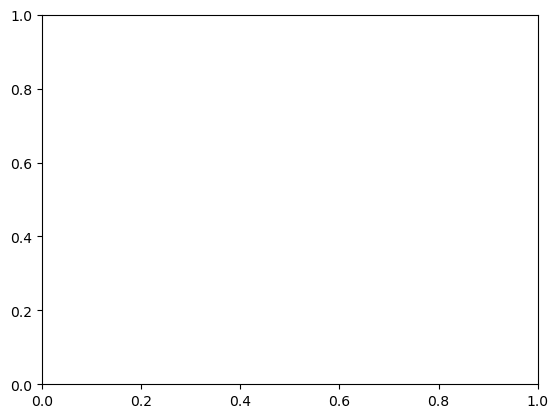

In [211]:
import __init__
from utils.lifelines_preprocess import surv_functions
from lifelines.utils import datetimes_to_durations
from lifelines import KaplanMeierFitter
from lifelines.plotting import add_at_risk_counts

ax = plt.subplot(111)

kmf = KaplanMeierFitter()



true_q = surv_functions_2.km_data(data_use,"PATNR", "months", "PATNR in PATNR", "months == last_visit")
#false_q = surv_functions.km_data(data_,"PATNR", "startDate", "`aCCP positive` == False", "drugName == 'METHOTREXAAT'")

kmf.fit(true_q.Time, true_q.Event , label="last visit", timeline=list(range(18)))
kmf.plot_survival_function(ax=ax)




216


TypeError: '<=' not supported between instances of 'Timestamp' and 'float'

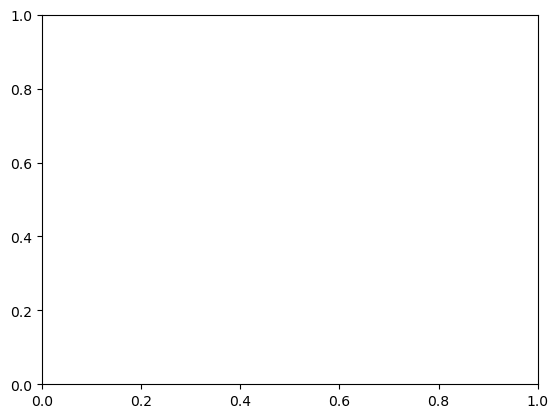

In [212]:

ax = plt.subplot(111)
kmf_list = []
query= "startDate == last_visit"
query= "drugName == 'METHOTREXAAT'"
for i in sorted(data_use.global_trajectory.dropna().unique()):
    kmf_list.append(KaplanMeierFitter())
    data_knf_raw = data_use
    print(len(data_knf_raw.PATNR.unique()))
    data_kmf=  surv_functions_2.km_data(data_use,"PATNR", "months", f"global_trajectory == '{i}'", "months == last_visit")
    #data_kmf = surv_functions.km_data(data_knf_raw, "PATNR", "startDate", f"global_trajectory == '{i}' & pred == 'B'" , query)

    kmf_list[-1].fit(data_kmf.Time, data_kmf.Event, label =f"global_trajectory {i}", timeline=list(range(18)))
    kmf_list[-1].plot_survival_function(ax=ax, show_censors=True)


add_at_risk_counts(*kmf_list, ax=ax)
plt.title("predicted B trajectory, MTX start")
ax.set_figheight(15)
ax.set_figwidth(15)

In [214]:
data_use.columns

Index(['PATNR', 'months', 'Study', 'Age', 'Race', 'Sex', 'Weight',
       'Date of Assessment', 'Date of symptom onset', 'Final Score', 'RF',
       'acpa', 'acpa_value', 'rf_value', 'ACPA Value', 'Basophils',
       'CRP Value (mg/L)', 'DAS-28 CRP', 'DAS28', 'DAS28 relative',
       'ESR Value', 'Eosinophils', 'Evaluator global', 'Fatique', 'GL', 'Gdl',
       'HB', 'Lymphocytes', 'Metrologist's score', 'Monocytes', 'Neutrophils',
       'Outside 2 week window', 'PLT', 'Pain score', 'Patient global',
       'RF Unit', 'RF Value', 'SDAI <= 3.3', 'SDAI score',
       'Total 66/68 Swollen Joints', 'Total 66/68 Tender Joints',
       'Total Swollen', 'Total Tender', 'Use of sign '<'', 'WBC', 'Adalimumab',
       'Certolizumab', 'Dexamethasone', 'Etanercept', 'Folic Acid',
       'Golimumab', 'Hydroxychloroquine', 'Leflunomide', 'Methotrexate',
       'Methylprednisolone', 'Methylprednisolone Acetate', 'Prednisolone',
       'Sulfasalazine', 'Tocilizumab', 'Triamcinolone (Kenalog)', 'days'

In [215]:
data_use["NLR"] = data_use.Neutrophils / data_use.Lymphocytes 

In [216]:
data_use["PLR"] = data_use.PLT / data_use.Lymphocytes 

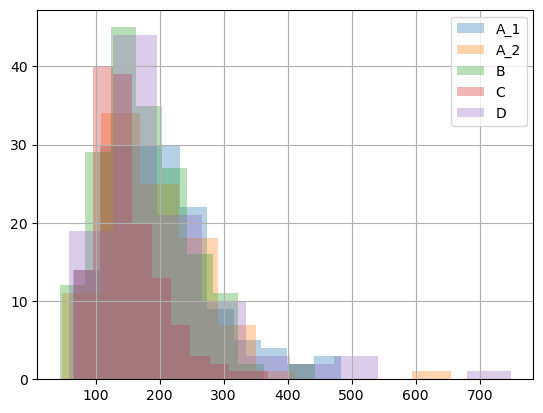

In [217]:
ax = data_use.groupby("global_trajectory").PLR.hist(alpha=0.333, legend=True)#.plot.pie(subplots=True,)
plt.legend()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


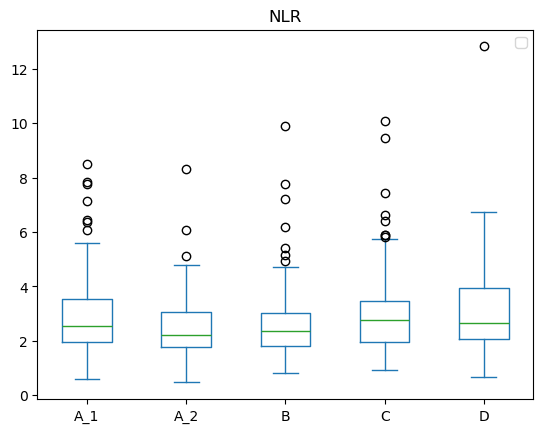

In [218]:
ax = data_use.plot.box(column="NLR", by="global_trajectory")#.plot.pie(subplots=True,)
plt.legend()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


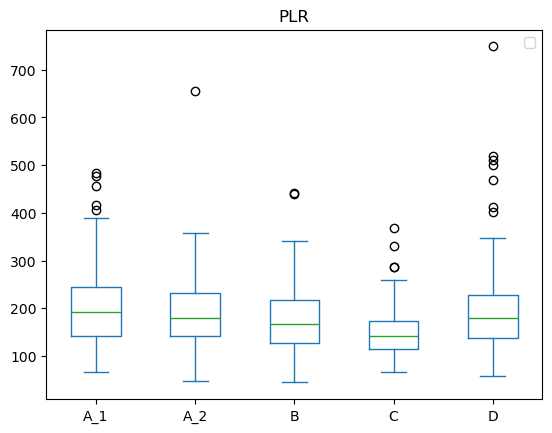

In [219]:
ax = data_use.plot.box(column="PLR", by="global_trajectory")#.plot.pie(subplots=True,)
plt.legend()

<Axes: xlabel='PLR', ylabel='NLR'>

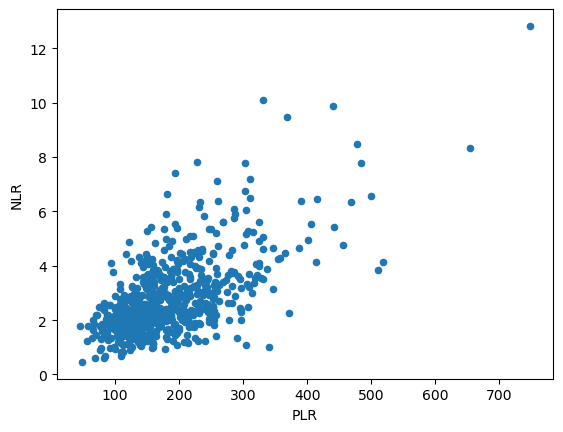

In [220]:
data_use.plot.scatter(x="PLR", y="NLR", )#c="global_trajectory")#.plot.pie(subplots=True,)

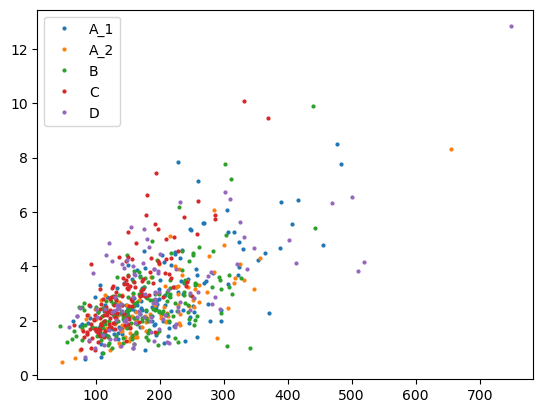

In [221]:
groups = data_use.groupby('global_trajectory')

# Plot
fig, ax = plt.subplots()
ax.margins(0.05) # Optional, just adds 5% padding to the autoscaling
for name, group in groups:
    ax.plot(group.PLR, group.NLR, marker='o', linestyle='', ms=2, label=name)
ax.legend()

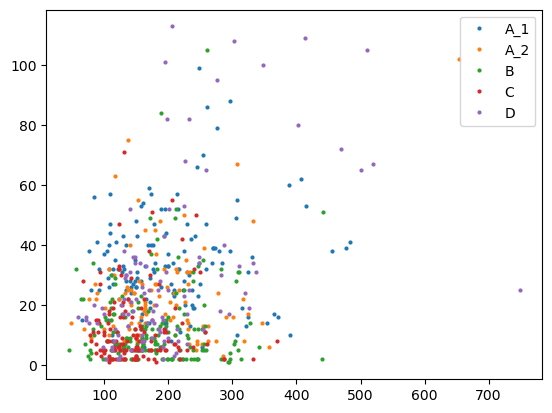

In [222]:
groups = data_use.groupby('global_trajectory')

# Plot
fig, ax = plt.subplots()
ax.margins(0.05) # Optional, just adds 5% padding to the autoscaling
for name, group in groups:
    ax.plot(group.PLR, group["ESR Value"], marker='o', linestyle='', ms=2, label=name)
ax.legend()

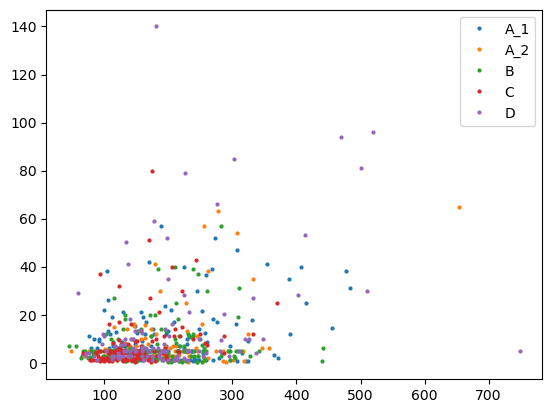

In [223]:
groups = data_use.groupby('global_trajectory')

# Plot
fig, ax = plt.subplots()
ax.margins(0.05) # Optional, just adds 5% padding to the autoscaling
for name, group in groups:
    ax.plot(group.PLR, group["CRP Value (mg/L)"], marker='o', linestyle='', ms=2, label=name)
ax.legend()

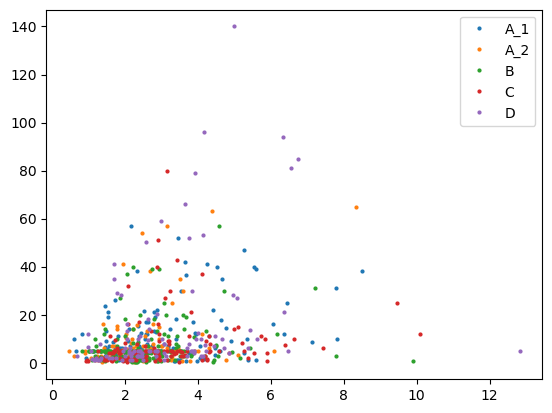

In [224]:
groups = data_use.groupby('global_trajectory')

# Plot
fig, ax = plt.subplots()
ax.margins(0.05) # Optional, just adds 5% padding to the autoscaling
for name, group in groups:
    ax.plot(group.NLR, group["CRP Value (mg/L)"], marker='o', linestyle='', ms=2, label=name)
ax.legend()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


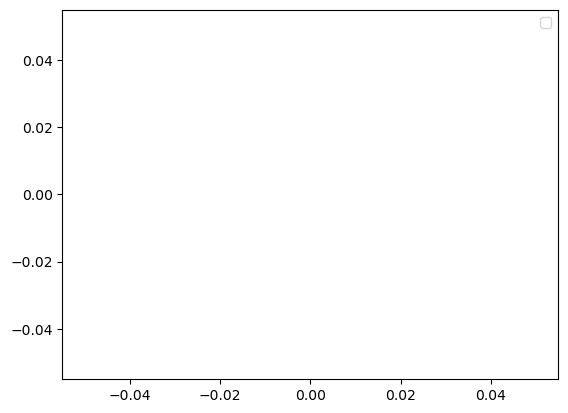

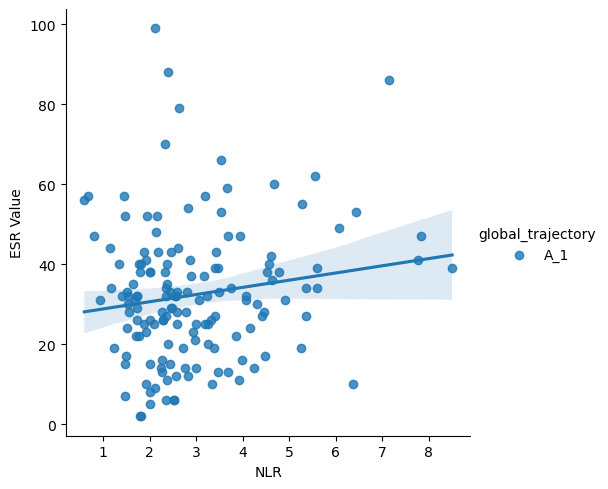

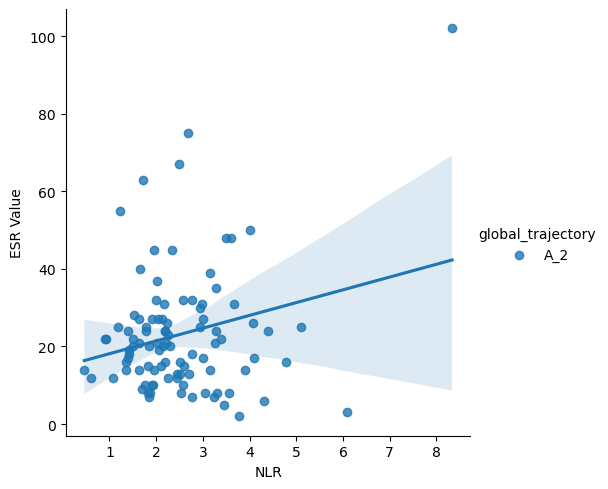

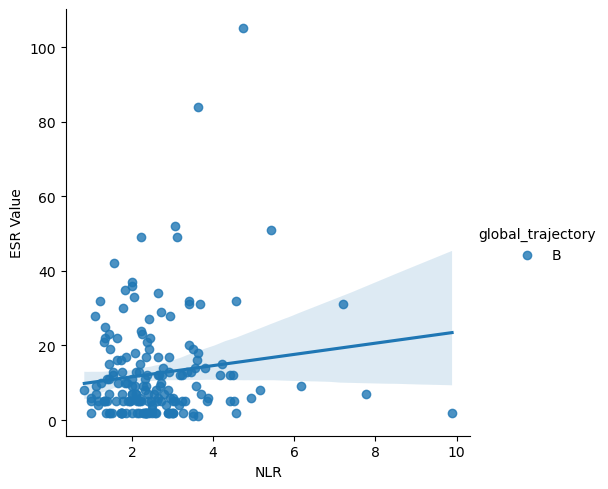

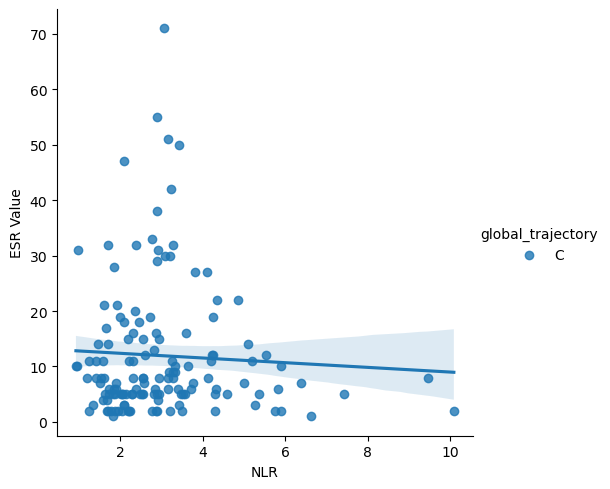

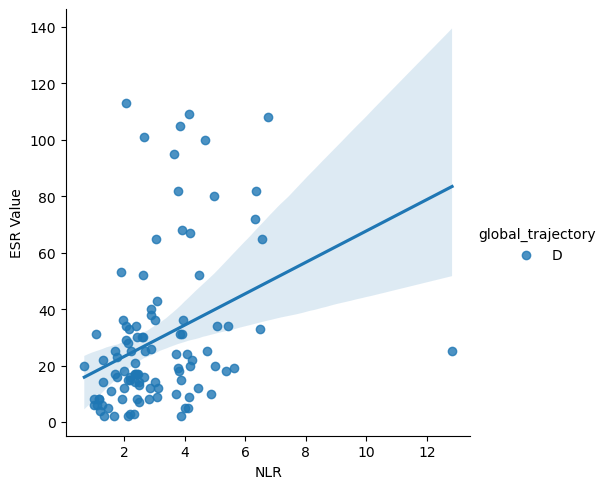

In [225]:
groups = data_use.groupby('global_trajectory')

# Plot
fig, ax = plt.subplots()
ax.margins(0.05) # Optional, just adds 5% padding to the autoscaling
for name, group in groups:
    sns.lmplot(x="NLR", y="ESR Value", data=group, hue="global_trajectory")
ax.legend()

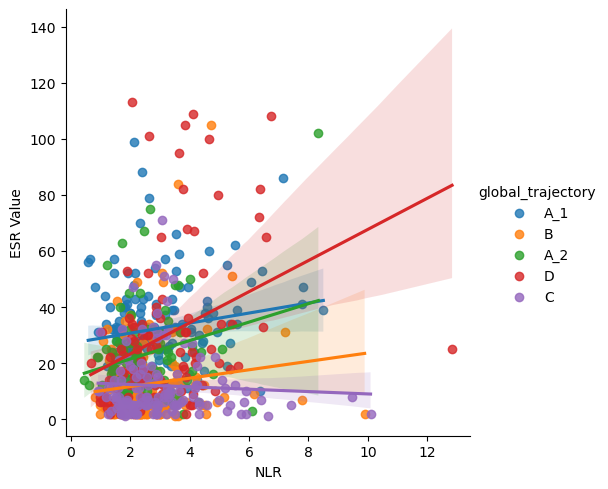

In [226]:

 sns.lmplot(x="NLR", y="ESR Value", data=data_use, hue="global_trajectory")

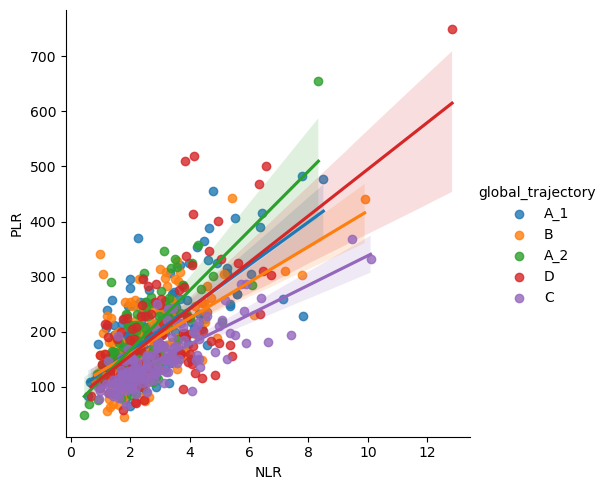

In [227]:

 sns.lmplot(x="NLR", y="PLR", data=data_use, hue="global_trajectory")

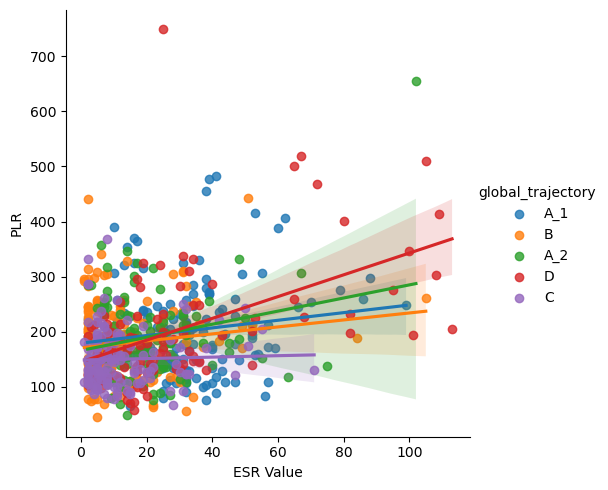

In [228]:

 sns.lmplot(x="ESR Value", y="PLR", data=data_use, hue="global_trajectory")

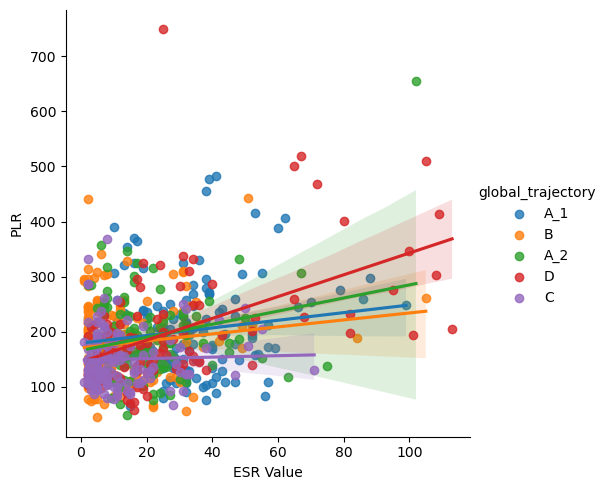

In [229]:

 sns.lmplot(x="ESR Value", y="PLR", data=data_use, hue="global_trajectory")

PearsonRResult(statistic=0.32026415462592195, pvalue=2.249935319028064e-17)
A_1 : PearsonRResult(statistic=0.14070948865528737, pvalue=0.08696311651055086)
A_2 : PearsonRResult(statistic=0.2287666438690487, pvalue=0.024205007011997987)
B : PearsonRResult(statistic=0.12829187886983745, pvalue=0.087891242573697)
C : PearsonRResult(statistic=0.031052498843376068, pvalue=0.7156997777056869)
D : PearsonRResult(statistic=0.5012768823420535, pvalue=6.918686836760201e-08)


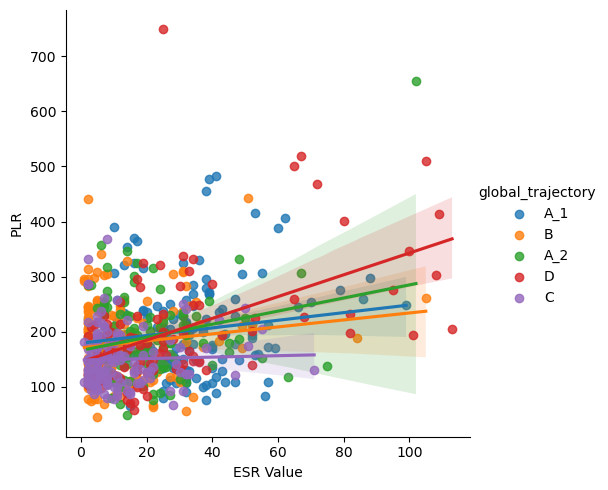

In [230]:
 sns.lmplot(x="ESR Value", y="PLR", data=data_use, hue="global_trajectory")
from scipy import stats
pearson_data = data_use[['ESR Value', 'PLR', "global_trajectory"]].dropna(axis=0)

print(stats.pearsonr(pearson_data['ESR Value'], pearson_data['PLR']))
groups = pearson_data.groupby('global_trajectory')
for name, group in groups:
    print(name,":",stats.pearsonr(group['ESR Value'], group['PLR']))


PearsonRResult(statistic=0.74606992575497, pvalue=1.1664513878188027e-39)
A_1 : PearsonRResult(statistic=0.7949912405396187, pvalue=5.417582166302941e-12)
A_2 : PearsonRResult(statistic=0.8701120685359918, pvalue=4.2314031761103066e-10)
B : PearsonRResult(statistic=0.6340363742777474, pvalue=2.0282162292824074e-07)
C : PearsonRResult(statistic=0.7875276671281437, pvalue=8.434999981977209e-11)
D : PearsonRResult(statistic=0.7998187975992517, pvalue=8.211426972550918e-09)


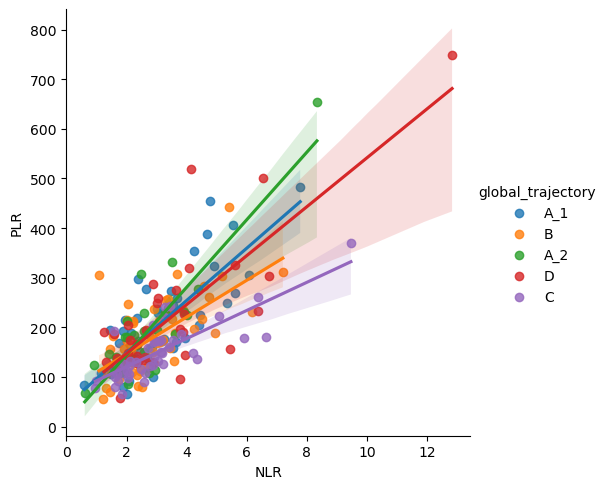

In [231]:
x,y= "NLR","PLR"
sns.lmplot(x=x, y=y, data= data_use.query("months == 0 "), hue="global_trajectory")
from scipy import stats
pearson_data = data_use.query("months == 0 ")[[x, y, "global_trajectory"]].dropna(axis=0)

print(stats.pearsonr(pearson_data[x], pearson_data[y]))
groups = pearson_data.groupby('global_trajectory')
for name, group in groups:
    print(name,":",stats.pearsonr(group[x], group[y]))


PearsonRResult(statistic=0.37296307045430244, pvalue=1.558678687326525e-08)
A_1 : PearsonRResult(statistic=0.2730760091092157, pvalue=0.05501678001230298)
A_2 : PearsonRResult(statistic=0.6200541880820777, pvalue=0.00025748388948169796)
B : PearsonRResult(statistic=0.3636198982329014, pvalue=0.006355865482488314)
C : PearsonRResult(statistic=0.13663024534153784, pvalue=0.3652402429336974)
D : PearsonRResult(statistic=0.24861729728972096, pvalue=0.14982566083441293)


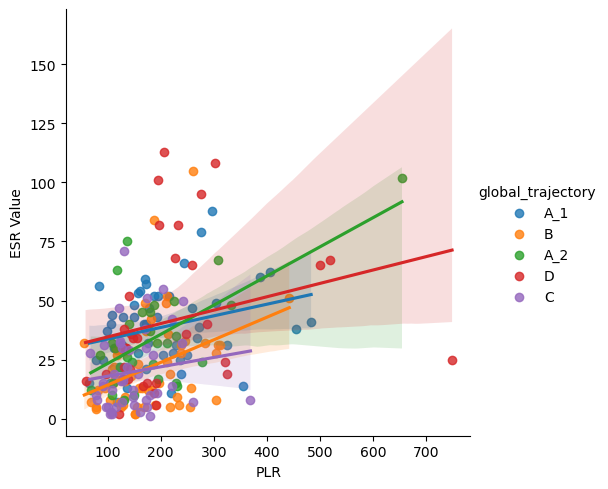

In [232]:
x,y= "PLR","ESR Value"
sns.lmplot(x=x, y=y, data= data_use.query("months == 0 "), hue="global_trajectory")
from scipy import stats
pearson_data = data_use.query("months == 0 ")[[x, y, "global_trajectory"]].dropna(axis=0)

print(stats.pearsonr(pearson_data[x], pearson_data[y]))
groups = pearson_data.groupby('global_trajectory')
for name, group in groups:
    print(name,":",stats.pearsonr(group[x], group[y]))

PearsonRResult(statistic=0.45848078682598836, pvalue=1.4253973992664015e-12)
A_1 : PearsonRResult(statistic=0.4344202805384721, pvalue=0.0016201792205357462)
A_2 : PearsonRResult(statistic=0.7407045195456102, pvalue=2.863440616746991e-06)
B : PearsonRResult(statistic=0.35094694640440893, pvalue=0.008612965256238028)
C : PearsonRResult(statistic=0.44085289707634745, pvalue=0.0024372054031649095)
D : PearsonRResult(statistic=0.3650590826110842, pvalue=0.03105836052501625)


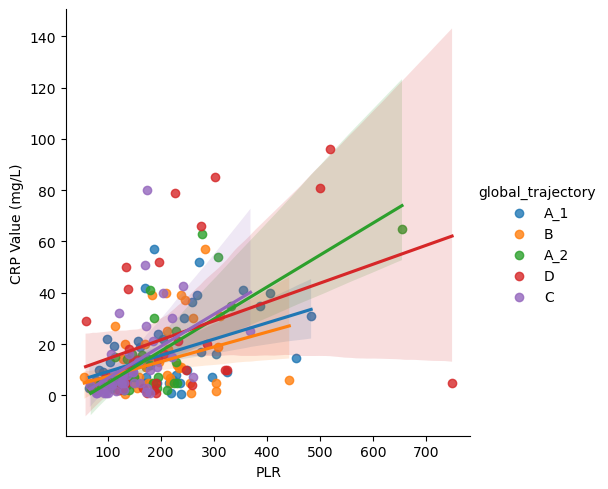

In [233]:
x,y= "PLR","CRP Value (mg/L)"
sns.lmplot(x=x, y=y, data= data_use.query("months == 0 "), hue="global_trajectory")
from scipy import stats
pearson_data = data_use.query("months == 0 ")[[x, y, "global_trajectory"]].dropna(axis=0)

print(stats.pearsonr(pearson_data[x], pearson_data[y]))
groups = pearson_data.groupby('global_trajectory')
for name, group in groups:
    print(name,":",stats.pearsonr(group[x], group[y]))

PearsonRResult(statistic=0.31825730047245404, pvalue=1.8996921723538704e-06)
A_1 : PearsonRResult(statistic=0.4095099038299872, pvalue=0.0031456496132484545)
A_2 : PearsonRResult(statistic=0.6322428909456117, pvalue=0.00017815473401028124)
B : PearsonRResult(statistic=0.24635827804919433, pvalue=0.06981108256720375)
C : PearsonRResult(statistic=0.16789187352957566, pvalue=0.27028445138562524)
D : PearsonRResult(statistic=0.24652309223804952, pvalue=0.15339969892474584)


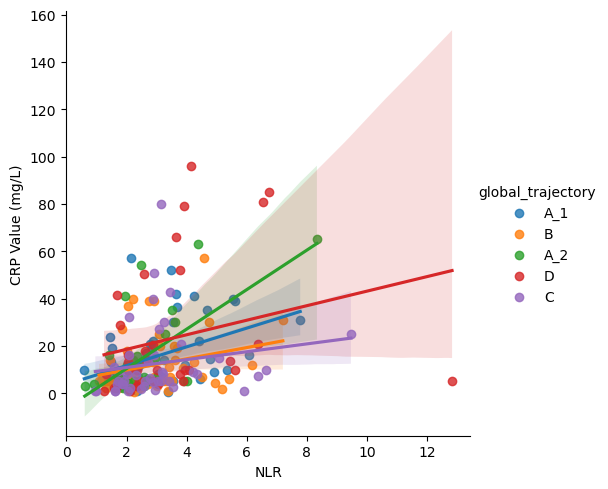

In [234]:
x,y= "NLR","CRP Value (mg/L)"
sns.lmplot(x=x, y=y, data= data_use.query("months == 0 "), hue="global_trajectory")
from scipy import stats
pearson_data = data_use.query("months == 0 ")[[x, y, "global_trajectory"]].dropna(axis=0)

print(stats.pearsonr(pearson_data[x], pearson_data[y]))
groups = pearson_data.groupby('global_trajectory')
for name, group in groups:
    print(name,":",stats.pearsonr(group[x], group[y]))


PearsonRResult(statistic=0.18591939482445763, pvalue=0.006134098143097791)
A_1 : PearsonRResult(statistic=0.09268455329065098, pvalue=0.5220538750487261)
A_2 : PearsonRResult(statistic=0.5564843338332152, pvalue=0.0014054080534909993)
B : PearsonRResult(statistic=0.16281489867932072, pvalue=0.23496028641182415)
C : PearsonRResult(statistic=-0.09804871497954841, pvalue=0.5168152162194563)
D : PearsonRResult(statistic=0.23776178834846037, pvalue=0.16902316361869194)


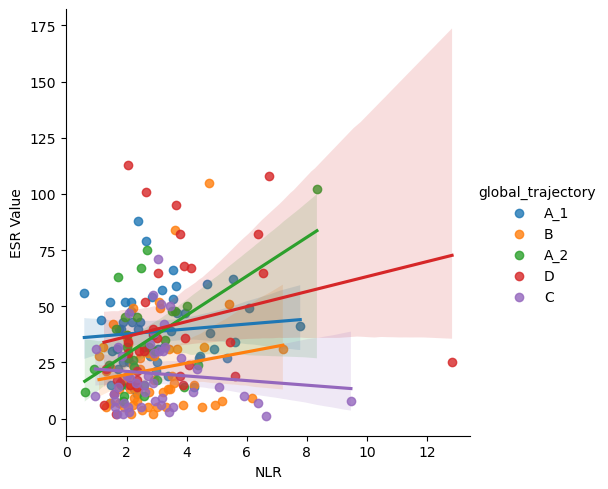

In [235]:
x,y= "NLR","ESR Value"
sns.lmplot(x=x, y=y, data= data_use.query("months == 0 "), hue="global_trajectory")
from scipy import stats
pearson_data = data_use.query("months == 0 ")[[x, y, "global_trajectory"]].dropna(axis=0)

print(stats.pearsonr(pearson_data[x], pearson_data[y]))
groups = pearson_data.groupby('global_trajectory')
for name, group in groups:
    print(name,":",stats.pearsonr(group[x], group[y]))


In [236]:
data_use.query("months == 0 ")

,PATNR,months,Study,Age,Race,Sex,Weight,Date of Assessment,Date of symptom onset,Final Score,...,days,global_trajectory,symptom_date,test_date,time till assessment,remision,last_visit,baseline,NLR,PLR
0,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,0,TACERA,79,White- British,Female,50.80,6/25/2015,2/1/2015,9.0,...,0,A_1,2015-02-01,2015-06-25,-144,False,6,0,4.666667,387.777778
7,0110A6D8FE1F42B8F690C418F4A76379A3D95E0B68E625...,0,TACERA,42,White- British,Female,73.40,8/9/2013,3/2/2013,0.0,...,0,B,2013-03-02,2013-08-09,-160,False,18,0,6.166667,230.833333
14,016BBC0766785143D12B9EEE5B3B9DDA4C0C850D720120...,0,TACERA,60,White- British,Female,71.80,5/9/2014,12/1/2013,NaN,...,0,A_1,2013-12-01,2014-05-09,-159,False,12,0,1.760479,168.862275
21,026A123E54047C669FA3C239D3D89ECC817437B0FE8CA1...,0,TACERA,57,Black or Black British - Caribbean,Female,68.00,9/29/2014,5/1/2014,1.0,...,0,A_2,2014-05-01,2014-09-29,-151,False,12,0,1.720000,117.200000
28,036A2E585D2906AA2EE0114C9F34B066DCF0C9107F4AF0...,0,TACERA,59,White- British,Female,92.00,7/8/2015,3/1/2015,13.0,...,0,A_2,2015-03-01,2015-07-08,-129,False,6,0,1.819923,110.344828
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1477,FA8F7566A07AECD6E12FFC518489802DEA9C44ECB18FD7...,0,TACERA,36,Asian or Asian British - Any other Asian backg...,Male,95.00,3/28/2014,7/28/2013,2.0,...,0,C,2013-07-28,2014-03-28,-243,False,18,0,3.285714,240.714286
1484,FCF14F3AAA87DE5EF1B23F0C26DC69BFEADC5A135BD06D...,0,TACERA,69,White- British,Female,62.60,5/11/2015,2/8/2015,4.0,...,0,C,2015-02-08,2015-05-11,-92,False,6,0,3.235294,221.176471
1491,FF18BE7F07D2B832CC6434ECF110D30F786D776F0A9E1F...,0,TACERA,67,White - Irish,Female,47.90,2014-01-01,2/1/2014,19.0,...,0,D,2014-02-01,2014-01-01,31,False,12,0,3.005464,248.087432
1498,FF316CBA26DD9BC1E0575F0930ECE7A0F15F9D2B3FED6C...,0,TACERA,69,White- British,Male,94.45,2/2/2015,10/5/2014,19.0,...,0,A_2,2014-10-05,2015-02-02,-120,False,6,0,2.593939,229.090909


In [237]:
data_use

,PATNR,months,Study,Age,Race,Sex,Weight,Date of Assessment,Date of symptom onset,Final Score,...,days,global_trajectory,symptom_date,test_date,time till assessment,remision,last_visit,baseline,NLR,PLR
0,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,0,TACERA,79,White- British,Female,50.8,6/25/2015,2/1/2015,9.0,...,0,A_1,2015-02-01,2015-06-25,-144,False,6,0,4.666667,387.777778
1,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,3,TACERA,79,White- British,Female,50.8,6/25/2015,2/1/2015,9.0,...,90,A_1,2015-02-01,2015-06-25,-144,True,6,0,NaN,NaN
2,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,6,TACERA,79,White- British,Female,50.8,6/25/2015,2/1/2015,9.0,...,180,A_1,2015-02-01,2015-06-25,-144,True,6,0,6.375000,390.000000
3,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,9,TACERA,79,White- British,Female,50.8,6/25/2015,2/1/2015,9.0,...,270,A_1,2015-02-01,2015-06-25,-144,False,6,0,NaN,NaN
4,0073B9C958B3CA3EED99BB233FD6AA03D42883B16AED8D...,12,TACERA,79,White- British,Female,50.8,6/25/2015,2/1/2015,9.0,...,360,A_1,2015-02-01,2015-06-25,-144,False,6,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1507,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,6,TACERA,52,Asian or Asian British - Any other Asian backg...,Female,80.0,2/5/2014,7/8/2013,1.0,...,180,D,2013-07-08,2014-02-05,-212,False,18,0,2.000000,145.000000
1508,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,9,TACERA,52,Asian or Asian British - Any other Asian backg...,Female,80.0,2/5/2014,7/8/2013,1.0,...,270,D,2013-07-08,2014-02-05,-212,False,18,0,NaN,NaN
1509,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,12,TACERA,52,Asian or Asian British - Any other Asian backg...,Female,80.0,2/5/2014,7/8/2013,1.0,...,360,D,2013-07-08,2014-02-05,-212,False,18,0,1.055556,140.555556
1510,FF9C17EC739F92CED4EDC266471525E0F50F8A81C9129B...,15,TACERA,52,Asian or Asian British - Any other Asian backg...,Female,80.0,2/5/2014,7/8/2013,1.0,...,450,D,2013-07-08,2014-02-05,-212,False,18,0,NaN,NaN


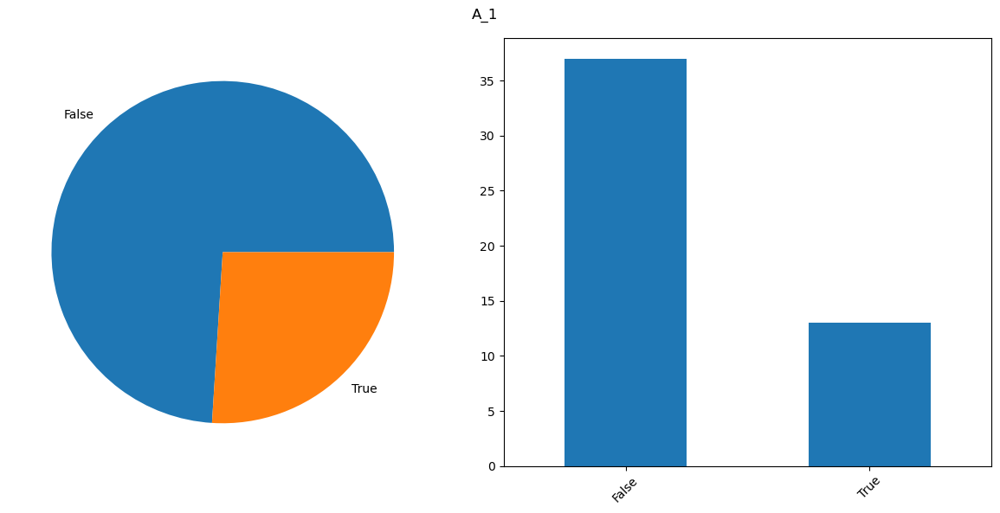

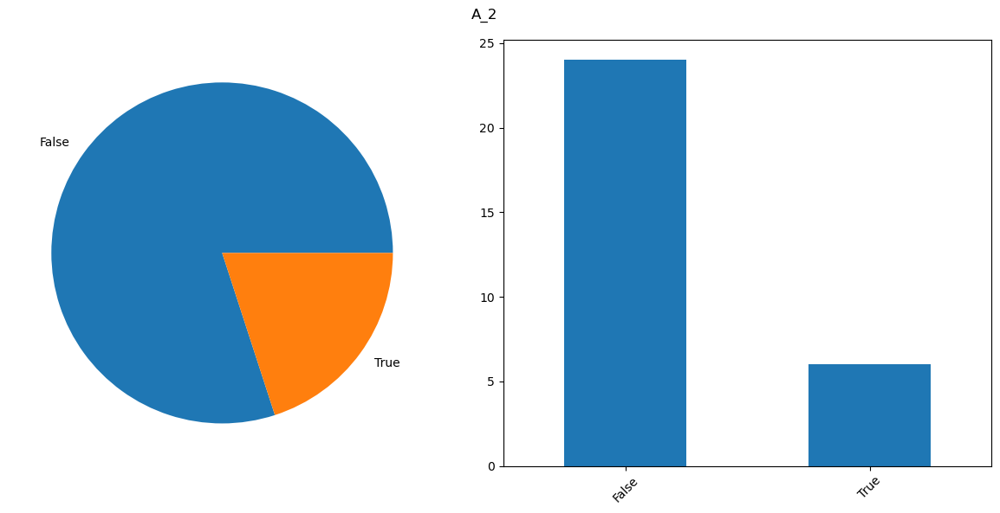

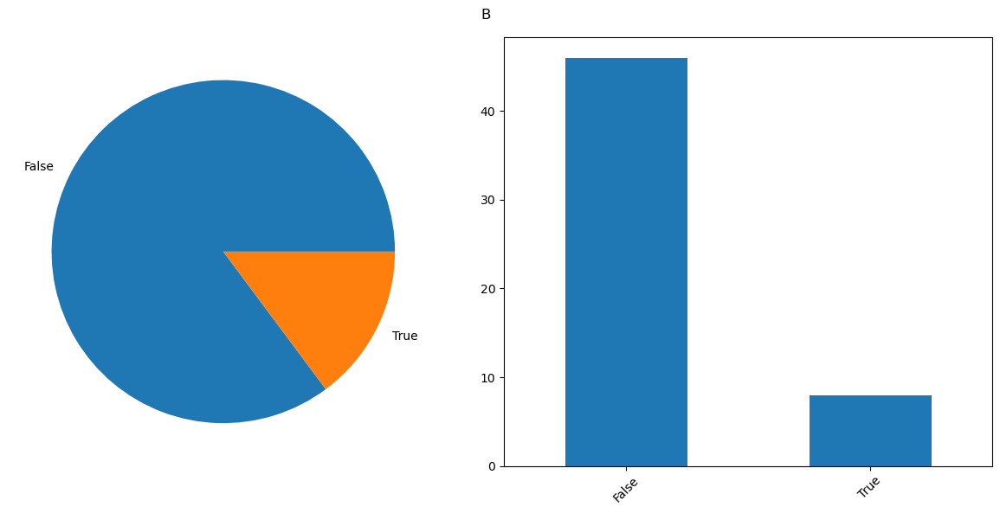

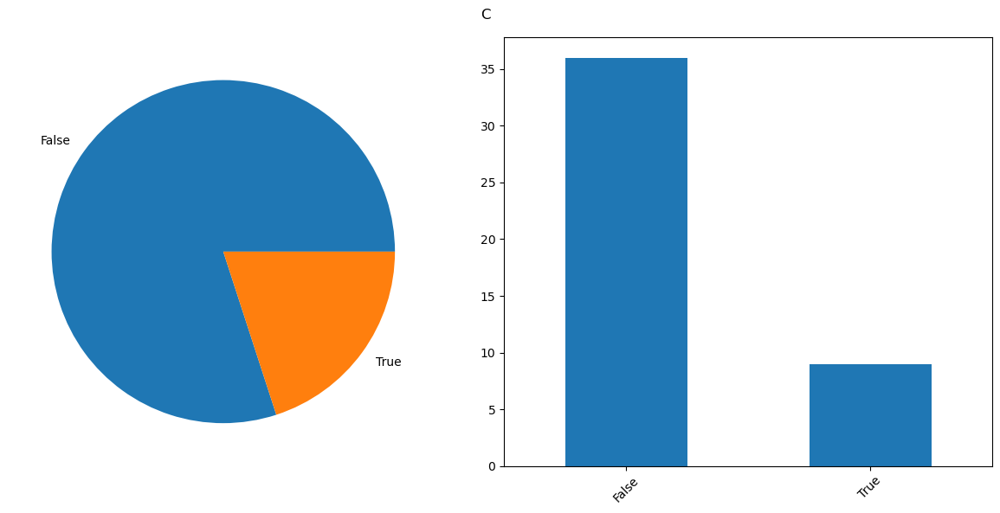

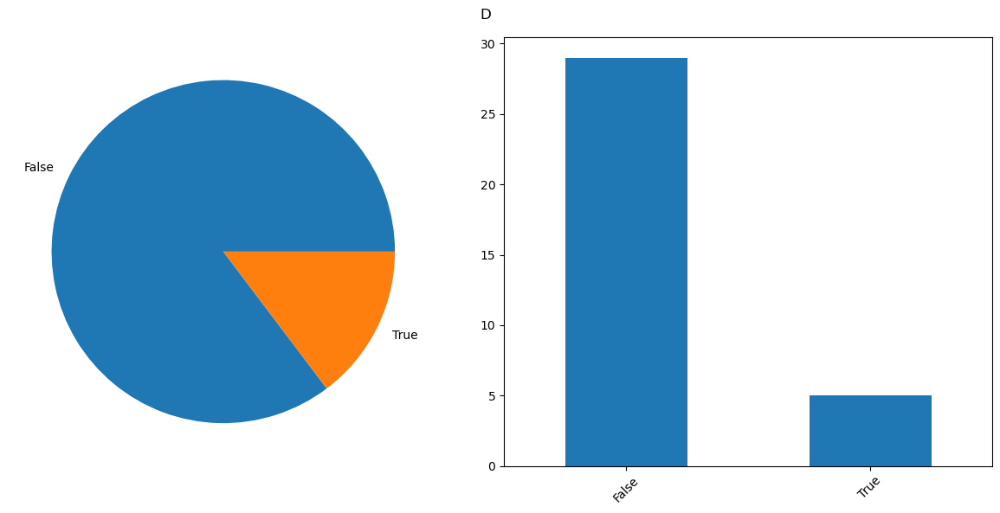

In [238]:
a = add_data.groupby("global_trajectory")["Erosive"].value_counts()#.plot.pie(subplots=True,)
for cat1, subdf in a.groupby(level='global_trajectory'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    subdf.loc[cat1, :].plot.pie(y='count', ax=ax1, ylabel='', legend=False)
    subdf.loc[cat1, :].plot.bar(y='%', ax=ax2, rot=45, xlabel='', legend=False)
    fig.suptitle(cat1)
    fig.tight_layout()
    plt.show()

In [239]:
add_data.groupby("global_trajectory")["Annualised Progression"].describe()

,count,mean,std,min,25%,50%,75%,max
global_trajectory,,,,,,,,
A_1,41.0,1.682927,3.843430,-1.0,0.0,1.0,2.0,22.0
A_2,29.0,0.448276,1.428941,-3.0,0.0,0.0,1.0,6.0
B,53.0,0.509434,1.395358,-3.0,0.0,0.0,1.0,6.0
C,44.0,0.772727,2.133494,-3.0,0.0,0.0,1.0,10.0
D,31.0,0.741935,1.896800,-2.0,0.0,0.0,1.0,9.0


In [240]:
add_data.groupby("global_trajectory")["Initial Score"].describe()

,count,mean,std,min,25%,50%,75%,max
global_trajectory,,,,,,,,
A_1,50.0,9.640000,9.057098,0.0,3.0,7.0,14.75,33.0
A_2,30.0,6.966667,10.896008,0.0,0.0,2.0,11.50,53.0
B,54.0,5.407407,7.810294,0.0,0.0,2.0,8.75,35.0
C,45.0,5.444444,6.693129,0.0,1.0,2.0,9.00,31.0
D,34.0,5.000000,7.893227,0.0,1.0,2.0,5.75,39.0


In [241]:
add_data.groupby("global_trajectory")["Final Score"].describe()

,count,mean,std,min,25%,50%,75%,max
global_trajectory,,,,,,,,
A_1,41.0,10.439024,8.955581,0.0,3.00,9.0,15.0,33.0
A_2,29.0,7.551724,11.849009,0.0,0.00,3.0,13.0,58.0
B,53.0,5.924528,8.368552,0.0,1.00,2.0,10.0,41.0
C,44.0,6.136364,7.617577,0.0,1.75,3.0,10.0,34.0
D,31.0,5.903226,8.490602,0.0,1.00,2.0,7.0,39.0


In [243]:
add_data.groupby("global_trajectory")["Unadjusted Progression"].head(2)

0     NaN
1     0.0
2     1.0
3     0.0
7     3.0
11    3.0
12    NaN
16    0.0
17    0.0
18    1.0
Name: Unadjusted Progression, dtype: float64

In [ ]:
add_data.columns

In [ ]:
plot_clusters(add_data, 'Annualised Progression', "global_trajectory == @i ", target = "global_trajectory", mapper = traject_unmapper)
plt.title("global_trajectory used") 

In [ ]:



clin_fig = pd.read_excel(raw_data_dir+ "TACERA_raw/RA_MAP_Clinical_Figshare_17_5_21.xlsx")[["Digest","Symp_Duration"]]
clin_fig.Symp_Duration = pd.to_numeric(clin_fig.Symp_Duration, errors= "coerce")

In [ ]:
clin_fig
data_use.groupby("PATNR").head(1).merge(clin_fig, left_on="PATNR" ,right_on="Digest").Symp_Duration.describe()

In [ ]:
data_use.groupby("PATNR").head(1).merge(clin_fig, left_on="PATNR" ,right_on="Digest").groupby("global_trajectory").Symp_Duration.describe()